In [1]:
# mainSim code
# author: Xingyu Ding

import numpy as np
import scipy as sp
import matplotlib as mpl
import matplotlib.pyplot as plt
import pandas as pd
import brian2
import json
import pickle
import copy
# import plotly.express as px

In [2]:
# load helper functions
from helper import generate_pref, plot_pref
# import modelHelper
from helper import load_hierarchy, plot_connectivity, generate_connectivity, generate_random_connectivity

# load model class
from circuitModel import model

In [3]:
# load arealist
area_list = list(np.loadtxt('results/area_list.csv', delimiter=',', dtype='str'))
thal_list = list(np.loadtxt('results/thal_list.csv', delimiter=',', dtype='str'))
# load connectivity 
conn_cxcx = np.loadtxt('results/conn_cxcx.csv', delimiter=',')
conn_cxth = np.loadtxt('results/conn_cxth.csv', delimiter=',')
conn_thcx = np.loadtxt('results/conn_thcx.csv', delimiter=',')

conn_cxcx_raw = np.loadtxt('results/conn_cxcx_raw.csv', delimiter=',')
# load cell density
density_df = pd.read_csv("results/dfDensity.csv", header = 0, index_col=0)
# load volume
volume_df = pd.read_csv('results/dfVolume.csv', header = 0, index_col=0)

# load interneuron density
normPVgrad_df = pd.read_csv('results/dfPV.csv', header = 0, index_col=0)
normSSTgrad_df = pd.read_csv('results/dfSST.csv', header = 0, index_col=0)
PVgrad_df = pd.read_csv('results/dfPVraw.csv', header = 0, index_col= 0)
SSTgrad_df = pd.read_csv('results/dfSSTraw.csv', header = 0, index_col= 0)

# load hierarchy
hierarchy_df = pd.read_csv('results/dfHier.csv', header=0, index_col=0)
hierarchy = np.array(hierarchy_df['hierarchy index'])

In [4]:
# define divisions from Harris et al.
div = {'somatomotor':['SSp-bfd','SSp-tr','SSp-ll','SSp-ul',
                     'SSp-un','SSp-n','SSp-m','SSs','MOp','MOs'],
      'visual':['VISal','VISl','VISp','VISpl',
                'VISli','VISpor','VISrl'],
      'medial':['VISa','VISam','VISpm','RSPagl',
               'RSPd','RSPv'],
      'prefrontal':['FRP','ACAd','ACAv','PL',
                   'ILA','ORBl','ORBm','ORBvl'],
      'lateral':['AId','AIv','AIp','VISC',
                 'GU','TEa','PERI','ECT'],
      'auditory':['AUDd','AUDp','AUDpo','AUDv']}

div_color_list = np.array([[255, 140, 0],
                           [169, 164, 217],
                           [22, 37, 128],
                           [220,20,60],
                           [218,165,32],
                           [91,  0,  105]])/255
div_name_list = ['somatomotor',
                 'visual',
                 'medial',
                 'prefrontal',
                 'lateral',
                 'auditory']

In [5]:
# define parameters
parameters = {}
p = parameters
parameters['alpha_pref'] = 0
parameters['beta_pref'] = 2.42
parameters.update(
    { # Time constants
    'tau_NMDA': 0.06   * brian2.second,    # s 
    'tau_GABA': 0.005  * brian2.second,    # s 
    'tau_AMPA': 0.002  * brian2.second,    # s
    'tau_rates': 0.002 * brian2.second,    # same as tau_AMPA
    'tau_noise': 0.002 * brian2.second,    # same as tau_AMPA
    # f-I curve parameters - E populations
    'a_E': 140  * brian2.Hz/brian2.nA,  # Hz/nA
    'b_E': 54  * brian2.Hz,            # Hz
    'd_E': 0.308  * brian2.second,        # s
    'gamma_NMDA': 1.282,                         # unitless

    'gamma_AMPA':  2,            
    # f-I curve parameters - I populations
    'g_2': 4,                    # unitless
    'c_I': 615  * brian2.Hz/brian2.nA,                 # Hz/nA
    'c_0': 177  * brian2.Hz,                           # Hz
    'gamma_GABA': 2,                       # unitless
    # Local connectivity matrix strengths
    # Strength of connections from E cells
    'g_E_self': 0.4 * brian2.nA , # nA
    'g_E_cross': 0.0107* brian2.nA,         # nA
    # Local connectivity E to I
    'g_I_E': 0.2656 * brian2.nA,
    # Strength of connections from I cells
    'g_E_I':  0.192    * brian2.nA,         # nA
    # larger g_E_I allows the Activity propagation to be stable, Balance amplification.
    'g_Iself': 0.105   * brian2.nA,         # nA
    # John Murray's term
    'J_plus': 0.2112   * brian2.nA,         # nA 
    # Background inputs
    'I0_E': 0.305 * brian2.nA,         # nA
    'I0_I': 0.26       * brian2.nA,         # nA
    # Noise std dev
    'std_noise': 0.005 * brian2.nA,         # nA      
    # initial values
    'r0_E': 5 * brian2.Hz,
    'r0_I': 5.5 * brian2.Hz
        })      
parameters.update({ # Long-range strength
    'mu_EE': 0.1 * brian2.nA, # unitless 
    'ratio_mu_IE_mu_EE': 1.67
        })
parameters.update({'mu_IE': parameters['mu_EE']*parameters['ratio_mu_IE_mu_EE']})

######## HIERARCHY ########
parameters.update({
    'JEE_scaling_factor' : 0,  
   'JEI_scaling_factor' : 0.83,  
  'JII_scaling_factor' : 0.714, 
    'JIE_scaling_factor': 0,

  'J_NS_grad_min' : 1, 
   'J_G_EI_min' : 1, 
    'J_G_II_min' : 1, 
    """"""
    'J_N_IE_min' : 1,
    """"""    """"""
   'kSquishFln' : 0.3, 
    'LR_E_self' : 1,
    'LR_E_cross' : 0,  
    'LR_I_E' : 1,
    # Choose stimulus and distractor strength
    'stim_strength' : 0.5 * brian2.nA, 
    'inh_strength' : -0.4*brian2.nA,
    'BLA_stim_strength' : 0.2*brian2.nA, 
    'thalamic_base_strength' : 0.05* brian2.nA,  
    'distractor_strength' : 0 * brian2.nA, 
    'inhibition_strength' : -0.3* brian2.nA
    }) 

# Th CX model
parameters.update({
    'stim_strength_th':0.1*brian2.nA,    # nA
  'I0_th_E': 0.405 * brian2.nA,         # nA
   'g_th_cx_E': 0.01    * brian2.nA,         # nA 
   'g_th_cx_I': 0 * brian2.nA,          #nA 
   'g_cx_th':  0.12     * brian2.nA,
   'p_D': 0.45,        # parameters for STD
   'tau_D': 600*brian2.ms        # parameters for STD
  })

parameters['dt']=0.5 * brian2.ms  # timestep  
parameters['trial_length']=6000 * brian2.ms # trial length (s)
parameters['inh_multiarea'] = []
parameters['PAthreshold'] = 5 #Hz

parameters['stim_on'] = 2*brian2.second
parameters['stim_off'] = 2.5*brian2.second

parameters['inh_stim_on'] =  10*brian2.second
parameters['inh_stim_off'] =  13*brian2.second

parameters['div'] = div
parameters['div_color_list'] = div_color_list
parameters['div_name_list'] = div_name_list

0.9183397445384054


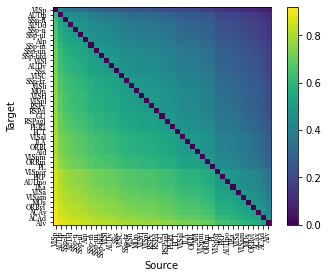

In [6]:
# generate longrange preferential targeting matrix via hierarchy
pref_matrix = generate_pref(hierarchy, parameters)
plot_pref(pref_matrix, area_list)
print(np.max(pref_matrix))

In [7]:
#####
parameters['WNormalizedbyRow'] = False
###########################

######
parameters['I0_E_mean'] = 0.305 * brian2.nA   #284 thala  #305 cortex
######
parameters['I0_E_min'] = parameters['I0_E_mean']
parameters['I0_E_max'] = parameters['I0_E_mean']

####################### 

parameters['g_th_cx_E_mean'] = 2.2* brian2.nA  
k_gth_E = 1.1 * brian2.nA  #0.8   
parameters['g_th_cx_E_min'] = parameters['g_th_cx_E_mean'] - k_gth_E*0.5
parameters['g_th_cx_E_max'] = parameters['g_th_cx_E_mean'] + k_gth_E*0.5

parameters['g_th_cx_E_mode'] = 'linear' 
parameters['g_th_cx_E_logistic_k'] = 20

parameters['g_th_cx_I_mean'] = 1.6 * brian2.nA # 0.8
k_gth_I = 1.1 * brian2.nA 
parameters['g_th_cx_I_min'] = parameters['g_th_cx_I_mean'] - k_gth_I*0.5
parameters['g_th_cx_I_max'] = parameters['g_th_cx_I_mean'] + k_gth_I*0.5
parameters['g_th_cx_I_mode'] = 'linear' 
parameters['g_th_cx_I_logistic_k'] = 20 

parameters['g_th_cx_E_midpoint'] = 0.7
parameters['g_th_cx_I_midpoint'] = parameters['g_th_cx_E_midpoint']



######

parameters['figurefolder'] = 'figure/'

In [8]:
# mainsim mm11
#####

# inhibitory parameters
# fix the gEImin to be 1, only change the scaling factor and g_E_I. 
# reference parameter: 0.18 (1+0.89*PV)    alternative: 0.075 (1+10*PV)


savefigflag = False
thcxmodel = False

parameters['thcxmodel'] = thcxmodel

# set random seed
np.random.seed(42)
model_V1 = model(parameters, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
if not thcxmodel:
    model_V1.add_input(parameters['stim_strength'],['VISp'], parameters['stim_on'], parameters['stim_off'], 'E1') 
    
if thcxmodel:
    model_V1.add_input_TH_new(parameters['stim_strength'], ['VISp'], parameters['stim_on'], parameters['stim_off'], 'E1', rampingperiod=0)
model_V1.run_sim(vocal_prompt = False)
[persistentactlist,baselineactlist,LRtoElist,LRtoIlist] = model_V1.save_delay_activity('tempdata/',False)
if model_V1.thcxmodel == True:
    th_persistentactlist = model_V1.save_th_delay_activity('tempdata/',False)


VISp
simulation start: 
sim done.


2.21E-17
3.96E-03


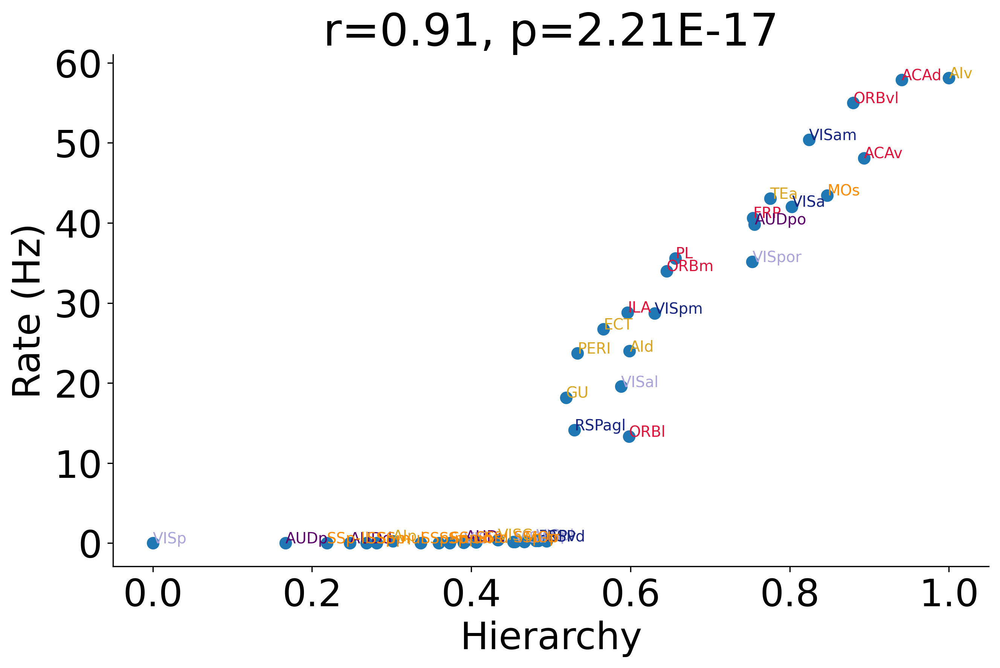

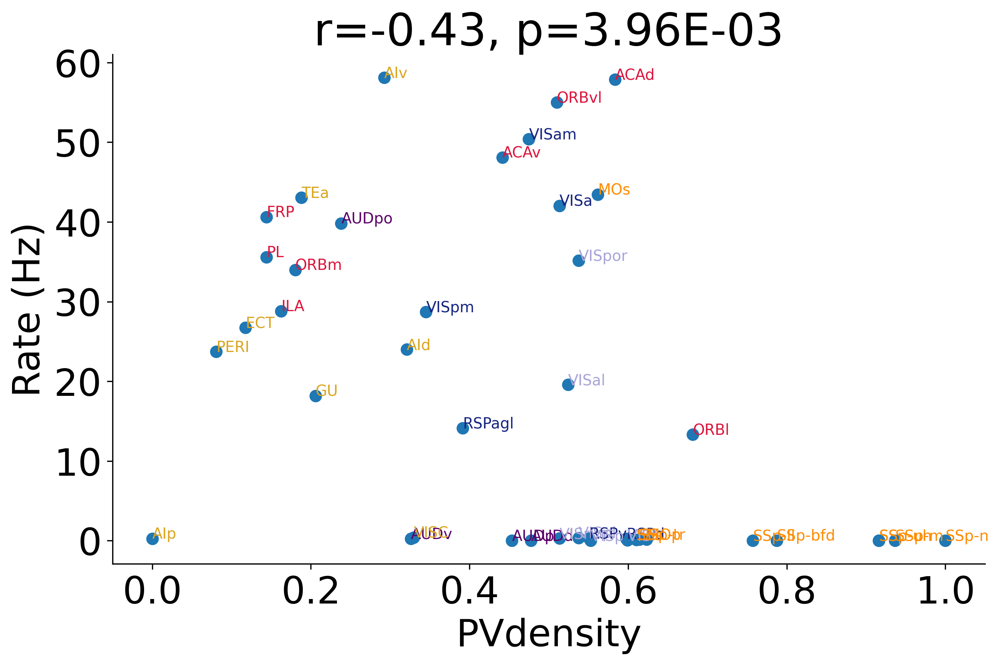

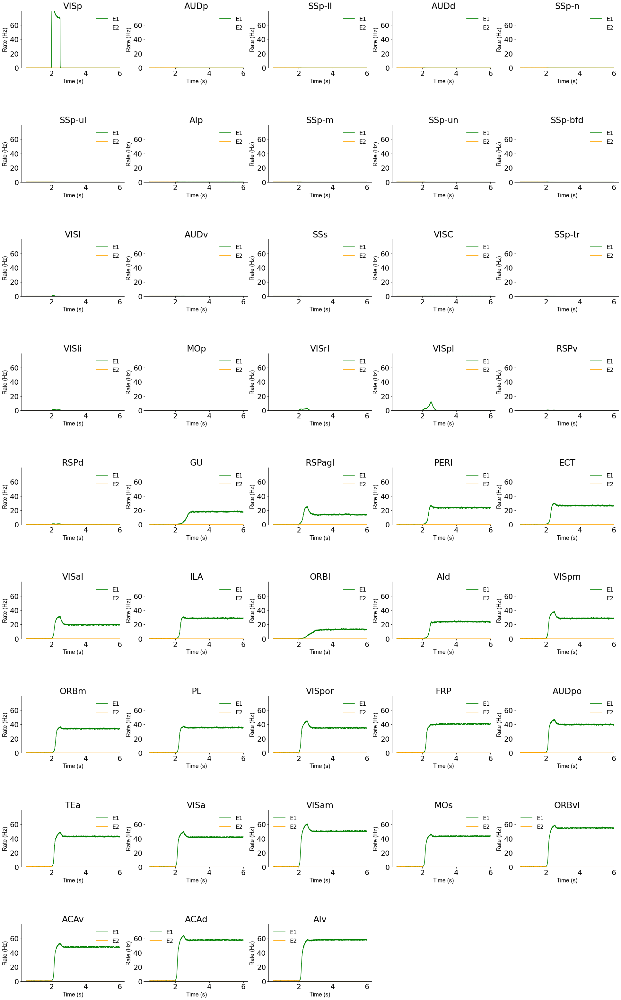

In [9]:
#mm22
PAthreshold = 5 #Hz
th_PAthreshold = 5 #Hz
persistentact_df =  model_V1.generatePAdf(PAthreshold)

if model_V1.thcxmodel == True:
    th_hierarchy = np.arange(0,1,1/40)
    th_persistentact_df = model_V1.generate_th_PAdf(th_PAthreshold, th_hierarchy)
model_V1.plotFRvsHier(False, True, 2, (10,6), 24, False, 'FRvsHier.pdf')
model_V1.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
model_V1.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')

if model_V1.thcxmodel == True:
    model_V1.plotFRthalarea(savefig = savefigflag, ylimit = 160, figfilename = 'FRallthalamus.pdf') 

In [10]:
# save date for stimulating V1, S1, and A1.
with open('results/model_V1.pkl', 'wb') as f:
    pickle.dump(model_V1, f)

# with open('results/model_S1.pkl', 'wb') as f:
#     pickle.dump(model_V1, f)

# with open('results/model_A1.pkl', 'wb') as f:
#     pickle.dump(model_V1, f)


In [11]:
# save parameters and more.  mainly for the use of multiSIM.
with open('results/allpars.pkl', 'wb') as f:
    pickle.dump([parameters, conn_cxcx, pref_matrix,
         hierarchy_df, normPVgrad_df, normSSTgrad_df,
         area_list, conn_thcx, conn_cxth, thal_list], f)

VISp
simulation start: 
sim done.
1.97E-04
3.14E-08


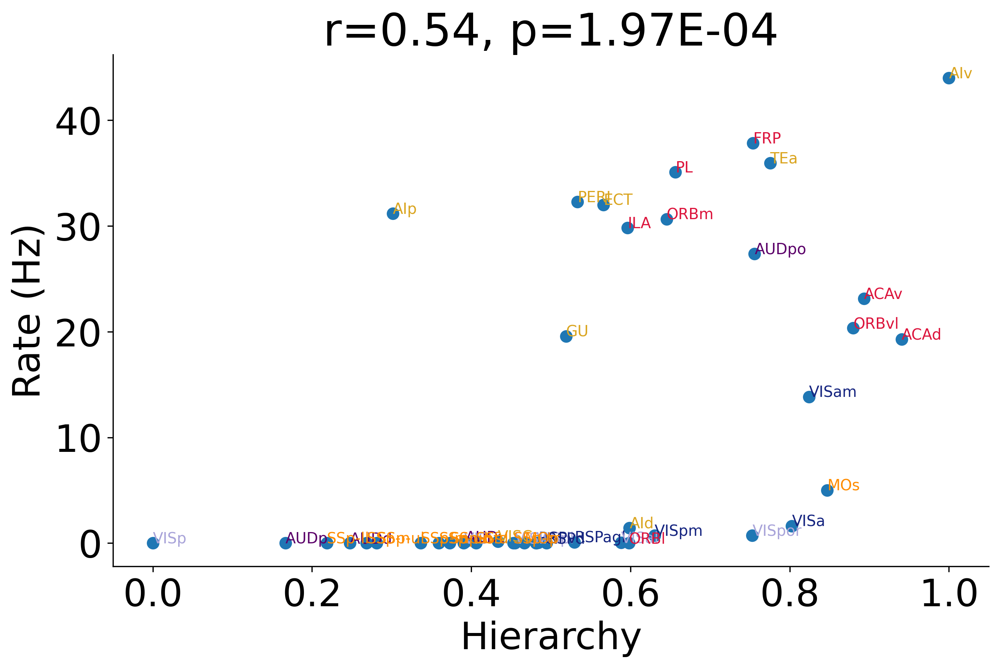

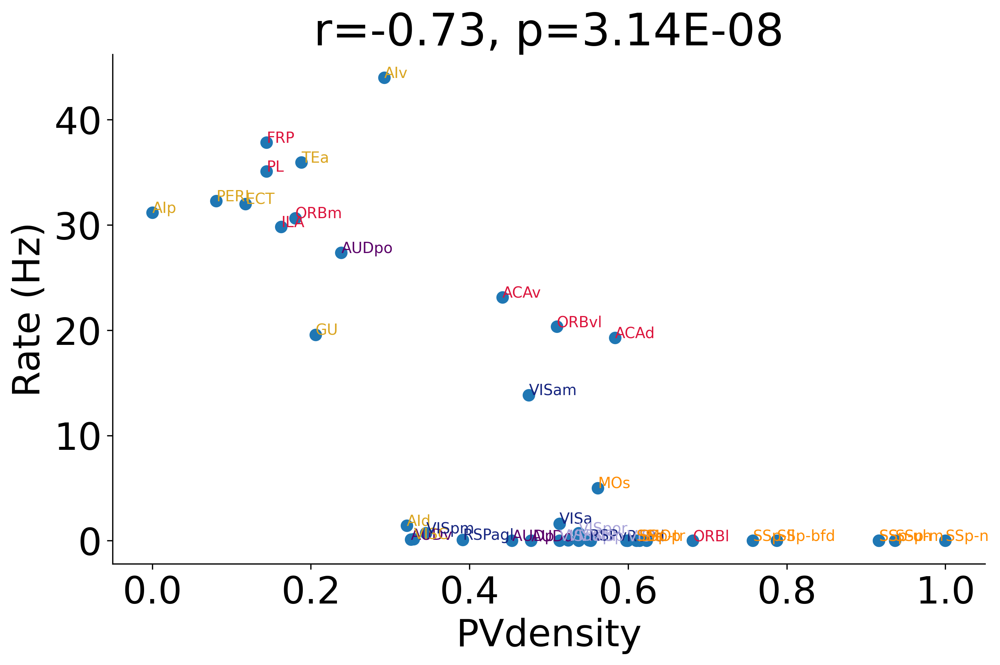

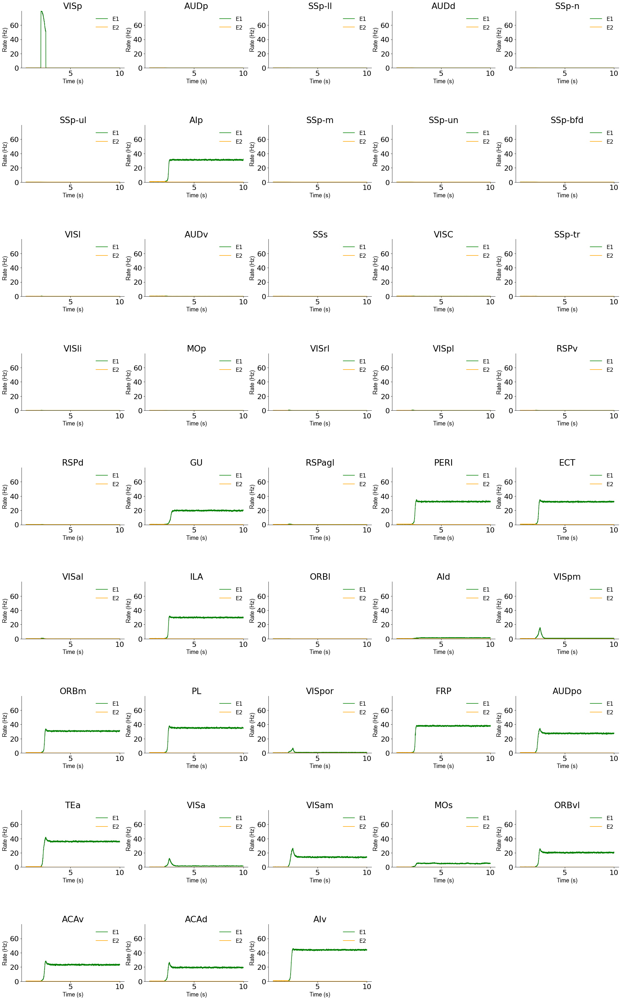

In [12]:
# simulation for alternative regime.
# set simulation time to be 10s
parameters['trial_length'] = 10000 * brian2.ms # trial length (s)

# alter parameters  
parametersAlter =  copy.deepcopy(parameters)
parametersAlter['JEI_scaling_factor'] = 10  # ref 0.83
parametersAlter['g_E_I'] = 0.075 * brian2.nA  # ref 0.192  * brian2.nA

# run simulation
modelAlternative = model(parametersAlter, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
modelAlternative.add_input(parameters['stim_strength'],['VISp'], parameters['stim_on'], parameters['stim_off'], 'E1')

modelAlternative.run_sim(vocal_prompt = False)
[avePrefPersist,_,_,_] = modelAlternative.save_delay_activity('tempdata/',False)

persistentact_df =  modelAlternative.generatePAdf(PAthreshold)
modelAlternative.plotFRvsHier(False, True, 2, (10,6), 24, False, 'FRvsHier.pdf')
modelAlternative.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
modelAlternative.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')

with open('results/model_V1_Alt.pkl', 'wb') as f:
    pickle.dump(modelAlternative, f)

norm PV gradient    0.472934
dtype: float64 norm PV gradient    0.472934
dtype: float64
VISp
simulation start: 
sim done.
5.67E-13


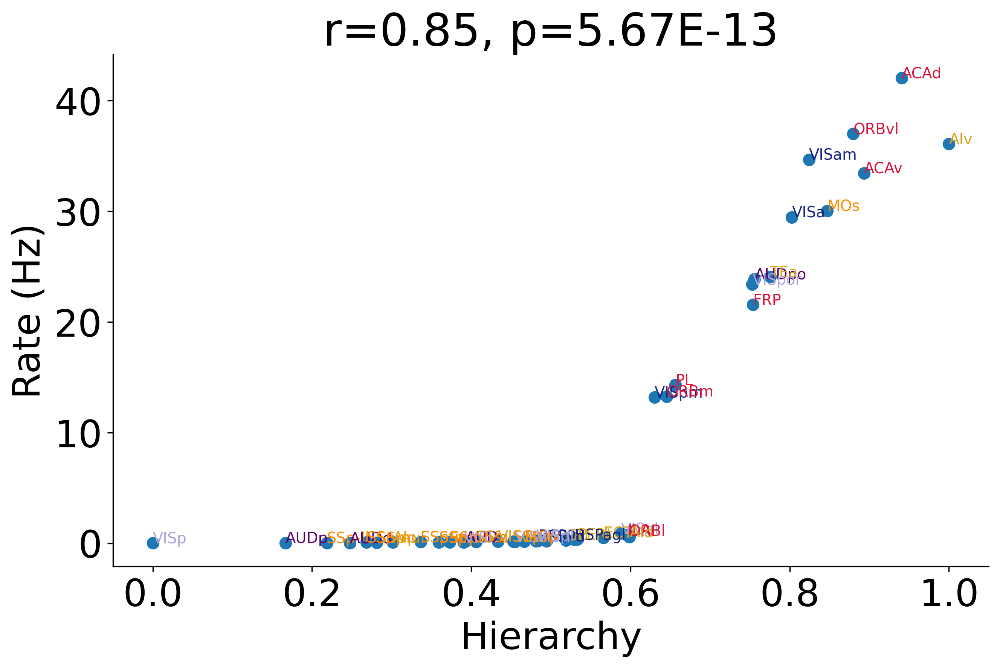

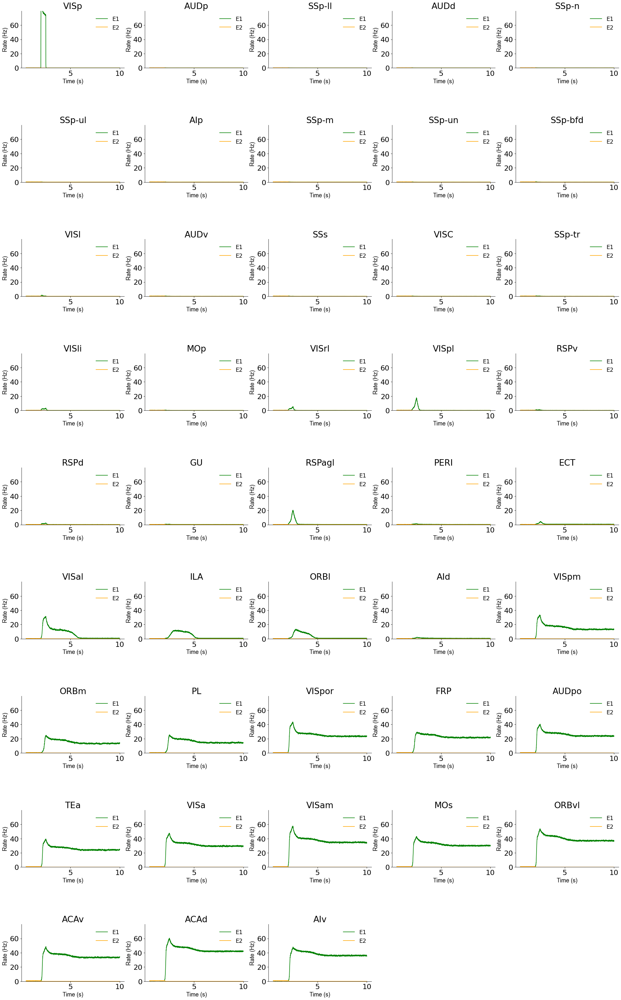

In [13]:
# A quick check of average pv density 
# set simulation time to be 10s
parameters['trial_length'] = 10000 * brian2.ms # trial length (s)

# normPVgrad_df varies from 0 to 1. 
# fill all values with the average. 
averagePVgrad_df = pd.DataFrame(index=normPVgrad_df.index, columns=normPVgrad_df.columns)
averagePVgrad_df.fillna(normPVgrad_df.mean(), inplace=True)
# averagePVgrad_df = 0.5 * (normPVgrad_df - normPVgrad_df.mean()) + normPVgrad_df.mean()
print(averagePVgrad_df.min(), averagePVgrad_df.max())

# # run simulation 
modelAveragePV = model(parameters, False, conn_cxcx, pref_matrix, hierarchy_df, averagePVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
if not thcxmodel:
    modelAveragePV.add_input(parameters['stim_strength'],['VISp'], parameters['stim_on'], parameters['stim_off'], 'E1') 

modelAveragePV.run_sim(vocal_prompt = False)
[persistentactlist,baselineactlist,LRtoElist,LRtoIlist] = modelAveragePV.save_delay_activity('tempdata/',False)

persistentact_df = modelAveragePV.generatePAdf(PAthreshold)
modelAveragePV.plotFRvsHier(False, True, 2, (10,6), 24, False, 'FRvsHier.pdf')
modelAveragePV.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')

with open('results/model_V1_PVconstant.pkl', 'wb') as f:
    pickle.dump(modelAveragePV, f)

In [14]:
# A quick check of different pv density

# normPVgrad_df varies from 0 to 1. 
maxRateDict = {}
numPADict = {}
parameters['trial_length'] = 10000 * brian2.ms # trial length (s) 
for pvValue in np.arange(0,1.1, 0.1):
    replacePVgrad_df = pd.DataFrame(index=normPVgrad_df.index, columns=normPVgrad_df.columns)
    replacePVgrad_df = replacePVgrad_df.fillna(pvValue)

    # # run simulation 
    modelReplacePV = model(parameters, False, conn_cxcx, pref_matrix, hierarchy_df, replacePVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
    if not thcxmodel:
        modelReplacePV.add_input(parameters['stim_strength'],['VISp'], parameters['stim_on'], parameters['stim_off'], 'E1') 

    modelReplacePV.run_sim(vocal_prompt = False)
    [persistentactlist,baselineactlist,LRtoElist,LRtoIlist] = modelReplacePV.save_delay_activity('tempdata/',False)

    persistentact_df =  modelReplacePV.generatePAdf(PAthreshold)

    maxRateDict[pvValue] = np.max(persistentactlist)
    # get the number of elements larger than 5 in persistentactlist
    numPADict[pvValue] = len([i for i in persistentactlist if i > 5])
    

VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.


In [15]:
PVrange = np.arange(0,1.1, 0.1)
maxRatelist = [maxRateDict[p] for p in PVrange]
numPAlist = [numPADict[p] for p in PVrange]

0.4729344001802648
[0.006131726854393347, 0.034738402075337814, 0.031933327244595765, 0.03201163304470418, 0.08952311118902567, 0.058246922873135466, 0.08175345580924898, 0.11225516909361172, 0.09267075457216238, 0.09713879980674392, 0.07386415121330343, 0.14415299437822732, 0.12565989466187857, 0.15171245235360406, 0.15334384751866914, 0.13766227751136415, 0.1532828491487497, 0.18125648241009715, 0.2380508284789129, 0.2233075336105735, 0.20059278217071438, 0.2738340357830756, 0.3190118371556247, 0.356506808806078, 0.5057527266035343, 0.8977277888750841, 0.7702395701448186, 0.7043570348571037, 0.5791179456643553, 13.195197484883213, 13.26572887425095, 14.319230789200573, 23.396969042394737, 21.5574012047004, 23.881953691434266, 24.09923070273237, 29.458883388015053, 34.673694566803654, 30.048544160672943, 37.030349800895856, 33.442263035132896, 42.059752673878734, 36.09622756758467]


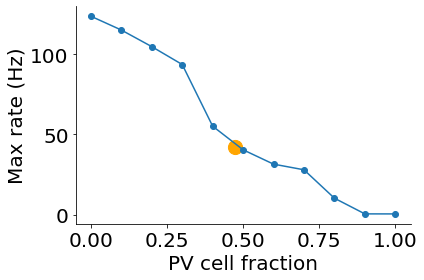

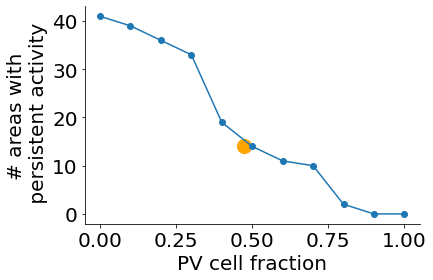

In [16]:
# figure 3 supplement 1

# plot the max rate vs. pv range
plt.figure(figsize=(6,4))
plt.plot(PVrange, maxRatelist, 'o-')
plt.xlabel('PV cell fraction')
plt.ylabel('Max rate (Hz)')

ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# add average PV density.
avePV = normPVgrad_df.mean()[0]
print(avePV)
[avePersist,_,_,_] = modelAveragePV.save_delay_activity('tempdata/',False)
print(avePersist)
plt.scatter(avePV, np.max(avePersist), color='orange', marker='o', s=200)

# plot the number of PA > 5 vs. pv range
plt.figure(figsize=(6,4))
plt.plot(PVrange, numPAlist, 'o-')
plt.xlabel('PV cell fraction')
plt.ylabel('# areas with\n persistent activity')

# add average PV density.
plt.scatter(avePV, len([i for i in avePersist if i > 5]), color='orange', marker='o', s=200)

ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# plt.axvline(x=0.1525, color='k', linestyle='--', linewidth=2)


VISp
simulation start: 
sim done.
8.73E-23


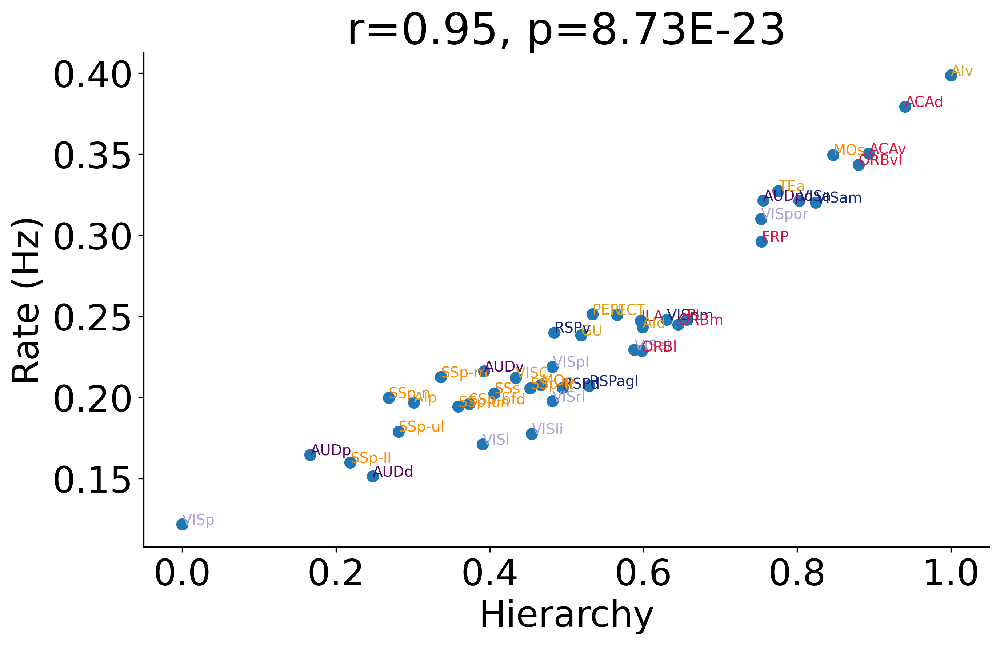

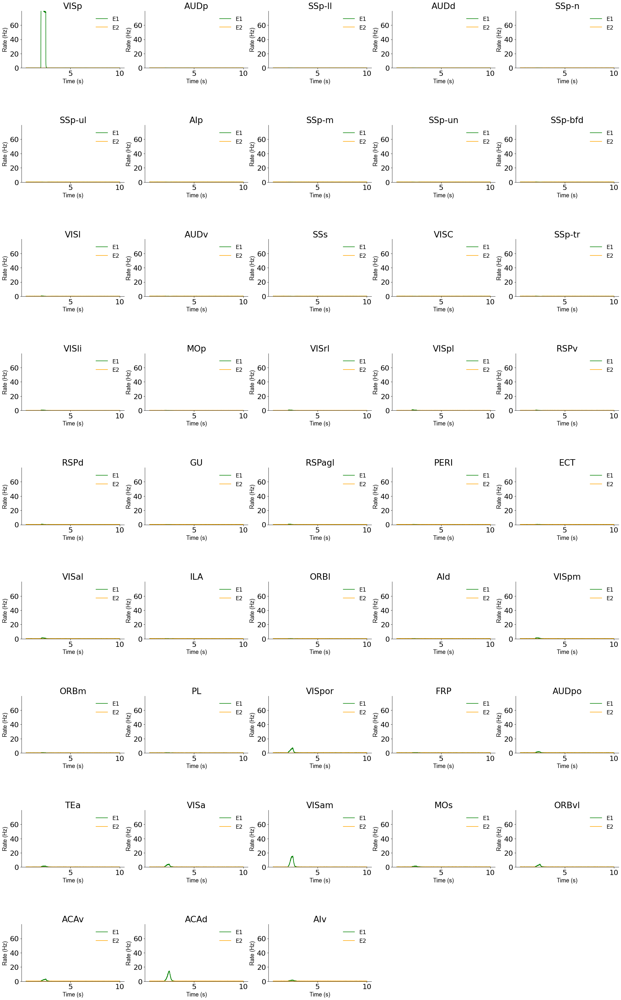

In [17]:
# A quick check of average pv density  for alternative regime
# set simulation time to be 10s
parameters['trial_length'] = 10000 * brian2.ms # trial length (s)

parametersAlter =  copy.deepcopy(parameters)
parametersAlter['JEI_scaling_factor'] = 10  # ref 0.83   
parametersAlter['g_E_I'] = 0.075 * brian2.nA  # ref 0.192  * brian2.nA 

# # run simulation 
modelAlternativeAveragePV = model(parametersAlter, False, conn_cxcx, pref_matrix, hierarchy_df, averagePVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
if not thcxmodel:
    modelAlternativeAveragePV.add_input(parameters['stim_strength'],['VISp'], parameters['stim_on'], parameters['stim_off'], 'E1') 

modelAlternativeAveragePV.run_sim(vocal_prompt = False)
[persistentactlist,baselineactlist,LRtoElist,LRtoIlist] = modelAlternativeAveragePV.save_delay_activity('tempdata/',False)

persistentact_df = modelAlternativeAveragePV.generatePAdf(PAthreshold)
modelAlternativeAveragePV.plotFRvsHier(False, True, 2, (10,6), 24, False, 'FRvsHier.pdf')
modelAlternativeAveragePV.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')

with open('results/model_V1_Alt_PVconstant.pkl', 'wb') as f:
    pickle.dump(modelAlternativeAveragePV, f)

VISp
simulation start: 
sim done.
4.10E-04
1.63E-08


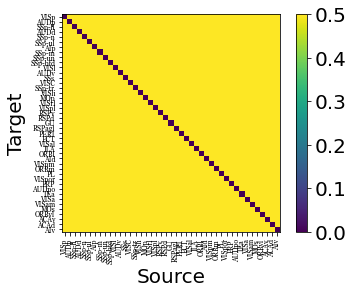

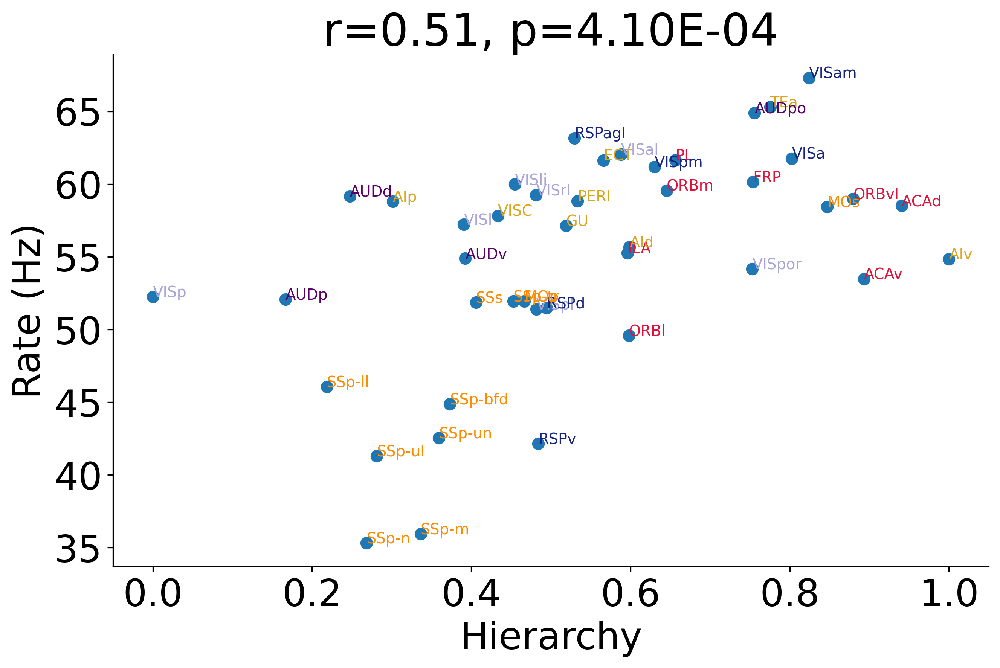

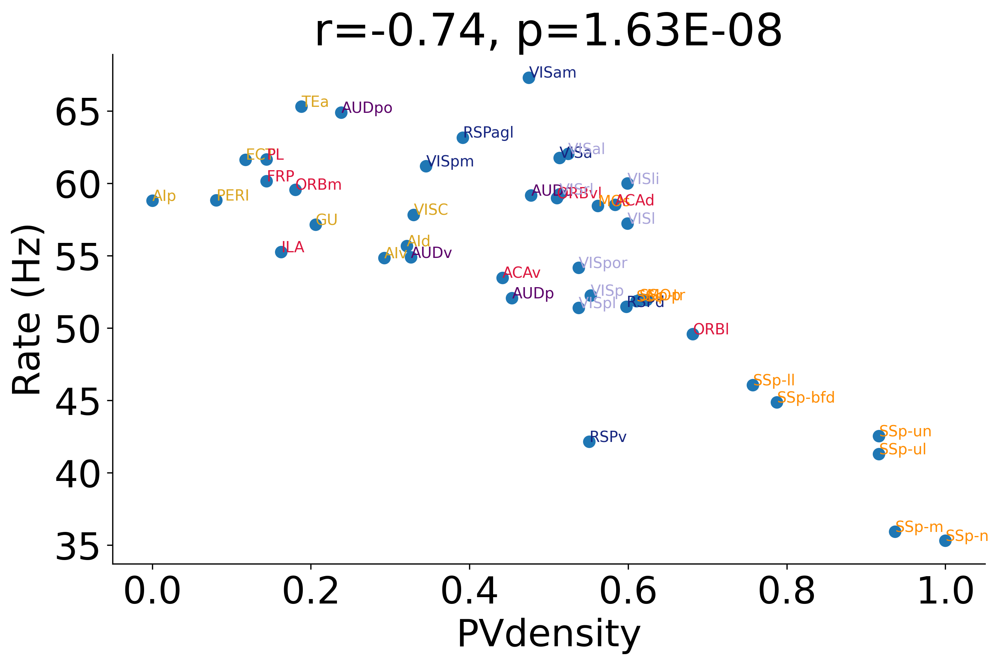

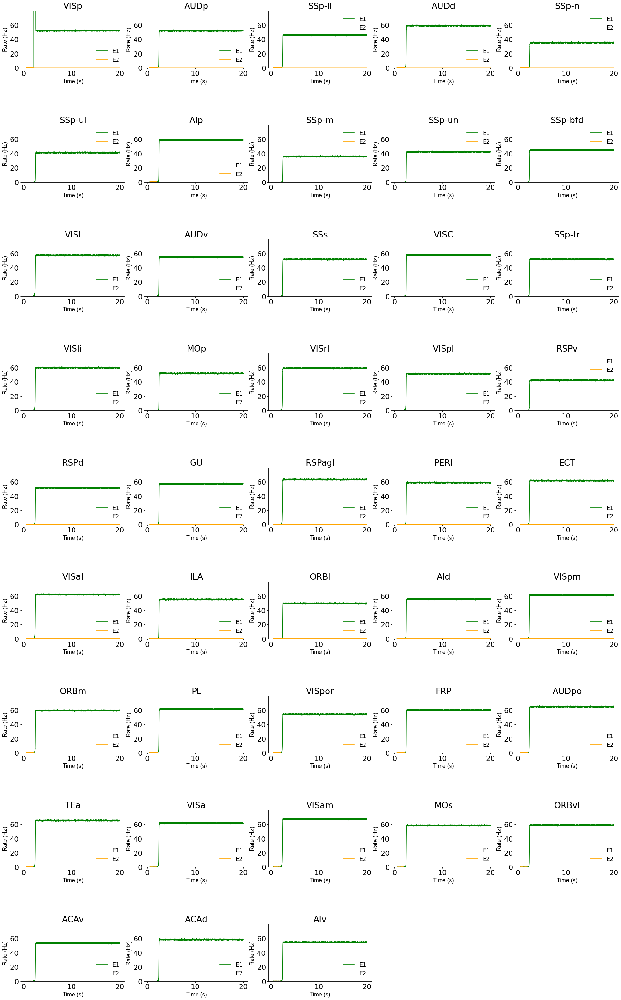

In [18]:
# A quick check of 0.5 hierarchy.

# fill long range pref with same value 0.5. 
prefAve = np.ones(pref_matrix.shape) * 0.5
np.fill_diagonal(prefAve, 0)
plot_pref(prefAve, area_list)

parameters['trial_length'] = 20000 * brian2.ms # trial length (s)
# run simulation with average pref
modelAveragePref = model(parameters, False, conn_cxcx, prefAve, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
if not thcxmodel:
    modelAveragePref.add_input(parameters['stim_strength'],['VISp'], parameters['stim_on'], parameters['stim_off'], 'E1')

modelAveragePref.run_sim(vocal_prompt = False)
[avePrefPersist,_,_,_] = modelAveragePref.save_delay_activity('tempdata/',False)

persistentact_df =  modelAveragePref.generatePAdf(PAthreshold)
modelAveragePref.plotFRvsHier(False, True, 2, (10,6), 24, False, 'FRvsHier.pdf')
modelAveragePref.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
modelAveragePref.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')

with open('results/model_V1_noCIB.pkl', 'wb') as f:
    pickle.dump(modelAveragePref, f)

0.45
VISp
simulation start: 
sim done.
8.15E-22
0.46
VISp
simulation start: 
sim done.
2.75E-23
0.47000000000000003
VISp
simulation start: 
sim done.
2.30E-12
0.48000000000000004
VISp
simulation start: 
sim done.
6.14E-11
0.49000000000000005
VISp
simulation start: 
sim done.
1.17E-09
0.5
VISp
simulation start: 
sim done.
1.69E-08
0.51
VISp
simulation start: 
sim done.
1.70E-07
0.52
VISp
simulation start: 
sim done.
1.27E-06


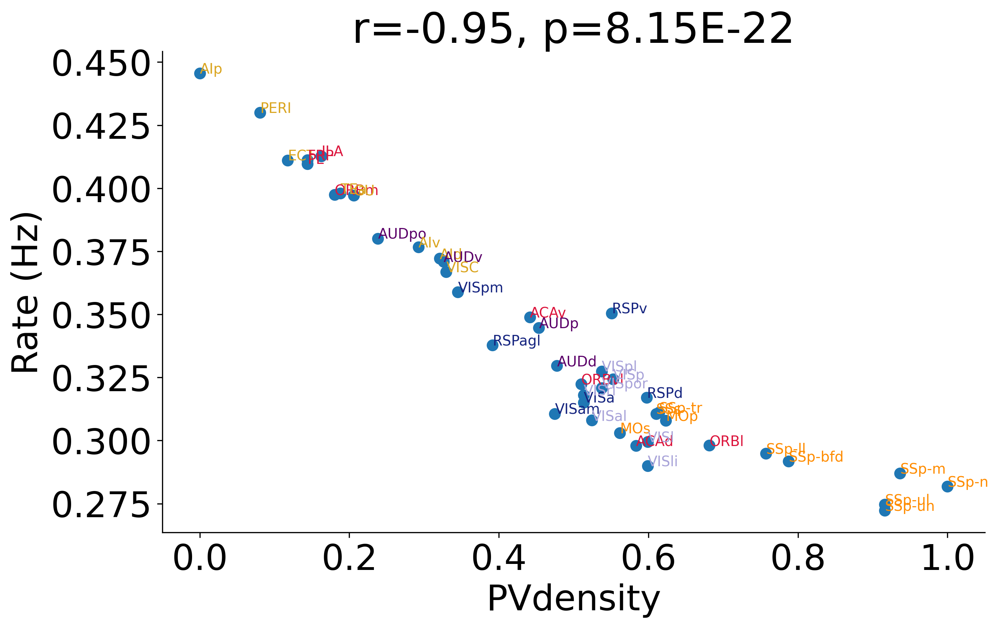

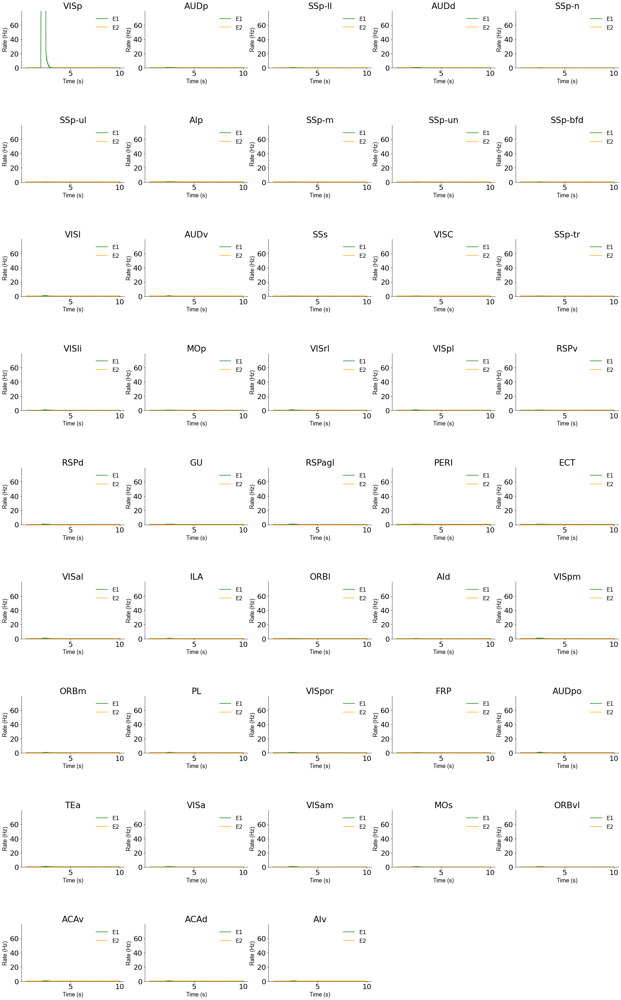

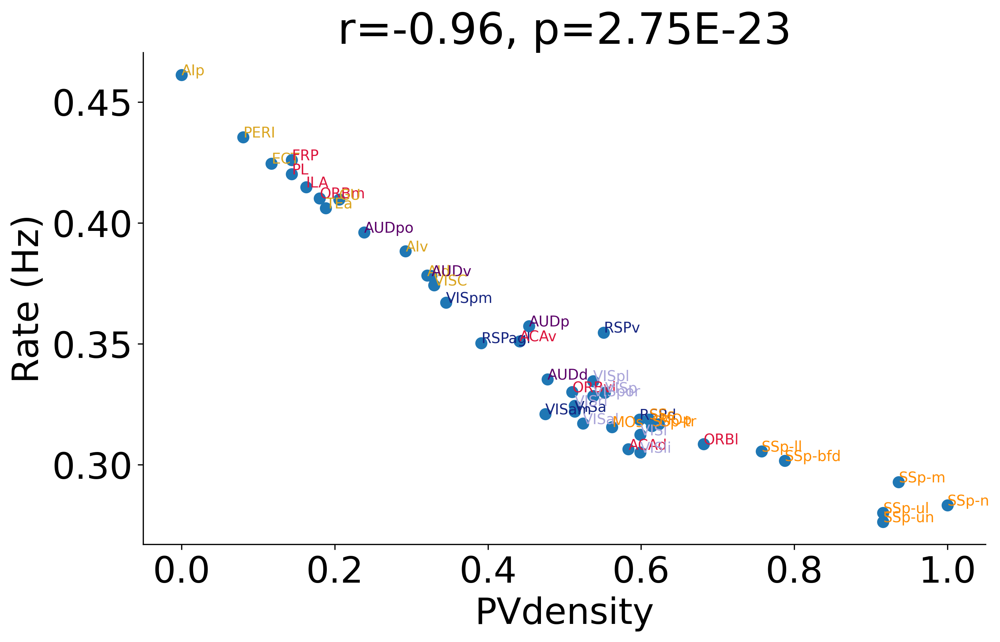

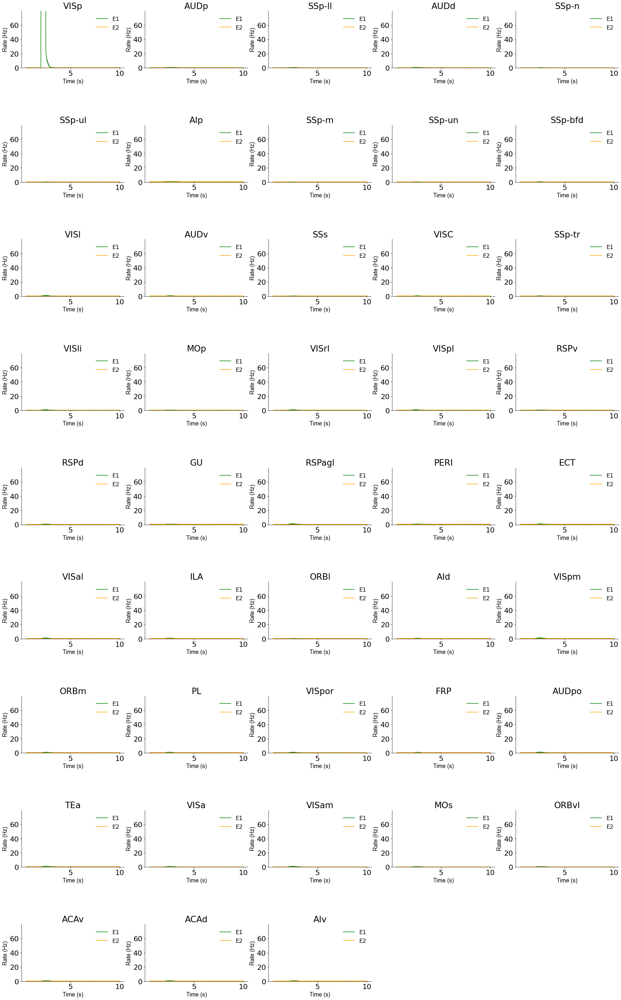

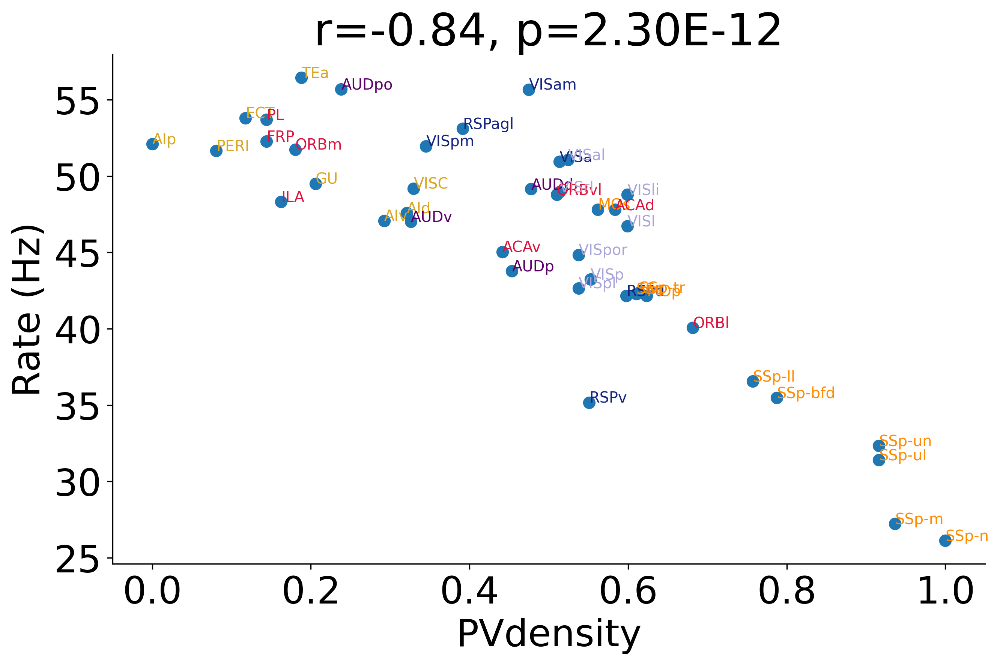

...

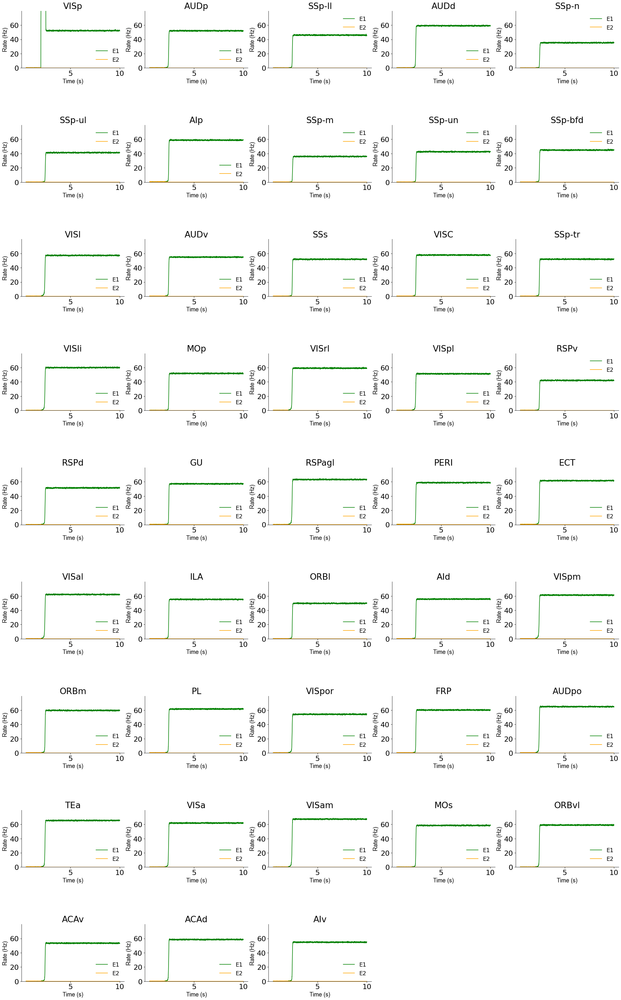

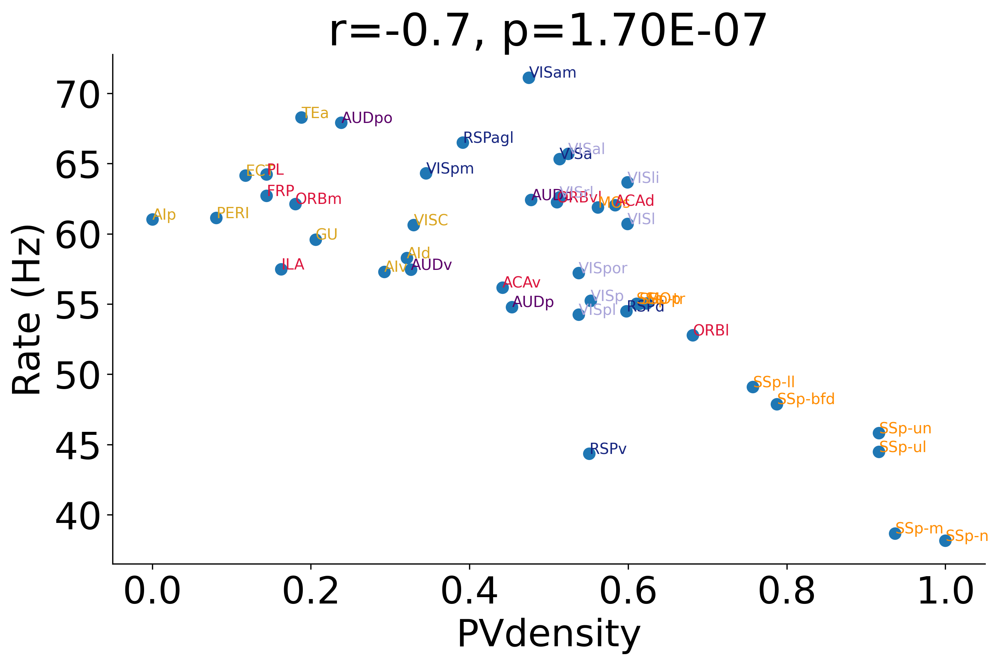

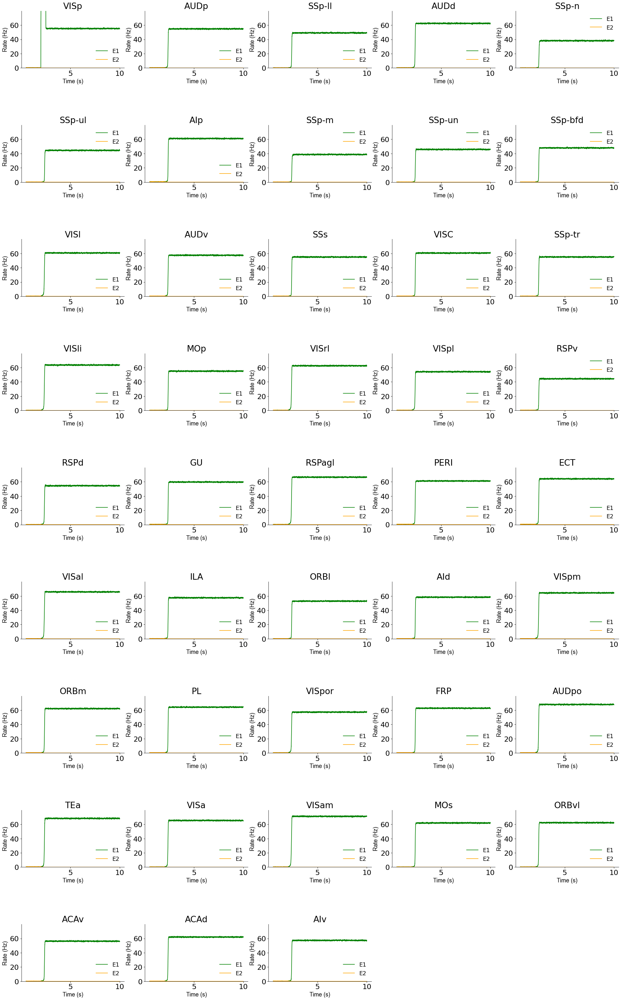

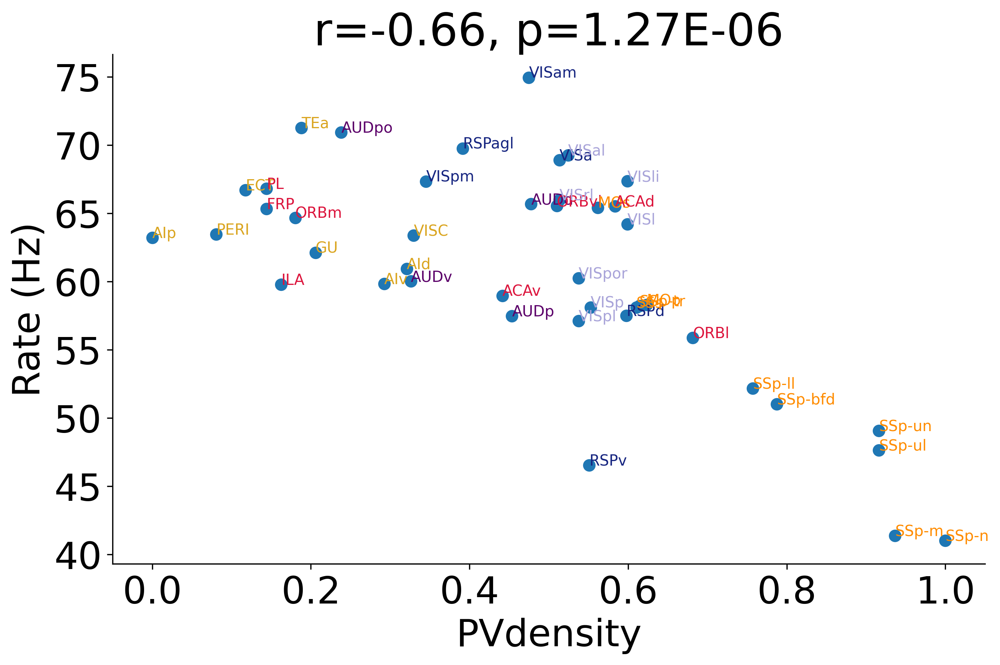

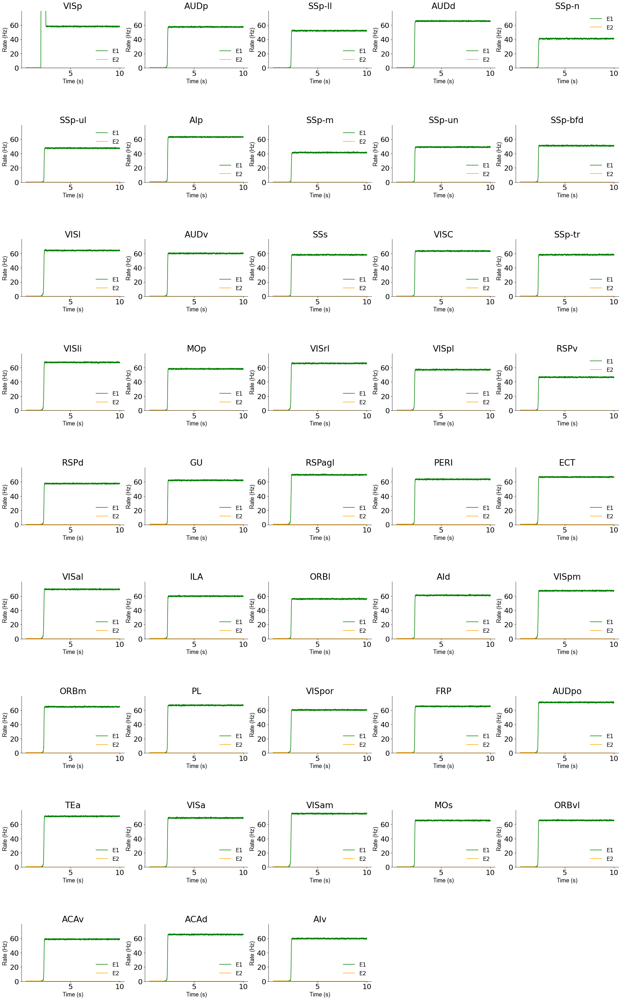

In [19]:
# A quick check of different pref density

# pref varies from 0 to 1. 
maxRateDict = {}
numPADict = {}

# for default regime simulations
parameters['trial_length'] = 10000 * brian2.ms # trial length (s) 
Prefrange = np.arange(0.45, 0.52, 0.01)

for prefValue in Prefrange:
    prefReplace = np.ones(pref_matrix.shape) * prefValue
    np.fill_diagonal(prefReplace, 0)
    print(prefValue)

    # run simulation
    modelReplacePref = model(parameters, False, conn_cxcx, prefReplace, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
    if not thcxmodel:
        modelReplacePref.add_input(parameters['stim_strength'],['VISp'], parameters['stim_on'], parameters['stim_off'], 'E1') 

    modelReplacePref.run_sim(vocal_prompt = False)
    [persistentactlist,_,_,_] = modelReplacePref.save_delay_activity('tempdata/',False)

    persistentact_df =  modelReplacePref.generatePAdf(PAthreshold)
    modelReplacePref.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
    modelReplacePref.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')
    
    maxRateDict[prefValue] = np.max(persistentactlist)
    # get the number of elements larger than 5 in persistentactlist
    numPADict[prefValue] = len([i for i in persistentactlist if i > 5])


In [20]:

maxRatelist = [maxRateDict[p] for p in Prefrange]
numPAlist = [numPADict[p] for p in Prefrange]



[52.2401326233649, 52.06606267811152, 46.05748112259781, 59.16981012769784, 35.29957391239924, 41.294367729362826, 58.8065625930327, 35.92987928802938, 42.529946918422546, 44.860248829377404, 57.22844267173122, 54.87893101793367, 51.848922099075374, 57.82981635422737, 51.93423183773471, 59.98408760200417, 51.93072713237503, 59.24897844405294, 51.39499932456767, 42.139154239073186, 51.471684361021154, 57.138789177782144, 63.162463435920394, 58.82315120190605, 61.63255819097099, 62.05045532253214, 55.24731884061101, 49.585430945849986, 55.663153965386265, 61.1900767498926, 59.549106062188635, 61.64644946787834, 54.1536758985193, 60.1493144883296, 64.885659929914, 65.3129431142245, 61.75375210497067, 67.29794104464685, 58.427448784896406, 58.990436536486826, 53.47034644270407, 58.50424669746104, 54.83564071578792]


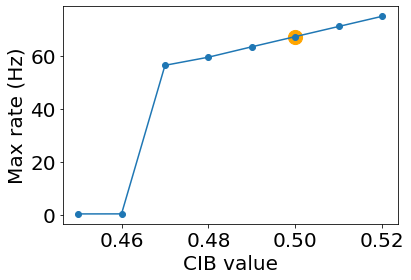

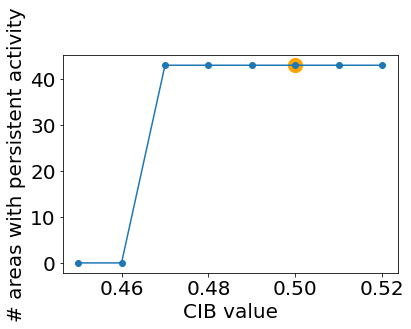

In [21]:
# plot the max rate vs. pref range
plt.figure(figsize=(6,4))
plt.plot(Prefrange, maxRatelist, 'o-')
plt.xlabel('CIB value')
plt.ylabel('Max rate (Hz)')

# add average Pref value.
avePref = 0.50
[avePrefPersist,_,_,_] = modelAveragePref.save_delay_activity('tempdata/',False)
print(avePrefPersist)
plt.scatter(avePref, np.max(avePrefPersist), color='orange', marker='o',s=200)

# plot the number of PA > 5 vs. pref range
plt.figure(figsize=(6,4))
plt.plot(Prefrange, numPAlist, 'o-')
plt.xlabel('CIB value')
plt.ylabel('# areas with persistent activity')

# add average Pref value.
plt.scatter(avePref, len([i for i in avePrefPersist if i > 5]), color='orange', marker='o', s=200)

VISp
simulation start: 
sim done.
1.94E-01
1.08E-13


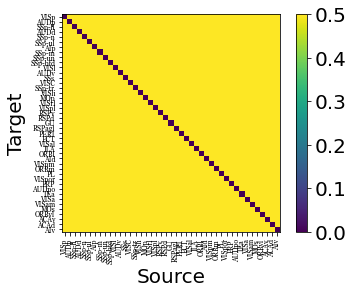

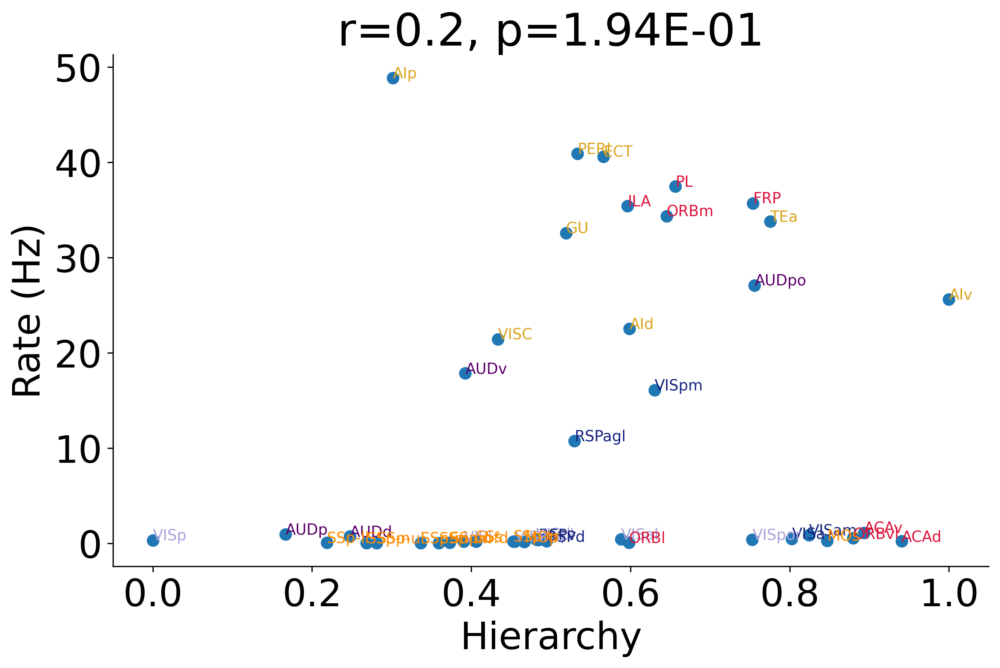

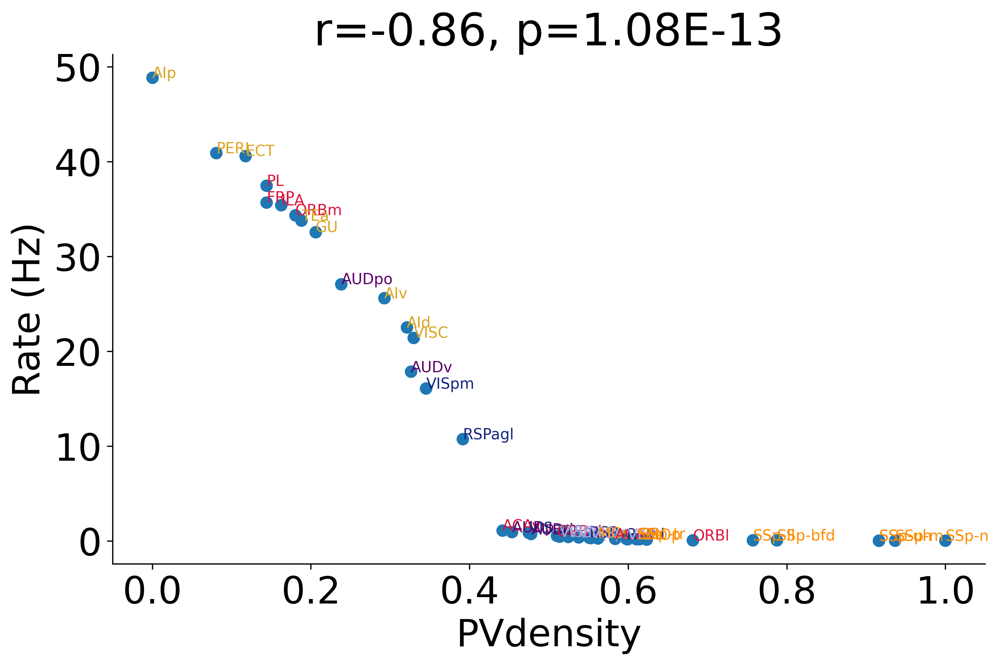

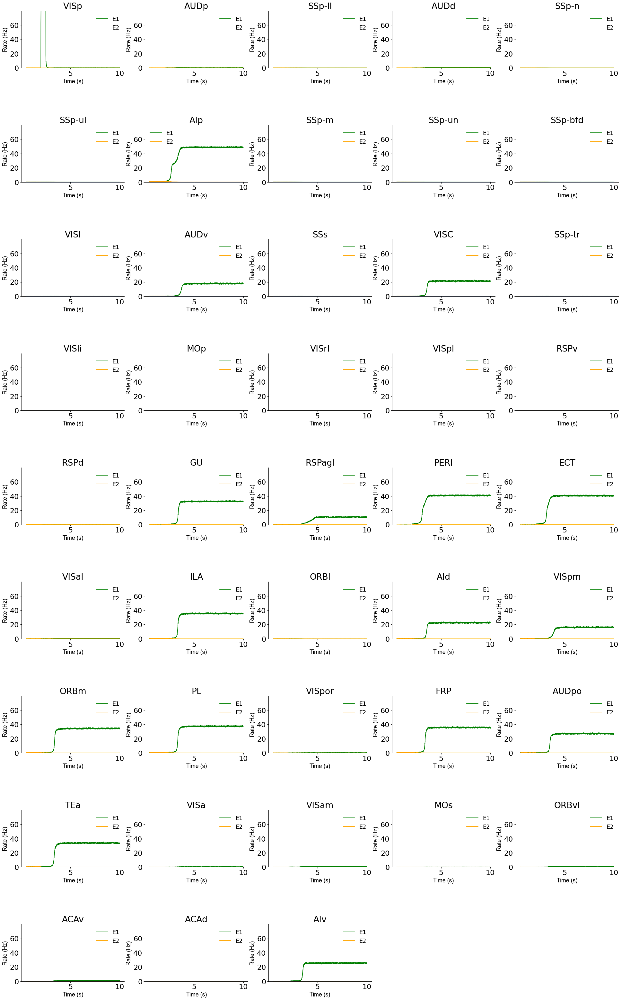

In [22]:
# A quick check of 0.5 CIB for alternative regime.
# set simulation time to be 10s
parameters['trial_length'] = 10000 * brian2.ms # trial length (s)

# fill long range pref with same value 0.5. 
prefAve = np.ones(pref_matrix.shape) * 0.5
np.fill_diagonal(prefAve, 0)
plot_pref(prefAve, area_list)

# alter parameters  
parametersAlter =  copy.deepcopy(parameters)
parametersAlter['JEI_scaling_factor'] = 10  # ref 0.83
parametersAlter['g_E_I'] = 0.075 * brian2.nA  # ref 0.192  * brian2.nA

# run simulation with 0.5 pref
modelAlternativeAveragePref = model(parametersAlter, False, conn_cxcx, prefAve, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
modelAlternativeAveragePref.add_input(parameters['stim_strength'],['VISp'], parameters['stim_on'], parameters['stim_off'], 'E1')

modelAlternativeAveragePref.run_sim(vocal_prompt = False)
[avePrefPersist,_,_,_] = modelAlternativeAveragePref.save_delay_activity('tempdata/',False)

persistentact_df =  modelAlternativeAveragePref.generatePAdf(PAthreshold)
modelAlternativeAveragePref.plotFRvsHier(False, True, 2, (10,6), 24, False, 'FRvsHier.pdf')
modelAlternativeAveragePref.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
modelAlternativeAveragePref.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')

with open('results/model_V1_Alt_noCIB.pkl', 'wb') as f:
    pickle.dump(modelAlternativeAveragePref, f)

In [27]:
# checkpoint

In [28]:
# for the same model, we search the parameter space of g_E_I base value, and JEI_scaling_factor

# fix trial length
parameters['trial_length'] = 10000 * brian2.ms # trial length (s) 
# makeQuickPlot or not
makeQuickPlot = False
# specify g_E_I range and JEI_scaling_factor range
dx = (0.192 - 0.075) / 10
g_E_Irange = 0.075 + np.arange(-2, 13, 1) * dx
# g_E_Irange = [0.075, 0.192]
dy = (10 - 0.83) / 10
JEI_scaling_factorrange = 0.83 + np.arange(-2, 13, 1) * dy
# JEI_scaling_factorrange = [10, 0.83]
print(JEI_scaling_factorrange)
JEI_scaling_factorrange = np.array([0] + list(JEI_scaling_factorrange[2:])) # remove the first two neg values. add 0
print(g_E_Irange, JEI_scaling_factorrange)

[-1.004 -0.087  0.83   1.747  2.664  3.581  4.498  5.415  6.332  7.249
  8.166  9.083 10.    10.917 11.834]
[0.0516 0.0633 0.075  0.0867 0.0984 0.1101 0.1218 0.1335 0.1452 0.1569
 0.1686 0.1803 0.192  0.2037 0.2154] [ 0.     0.83   1.747  2.664  3.581  4.498  5.415  6.332  7.249  8.166
  9.083 10.    10.917 11.834]


In [29]:

# init results matrix
maxRateMatrixReference = np.zeros((len(g_E_Irange), len(JEI_scaling_factorrange)))
numPAMatrixReference = np.zeros((len(g_E_Irange), len(JEI_scaling_factorrange)))
maxBaseMatrixReference = np.zeros((len(g_E_Irange), len(JEI_scaling_factorrange)))

maxRateMatrixReplacePref = np.zeros((len(g_E_Irange), len(JEI_scaling_factorrange)))
numPAMatrixReplacePref = np.zeros((len(g_E_Irange), len(JEI_scaling_factorrange)))
maxBaseMatrixReplacePref = np.zeros((len(g_E_Irange), len(JEI_scaling_factorrange)))

maxRateMatrixReplacePV = np.zeros((len(g_E_Irange), len(JEI_scaling_factorrange)))
numPAMatrixReplacePV = np.zeros((len(g_E_Irange), len(JEI_scaling_factorrange)))
maxBaseMatrixReplacePV = np.zeros((len(g_E_Irange), len(JEI_scaling_factorrange)))

# search g_E_I and JEI_scaling_factor space. 
for i, current_g_E_I in enumerate(g_E_Irange):
    for j, current_JEI_scaling_factor in enumerate(JEI_scaling_factorrange):
        print(f'start running simulations with {current_g_E_I} and {current_JEI_scaling_factor}.\n')
        # init parameters for each run
        current_parameters = copy.copy(parameters)
        current_parameters['J_G_EI_min'] = 1
        current_parameters['g_E_I'] = current_g_E_I * brian2.nA # nA
        current_parameters['JEI_scaling_factor'] = current_JEI_scaling_factor
        
        # run simulation with reference cib and pv.  mm99
        modelReference = model(current_parameters, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
        if not thcxmodel:
            modelReference.add_input(current_parameters['stim_strength'],['VISp'], current_parameters['stim_on'], current_parameters['stim_off'], 'E1') 

        modelReference.run_sim(vocal_prompt = False)
        [persistentactlistReference,baselineactlistReference,_,_] = modelReference.save_delay_activity('tempdata/',False)

        persistentact_dfReference =  modelReference.generatePAdf(PAthreshold)
        if makeQuickPlot:
            modelReference.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
            modelReference.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')

        maxRateMatrixReference[i, j] = np.max(persistentactlistReference)
        maxBaseMatrixReference[i, j] = np.max(baselineactlistReference)
        # get the number of elements larger than 5 in persistentactlist
        numPAMatrixReference[i, j] = len([i for i in persistentactlistReference if i > 5])


        # run simulation with 0.5 cib
        
        prefReplace = np.ones(pref_matrix.shape) * 0.5
        np.fill_diagonal(prefReplace, 0)

        modelReplacePref = model(current_parameters, False, conn_cxcx, prefReplace, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
        if not thcxmodel:
            modelReplacePref.add_input(current_parameters['stim_strength'],['VISp'], current_parameters['stim_on'], current_parameters['stim_off'], 'E1') 

        modelReplacePref.run_sim(vocal_prompt = False)
        [persistentactlistReplacePref,baselineactlistReplacePref,_,_] = modelReplacePref.save_delay_activity('tempdata/',False)

        persistentact_dfReplacePref =  modelReplacePref.generatePAdf(PAthreshold)
        if makeQuickPlot:
            modelReplacePref.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
            modelReplacePref.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')
        
        maxRateMatrixReplacePref[i, j] = np.max(persistentactlistReplacePref)
        maxBaseMatrixReplacePref[i, j] = np.max(baselineactlistReplacePref)
        # get the number of elements larger than 5 in persistentactlist
        numPAMatrixReplacePref[i, j] = len([i for i in persistentactlistReplacePref if i > 5])

        #  # run simulation with average PV.

        replacePVgrad_df = pd.DataFrame(index=normPVgrad_df.index, columns=normPVgrad_df.columns)
        replacePVgrad_df = replacePVgrad_df.fillna(normPVgrad_df.mean())

        modelReplacePV = model(current_parameters, False, conn_cxcx, pref_matrix, hierarchy_df, replacePVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
        if not thcxmodel:
            modelReplacePV.add_input(current_parameters['stim_strength'],['VISp'], current_parameters['stim_on'], current_parameters['stim_off'], 'E1') 

        modelReplacePV.run_sim(vocal_prompt = False)
        [persistentactlistReplacePV,baselineactlistReplacePV,_,_] = modelReplacePV.save_delay_activity('tempdata/',False)

        persistentact_dfReplacePV =  modelReplacePV.generatePAdf(PAthreshold)
        if makeQuickPlot:
            modelReplacePV.plotFRvsHier(False, True, 2, (10,6), 24, False, 'FRvsHier.pdf')
            modelReplacePV.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')
        
        maxRateMatrixReplacePV[i, j] = np.max(persistentactlistReplacePV)
        maxBaseMatrixReplacePV[i, j] = np.max(baselineactlistReplacePV)
        # get the number of elements larger than 5 in persistentactlist
        numPAMatrixReplacePV[i, j] = len([i for i in persistentactlistReplacePV if i > 5])


start running simulations with 0.05159999999999999 and 0.0.

VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
start running simulations with 0.05159999999999999 and 0.83.

VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
start running simulations with 0.05159999999999999 and 1.7469999999999999.

VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
start running simulations with 0.05159999999999999 and 2.664.

VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
start running simulations with 0.05159999999999999 and 3.5810000000000004.

VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
start running simulations with 0.05159999999999999 and 4.498.

VISp
simulation start: 
sim done.
VISp
simulation start: 
sim done.
VISp
simulation start

In [30]:
# a dict to store all the matrices with keys the same as the variable names.
matricesDict = {'maxRateMatrixReference': maxRateMatrixReference,
                'numPAMatrixReference': numPAMatrixReference,
                'maxBaseMatrixReference': maxBaseMatrixReference,
                'maxRateMatrixReplacePref': maxRateMatrixReplacePref,
                'numPAMatrixReplacePref': numPAMatrixReplacePref,
                'maxBaseMatrixReplacePref': maxBaseMatrixReplacePref,
                'maxRateMatrixReplacePV': maxRateMatrixReplacePV,
                'numPAMatrixReplacePV': numPAMatrixReplacePV,
                'maxBaseMatrixReplacePV': maxBaseMatrixReplacePV}
for key in matricesDict:
    np.savetxt('results/' + key + '.txt', matricesDict[key])

In [31]:
# load the saved matrices
matricesDict = {'maxRateMatrixReference': None,
                'numPAMatrixReference': None,
                'maxBaseMatrixReference': None,
                'maxRateMatrixReplacePref': None,
                'numPAMatrixReplacePref': None,
                'maxBaseMatrixReplacePref': None,
                'maxRateMatrixReplacePV': None,
                'numPAMatrixReplacePV': None,
                'maxBaseMatrixReplacePV': None}
for key in matricesDict:
    matricesDict[key] = np.loadtxt('results/' + key + '.txt')
    
numPAMatrixReference = matricesDict['numPAMatrixReference']
maxRateMatrixReference = matricesDict['maxRateMatrixReference']
maxBaseMatrixReference = matricesDict['maxBaseMatrixReference']
numPAMatrixReplacePref = matricesDict['numPAMatrixReplacePref']
maxRateMatrixReplacePref = matricesDict['maxRateMatrixReplacePref']
maxBaseMatrixReplacePref = matricesDict['maxBaseMatrixReplacePref']
numPAMatrixReplacePV = matricesDict['numPAMatrixReplacePV']
maxRateMatrixReplacePV = matricesDict['maxRateMatrixReplacePV']
maxBaseMatrixReplacePV = matricesDict['maxBaseMatrixReplacePV']

In [32]:
g_E_Irange = 0.075 + np.arange(-2, 13, 1) * dx
g_E_Irange

array([0.0516, 0.0633, 0.075 , 0.0867, 0.0984, 0.1101, 0.1218, 0.1335,
       0.1452, 0.1569, 0.1686, 0.1803, 0.192 , 0.2037, 0.2154])

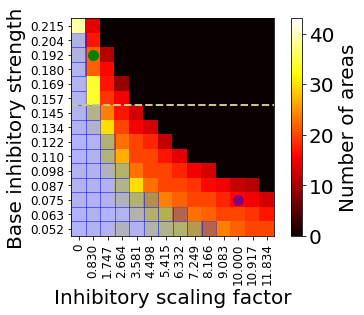

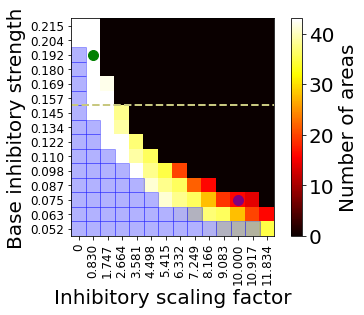

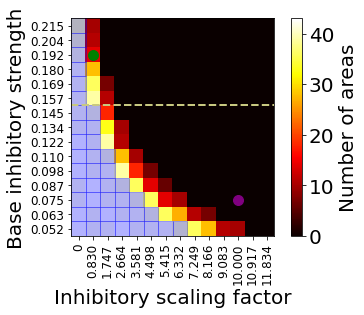

In [34]:
from matplotlib.patches import Rectangle
# make a heatmap of maxRateMatrixReference and more

# Create a function that takes an x value and returns a formatted string
def myTicks(x):
    if x == 0:
        return "0"
    else:
        return "{:.3f}".format(x)

def plotMartixFunc(plotMartix, matricesDict, maxBaseMatrix, plottitle, saveFig, fileName):
    plt.figure(figsize=(6,4))
    plt.title(plottitle)
    # print(plotMartix)
    width, height = np.shape(matricesDict[plotMartix])
    plt.imshow(np.flipud(matricesDict[plotMartix]), cmap='hot', interpolation='nearest')
    #  extent=[0, width, height, 0]
    cbar = plt.colorbar()
    cbar.set_label('Number of areas')
    # add rectangles to show the areas with unstable baseline.
    FRthreshold = 5
    for i in range(width):
        for j in range(height):
            if maxBaseMatrix[i, j] > FRthreshold:
                rect = Rectangle((j-0.5, height - i-0.5), 1, 1, linewidth=1, edgecolor='blue', facecolor='blue', alpha=0.3)
                plt.gca().add_patch(rect)
    # add a rectangle to show the threshold of independent persistent activity.
    threshold = 8                
    plt.axhline(y=height - threshold - 0.5, color=(200/255, 200/255, 128/255), linestyle='--', linewidth=2)
    x1, y1 = 1, 12
    x2, y2 = 11, 2
    plt.scatter(x1, height - y1, color='green', s=100, zorder=2)
    plt.scatter(x2, height - y2, color='purple', s=100, zorder=2)

    
    plt.xticks(np.arange(len(JEI_scaling_factorrange)), [myTicks(x) for x in JEI_scaling_factorrange], rotation=90, fontsize=12)  
    plt.yticks(np.arange(len(g_E_Irange)), [myTicks(x) for x in g_E_Irange[::-1]], fontsize=12)
    plt.xlabel('Inhibitory scaling factor')
    plt.ylabel('Base inhibitory strength')
    if saveFig:
        plt.savefig('figure/' + fileName, dpi=300, bbox_inches='tight', transparent=True)
plotMartixFunc('numPAMatrixReference', matricesDict, maxBaseMatrixReference, None, True, 'noPVnoCIBsim/numPAMatrixReference.pdf')
plotMartixFunc('numPAMatrixReplacePref', matricesDict, maxBaseMatrixReplacePref, None, True, 'noPVnoCIBsim/numPAMatrixReplacePref.pdf')
plotMartixFunc('numPAMatrixReplacePV', matricesDict, maxBaseMatrixReplacePV, None, True, 'noPVnoCIBsim/numPAMatrixReplacePV.pdf')


In [35]:
# exploration of the parameter space of g_E_I and JEI_scaling_factor. 
# Finding the regime with none of areas showing independent persistent activity.

# for a local circuit. 


# makeQuickPlot or not
makeQuickPlot = False
# specify g_E_I range and JEI_scaling_factor range
g_E_ISearchrange = np.arange(0.14, 0.175, 0.005)
print(g_E_Irange)
print(g_E_ISearchrange)

# init results list
MaxRateNoLRList = []

# search g_E_I space for non long range connections.
for i, current_g_E_I in enumerate(g_E_ISearchrange):
    print(f'start running simulations with {current_g_E_I}. \n')
    # init parameters for each run
    
    current_parameters = copy.copy(parameters)
    # fix trial length
    current_parameters['trial_length'] = 10000 * brian2.ms # trial length (s) 
    current_parameters['std_noise'] = 0 * brian2.nA
    current_parameters['J_G_EI_min'] = 1
    current_parameters['g_E_I'] = current_g_E_I * brian2.nA # nA
    # no long range connections. 
    current_parameters['mu_EE'] = 0 * brian2.nA
    current_parameters.update({'mu_IE': current_parameters['mu_EE'] * current_parameters['ratio_mu_IE_mu_EE']}) # remember to update mu_IE
    
    # run simulation with noLR
    modelNoLR = model(current_parameters, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
    if not thcxmodel:
        modelNoLR.add_input(current_parameters['stim_strength'],area_list, current_parameters['stim_on'], current_parameters['stim_off'], 'E1') 

    modelNoLR.run_sim(vocal_prompt = False)
    [persistentactlistNoLR,baselineactlistNoLR,_,_] = modelNoLR.save_delay_activity('tempdata/',False)

    persistentact_dfNoLR =  modelNoLR.generatePAdf(PAthreshold)
    if makeQuickPlot:
        modelNoLR.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
        modelNoLR.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')
    # save the max firing rate, which is AIp
    MaxRateNoLRList.append(max(persistentactlistNoLR))

[0.0516 0.0633 0.075  0.0867 0.0984 0.1101 0.1218 0.1335 0.1452 0.1569
 0.1686 0.1803 0.192  0.2037 0.2154]
[0.14  0.145 0.15  0.155 0.16  0.165 0.17 ]
start running simulations with 0.14. 

VISp
AUDp
SSp-ll
AUDd
SSp-n
SSp-ul
AIp
SSp-m
SSp-un
SSp-bfd
VISl
AUDv
SSs
VISC
SSp-tr
VISli
MOp
VISrl
VISpl
RSPv
RSPd
GU
RSPagl
PERI
ECT
VISal
ILA
ORBl
AId
VISpm
ORBm
PL
VISpor
FRP
AUDpo
TEa
VISa
VISam
MOs
ORBvl
ACAv
ACAd
AIv
simulation start: 
sim done.
start running simulations with 0.14500000000000002. 

VISp
AUDp
SSp-ll
AUDd
SSp-n
SSp-ul
AIp
SSp-m
SSp-un
SSp-bfd
VISl
AUDv
SSs
VISC
SSp-tr
VISli
MOp
VISrl
VISpl
RSPv
RSPd
GU
RSPagl
PERI
ECT
VISal
ILA
ORBl
AId
VISpm
ORBm
PL
VISpor
FRP
AUDpo
TEa
VISa
VISam
MOs
ORBvl
ACAv
ACAd
AIv
simulation start: 
sim done.
start running simulations with 0.15000000000000002. 

VISp
AUDp
SSp-ll
AUDd
SSp-n
SSp-ul
AIp
SSp-m
SSp-un
SSp-bfd
VISl
AUDv
SSs
VISC
SSp-tr
VISli
MOp
VISrl
VISpl
RSPv
RSPd
GU
RSPagl
PERI
ECT
VISal
ILA
ORBl
AId
VISpm
ORBm
PL
VISpor
FRP
AUDpo
TEa


[0.14  0.145 0.15  0.155 0.16  0.165 0.17 ]


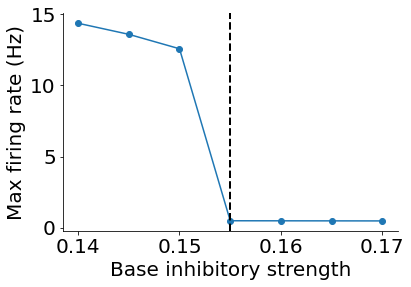

In [36]:
# plot the max firing rate vs. g_E_I
plt.figure(figsize=(6,4))
plt.plot(g_E_ISearchrange, MaxRateNoLRList, 'o-')
plt.xlabel('Base inhibitory strength')
plt.ylabel('Max firing rate (Hz)')
# plt.title('Simulated with no long range connections')
print(g_E_ISearchrange)  # the threshold is 0.155

ax = plt.gca()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.axvline(x=0.155, color='k', linestyle='--', linewidth=2)



In [37]:
# inhibiting all core areas. 
core = [21, 24, 26, 28, 29, 30, 31]
coreAreaList = [area_list[i] for i in core]
coreAreaList


['GU', 'ECT', 'ILA', 'AId', 'VISpm', 'ORBm', 'PL']

VISp
GU
ECT
ILA
AId
VISpm
ORBm
PL
simulation start: 
sim done.
3.32E-01


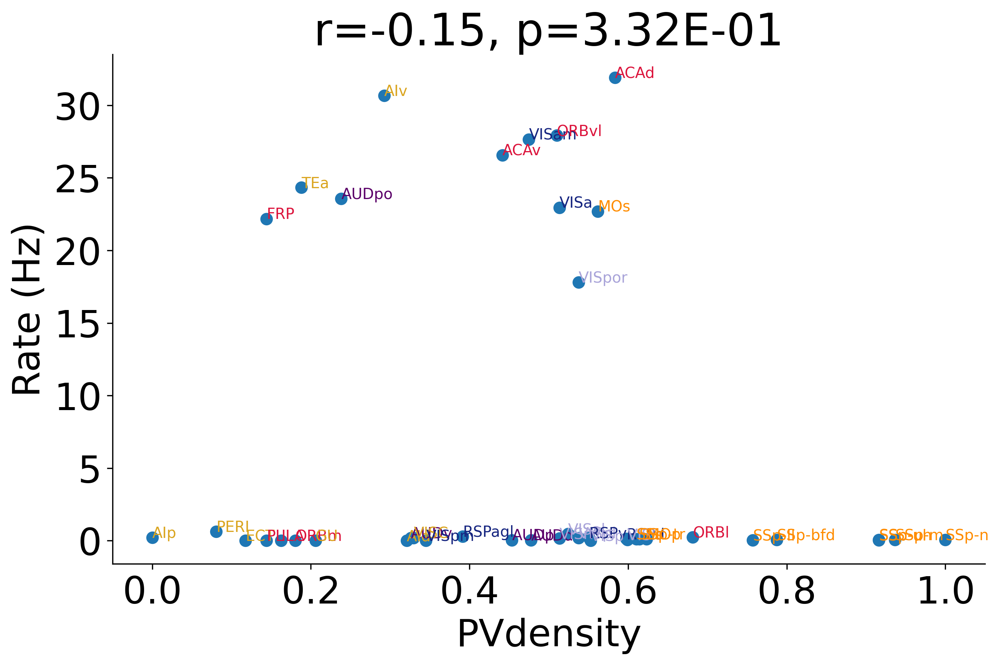

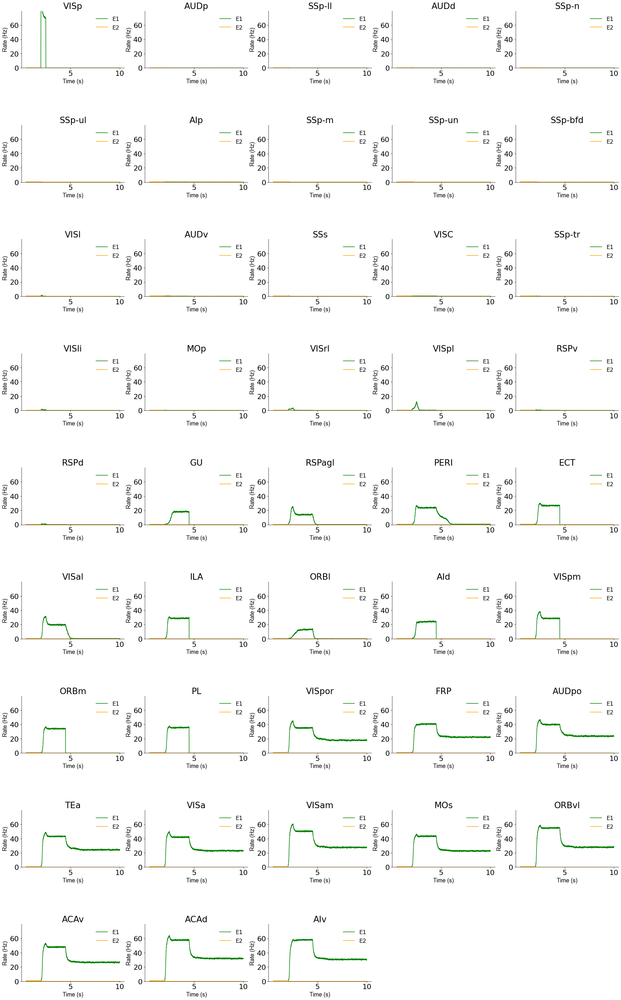

In [38]:
# inhibiting all core areas. 
# set simulation time to be 10s
parameters['trial_length'] = 10000 * brian2.ms # trial length (s)
makeQuickPlot = True
# # run simulation 
np.random.seed(42) # 2 for decresed firing rate and 8 core areas
modelAllcore = model(parameters, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
modelAllcore.add_input(parameters['stim_strength'],['VISp'], parameters['stim_on'], parameters['stim_off'], 'E1') 
# add delay period inhition
modelAllcore.add_input(50*current_parameters['stim_strength'], coreAreaList, current_parameters['stim_off'] + current_parameters['stim_on'], current_parameters['trial_length'], 'I')

modelAllcore.run_sim(vocal_prompt = False)
[persistentactlist,baselineactlist,_,_] = modelAllcore.save_delay_activity('tempdata/',False)
persistentact_df =  modelAllcore.generatePAdf(PAthreshold)
if makeQuickPlot:
    modelAllcore.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
    modelAllcore.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')

with open('results/model_V1_allcore.pkl', 'wb') as f:
    pickle.dump(modelAllcore, f)

VISp
simulation start: 
sim done.
4.65E-33
VISp
simulation start: 
sim done.
4.18E-01
VISp
simulation start: 
sim done.
4.70E-04
VISp
simulation start: 
sim done.
4.45E-01
VISp
simulation start: 
sim done.
1.44E-01


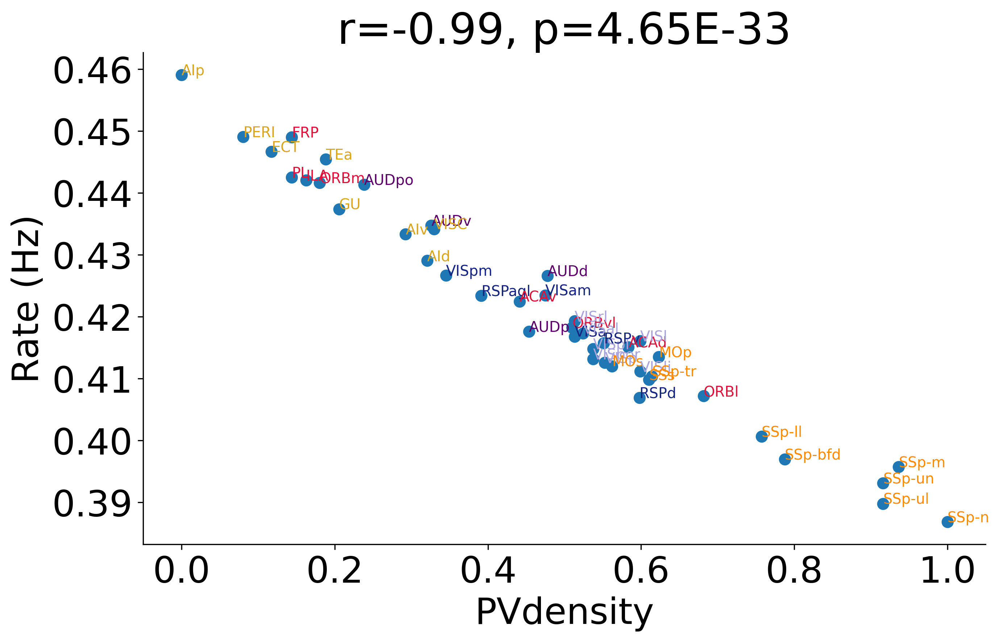

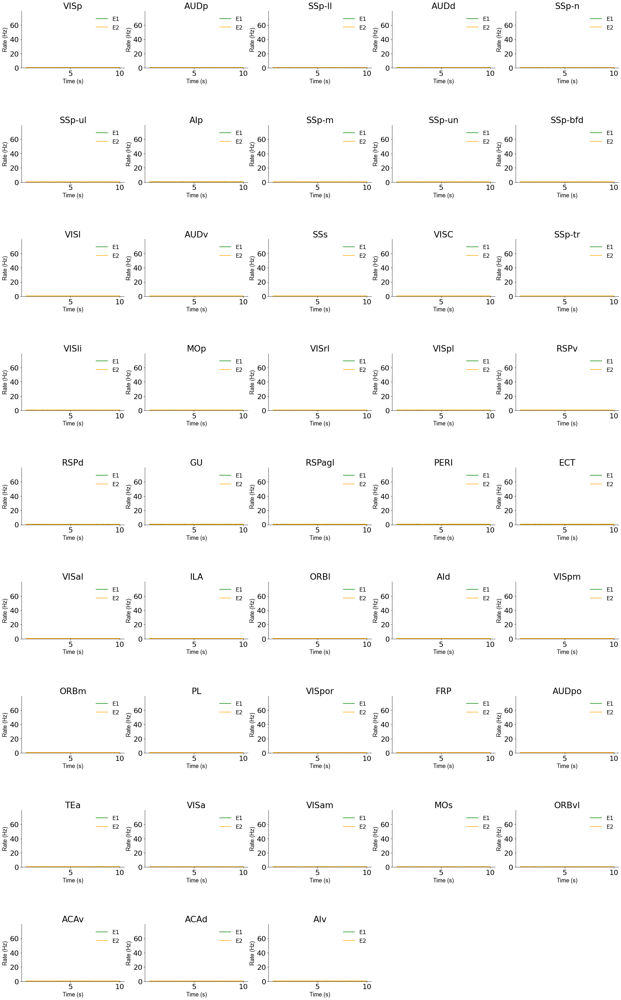

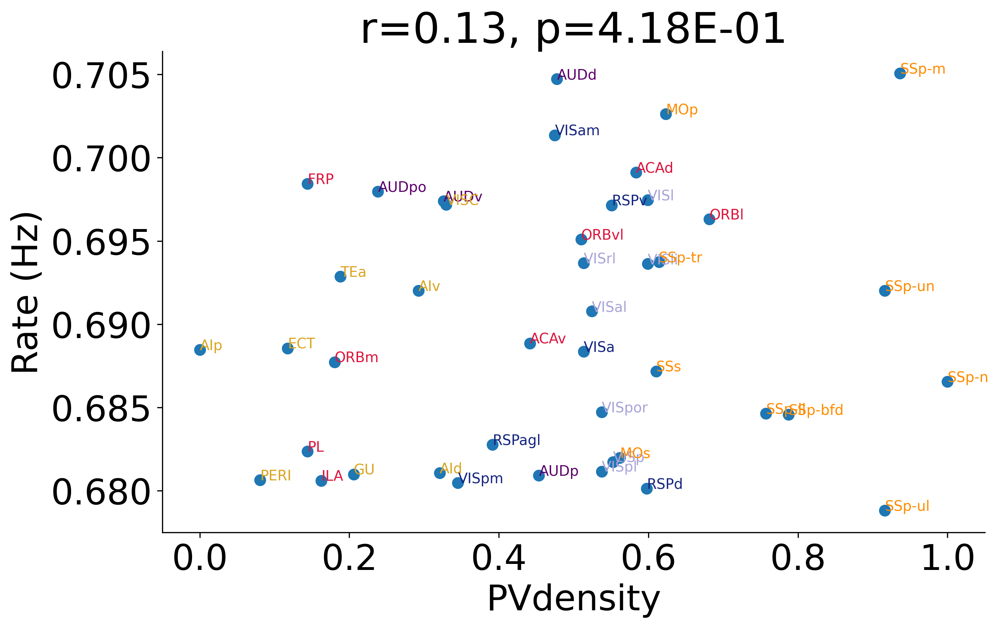

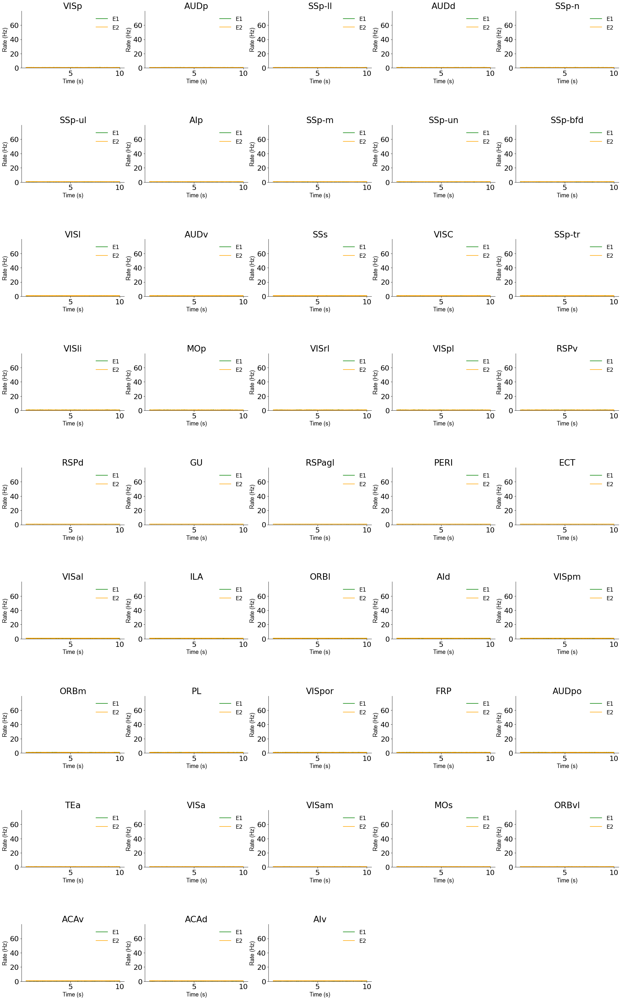

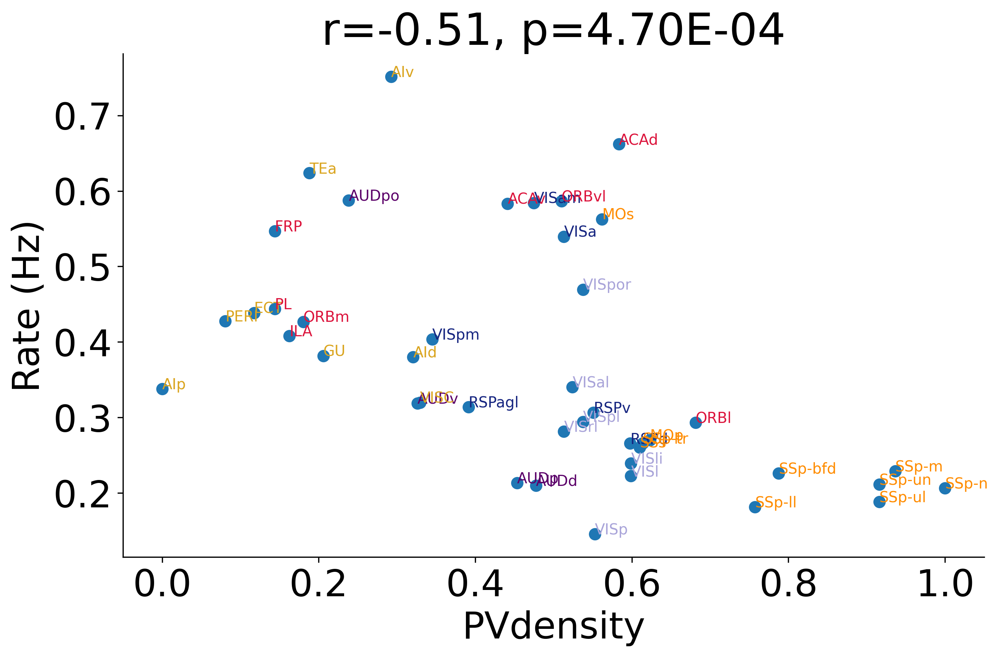

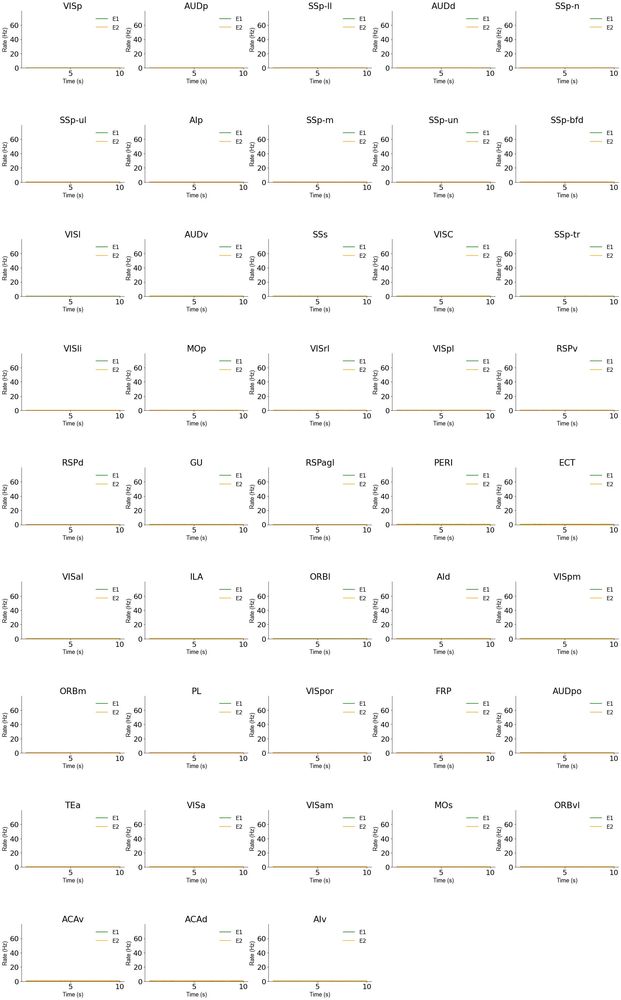

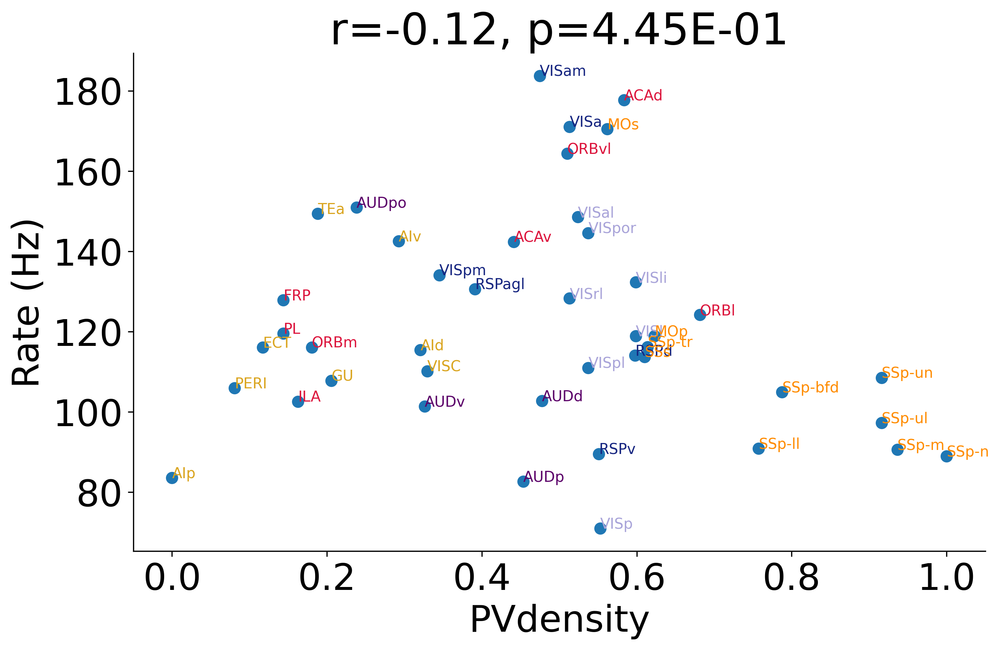

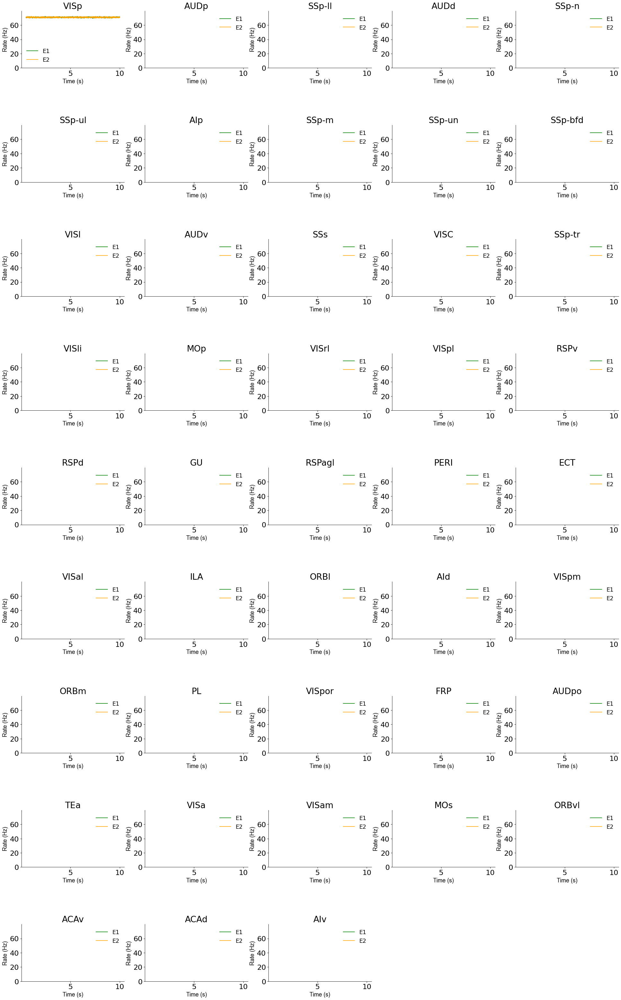

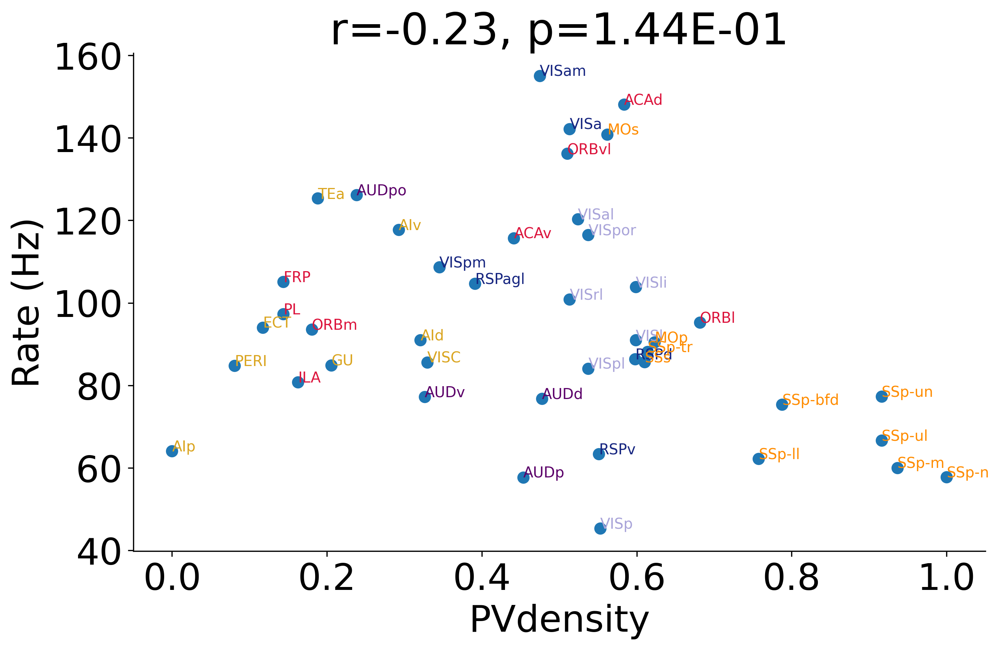

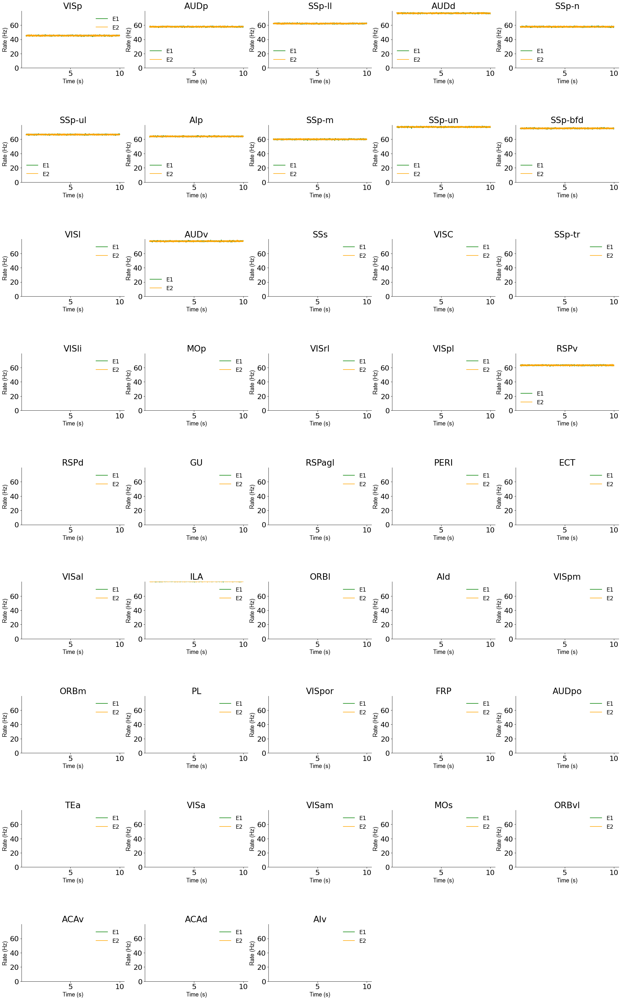

In [39]:
# run inhibitory stablizing regime simulations and save the results.

# set simulation time to be 10s
parameters['trial_length'] = 10000 * brian2.ms # trial length (s)

# inhibiting all core areas. 
def runBaselineSim(parameters,filename,makeQuickPlot = False):
    # # run simulation 
    np.random.seed(42) # 2 for decresed firing rate and 8 core areas
    model_base = model(parameters, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
    model_base.add_input(0,['VISp'], parameters['stim_on'], parameters['stim_off'], 'E1')
    # model_base.add_input(parameters['stim_strength'],area_list, parameters['stim_on'], parameters['stim_off'], 'E1')
    model_base.run_sim(vocal_prompt = False)

    [persistentactlist,baselineactlist,_,_] = model_base.save_delay_activity('tempdata/',False)
    persistentact_df =  model_base.generatePAdf(PAthreshold)
    if makeQuickPlot:
        model_base.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
        model_base.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')
    with open('results/' + filename, 'wb') as f:
        pickle.dump(model_base, f)

# with open('results/model_V1_noLR.pkl', 'wb') as f:
#         pickle.dump(model, f)
# with open('results/model_V1_noLR_noInh.pkl', 'wb') as f:
#     pickle.dump(model_V1, f)


parameters_noLR = copy.deepcopy(parameters)
parameters_noLR['mu_EE'] = 0 * brian2.nA
parameters_noLR['mu_IE'] = 0 * brian2.nA
runBaselineSim(parameters_noLR, 'model_V1_noLR.pkl',True)

parameters_noLR_noInh = copy.deepcopy(parameters)
parameters_noLR_noInh['mu_EE'] = 0 * brian2.nA
parameters_noLR_noInh['mu_IE'] = 0 * brian2.nA
parameters_noLR_noInh['g_E_I'] = 0 * brian2.nA
runBaselineSim(parameters_noLR_noInh, 'model_V1_noLR_noInh.pkl',True)

parameters_LR = copy.deepcopy(parameters)
runBaselineSim(parameters_LR, 'model_V1_LR.pkl',True)

parameters_LR_nolocalInh = copy.deepcopy(parameters)
parameters_LR_nolocalInh['g_E_I'] = 0 * brian2.nA
runBaselineSim(parameters_LR_nolocalInh, 'model_V1_LR_nolocalInh.pkl',True)

parameters_LR_noLRInh = copy.deepcopy(parameters)
parameters_LR_noLRInh['mu_IE'] = 0 * brian2.nA
runBaselineSim(parameters_LR_noLRInh, 'model_V1_LR_noLRInh.pkl',True)


VISp
simulation start: 
sim done.
3.92E-45
VISp
simulation start: 
sim done.
1.00E+00


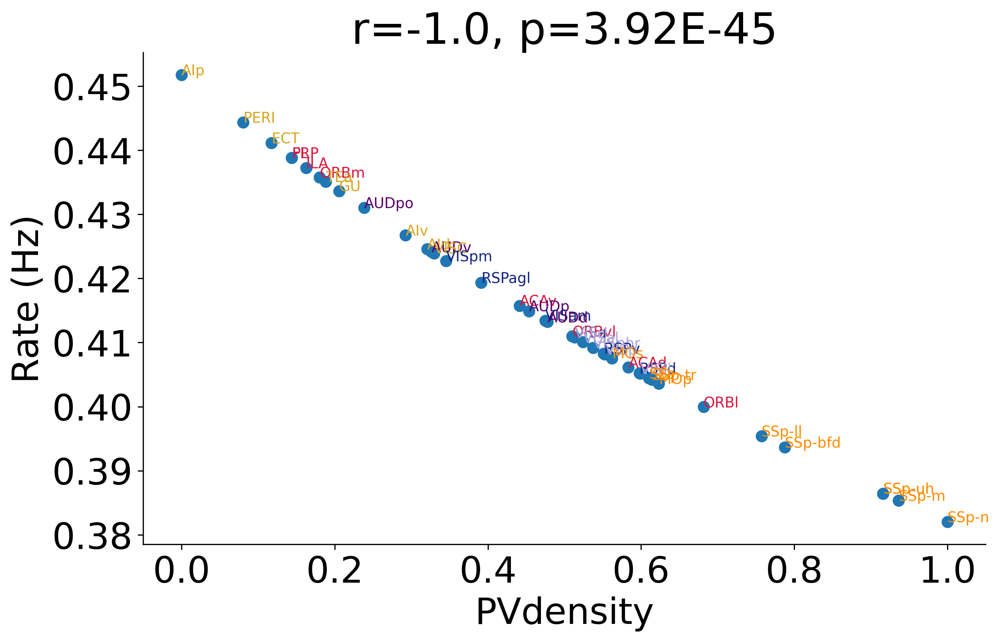

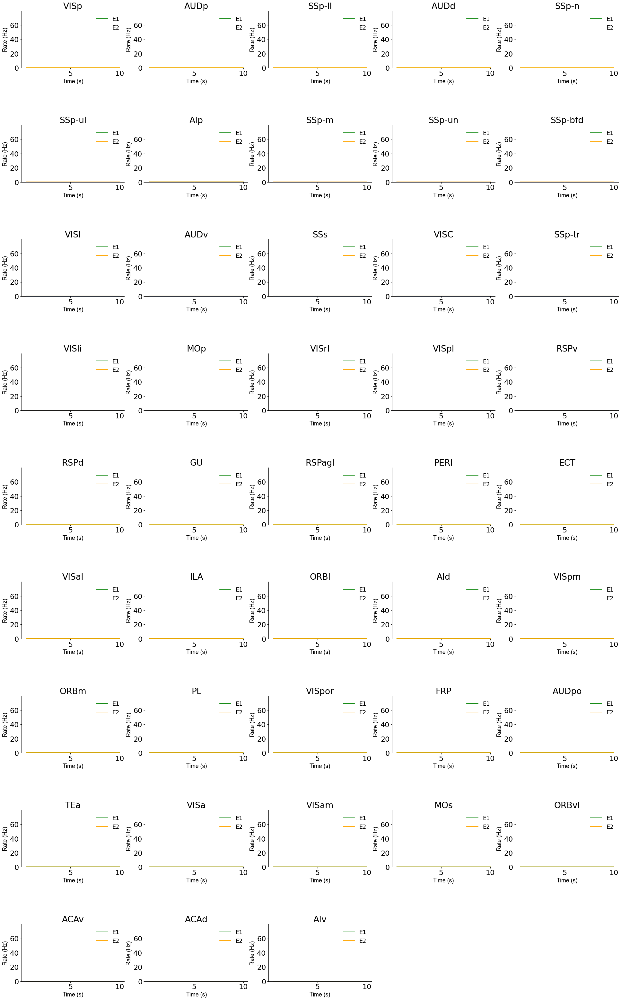

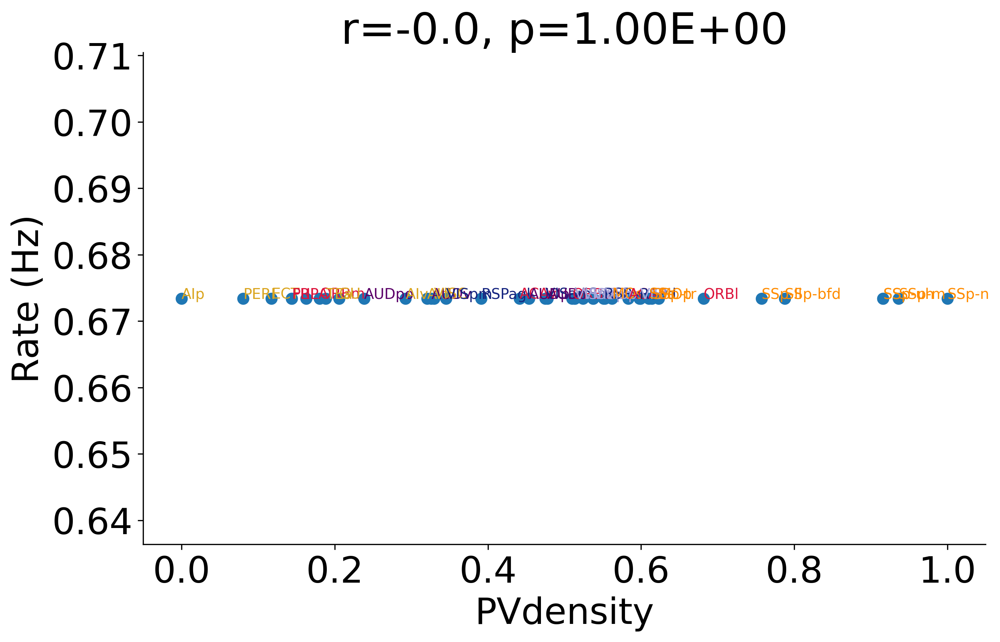

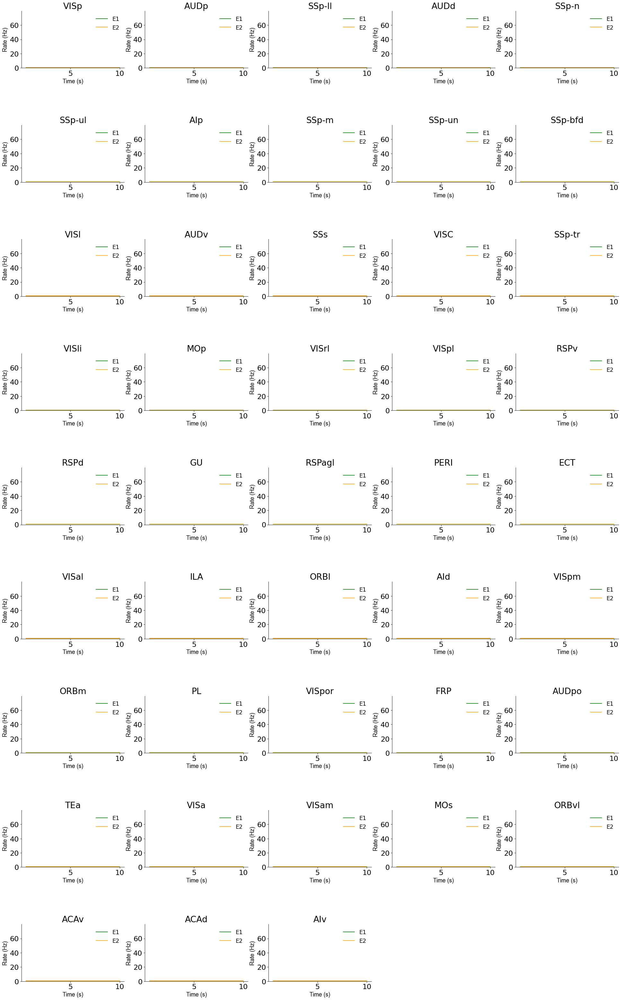

In [40]:
# test the no noise case to compare with the calculation results.

parameters_noLR_zeronoise = copy.deepcopy(parameters)
parameters_noLR_zeronoise['std_noise'] = 0 * brian2.nA
parameters_noLR_zeronoise['mu_EE'] = 0 * brian2.nA
parameters_noLR_zeronoise['mu_IE'] = 0 * brian2.nA
runBaselineSim(parameters_noLR_zeronoise, 'model_V1_noLR_zeronoise.pkl',True)

parameters_noLR_noInh_zeronoise = copy.deepcopy(parameters)
parameters_noLR_noInh_zeronoise['std_noise'] = 0 * brian2.nA
parameters_noLR_noInh_zeronoise['mu_EE'] = 0 * brian2.nA
parameters_noLR_noInh_zeronoise['mu_IE'] = 0 * brian2.nA
parameters_noLR_noInh_zeronoise['g_E_I'] = 0 * brian2.nA
runBaselineSim(parameters_noLR_noInh_zeronoise, 'model_V1_noLR_noInh_zeronoise.pkl',True)


VISp
simulation start: 
sim done.
2.47E-37
VISp
simulation start: 
sim done.
1.00E+00


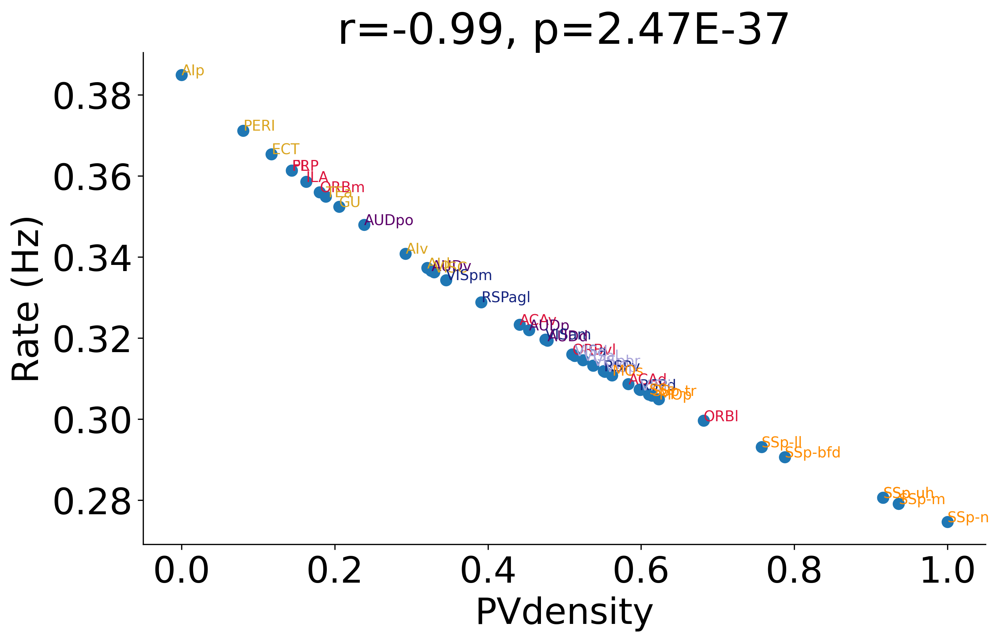

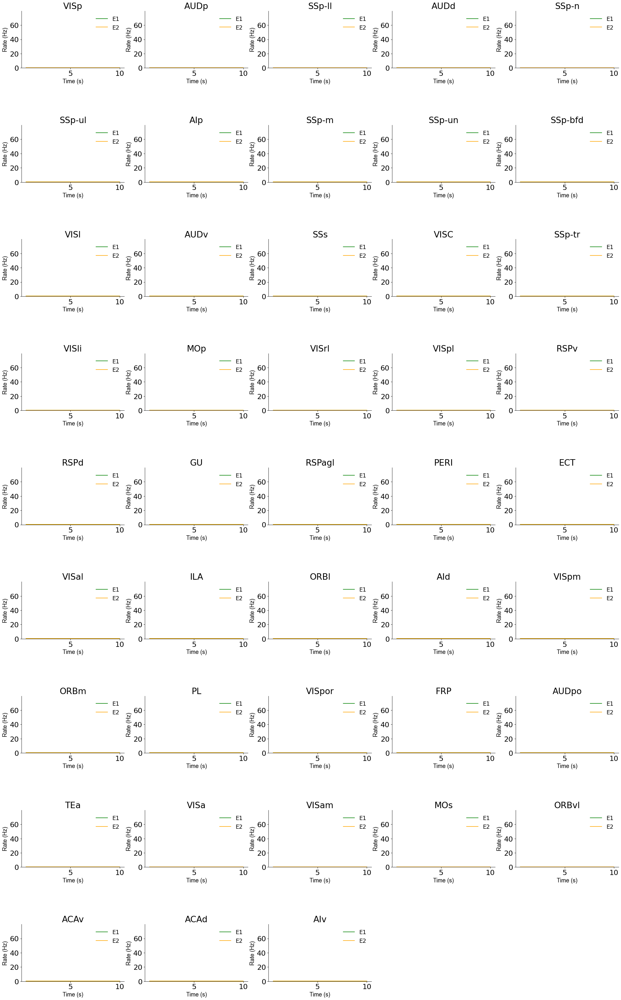

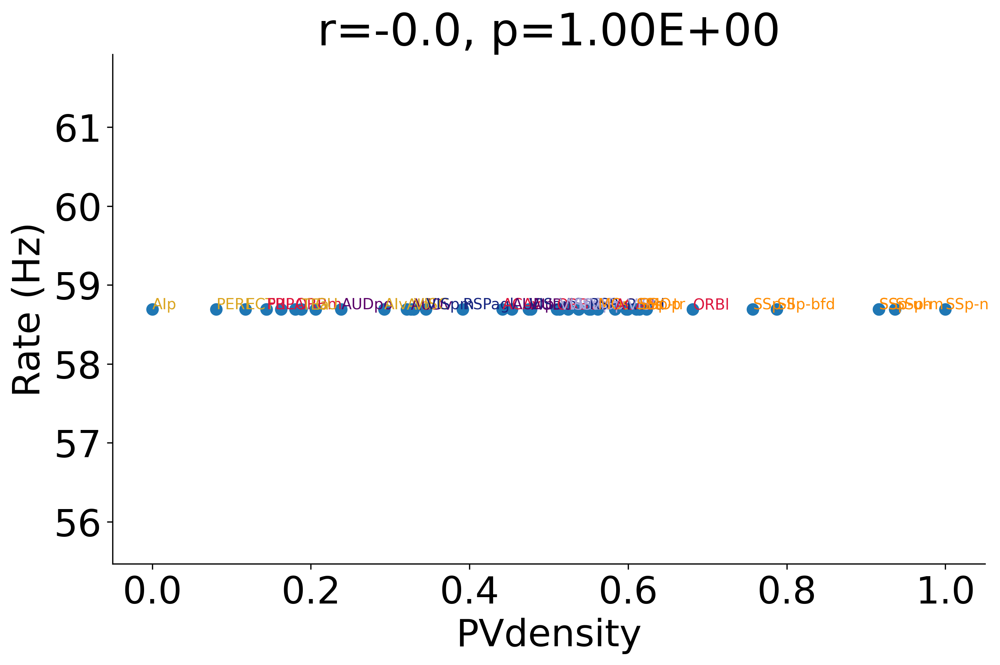

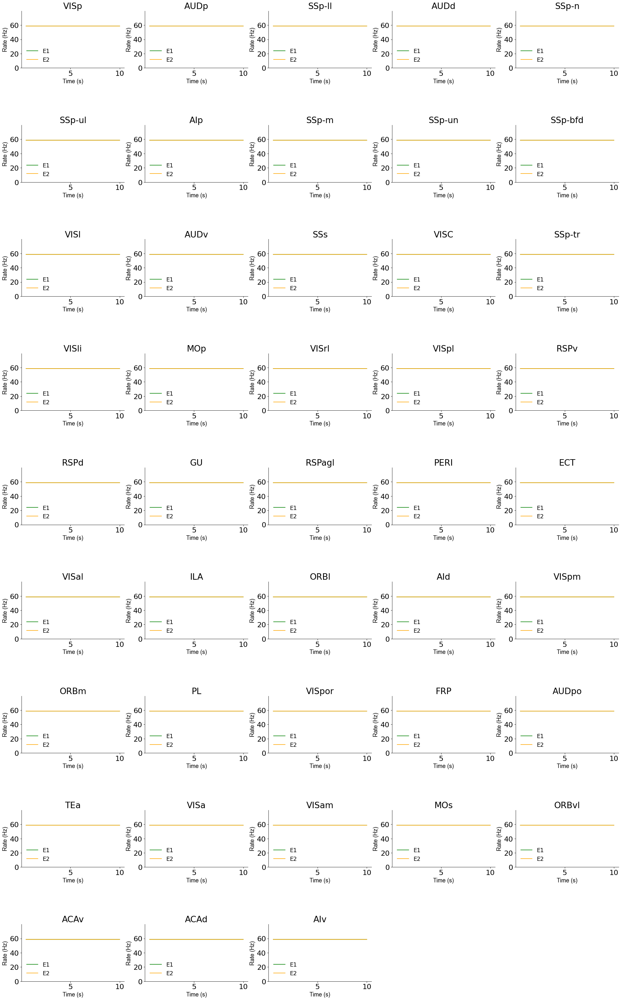

In [41]:
# test the no noise case to compare with the calculation results.
# with a higher gee value, aiming to make the local circuit an ISN.

# set simulation time to be 10s
parameters['trial_length'] = 10000 * brian2.ms # trial length (s)

parameters_noLR_zeronoise_ISN = copy.deepcopy(parameters)
parameters_noLR_zeronoise_ISN['g_E_self'] = 0.6 * brian2.nA   # 0.4 * brian2.nA
parameters_noLR_zeronoise_ISN['g_E_I'] =  0.5  * brian2.nA   # 0.192  * brian2.nA         # nA 
parameters_noLR_zeronoise_ISN['std_noise'] = 0 * brian2.nA
parameters_noLR_zeronoise_ISN['mu_EE'] = 0 * brian2.nA
parameters_noLR_zeronoise_ISN['mu_IE'] = 0 * brian2.nA
runBaselineSim(parameters_noLR_zeronoise_ISN, 'model_V1_noLR_zeronoise_ISN.pkl',True)

parameters_noLR_noInh_zeronoise_ISN = copy.deepcopy(parameters)
parameters_noLR_noInh_zeronoise_ISN['g_E_self'] = 0.6 * brian2.nA   # 0.4 * brian2.nA
parameters_noLR_noInh_zeronoise_ISN['g_E_I'] =  0.5  * brian2.nA   # 0.192  * brian2.nA         # nA 
parameters_noLR_noInh_zeronoise_ISN['std_noise'] = 0 * brian2.nA
parameters_noLR_noInh_zeronoise_ISN['mu_EE'] = 0 * brian2.nA
parameters_noLR_noInh_zeronoise_ISN['mu_IE'] = 0 * brian2.nA
parameters_noLR_noInh_zeronoise_ISN['g_E_I'] = 0 * brian2.nA
runBaselineSim(parameters_noLR_noInh_zeronoise_ISN, 'model_V1_noLR_noInh_zeronoise_ISN.pkl',True)

# check the sNMDA value.

VISp
simulation start: 
sim done.
2.96E-34
VISp
simulation start: 
sim done.
3.86E-01


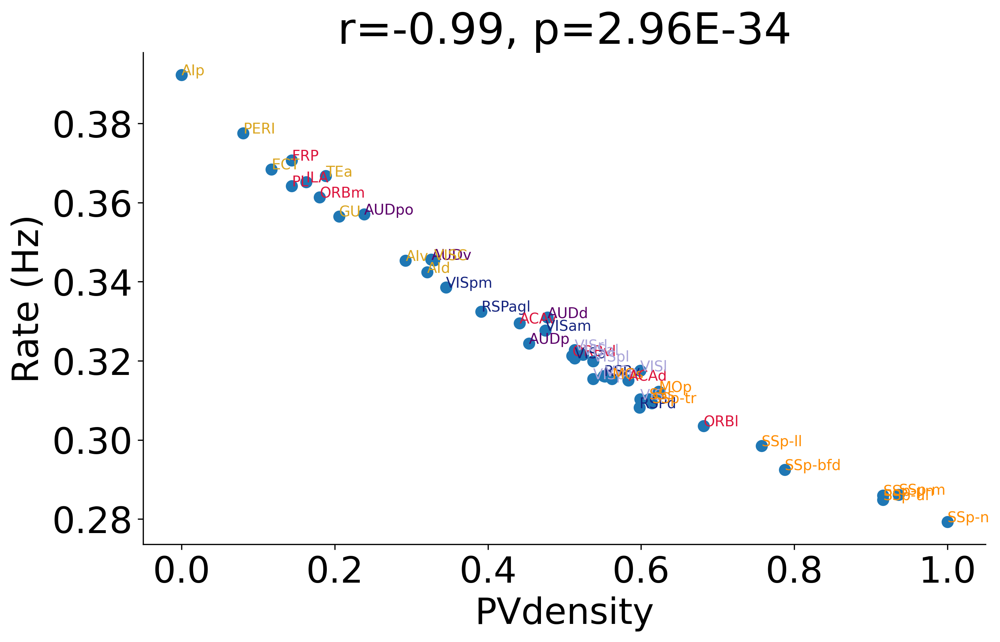

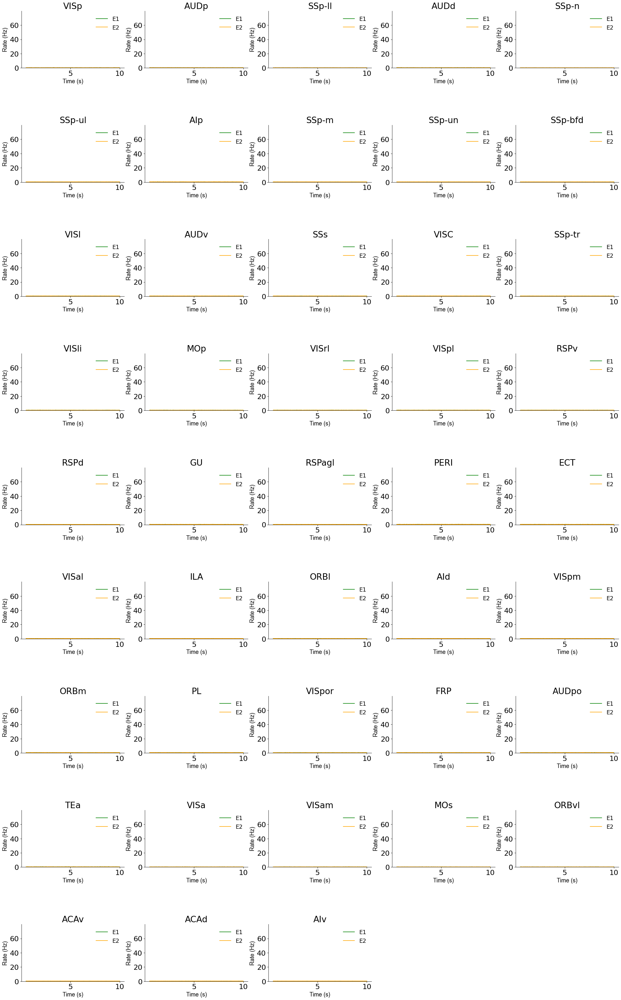

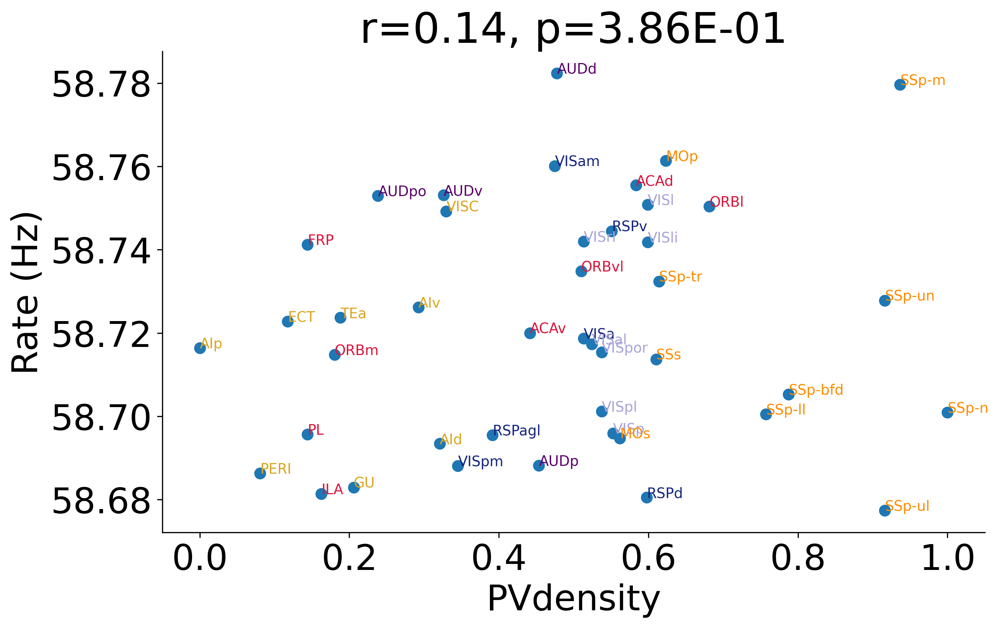

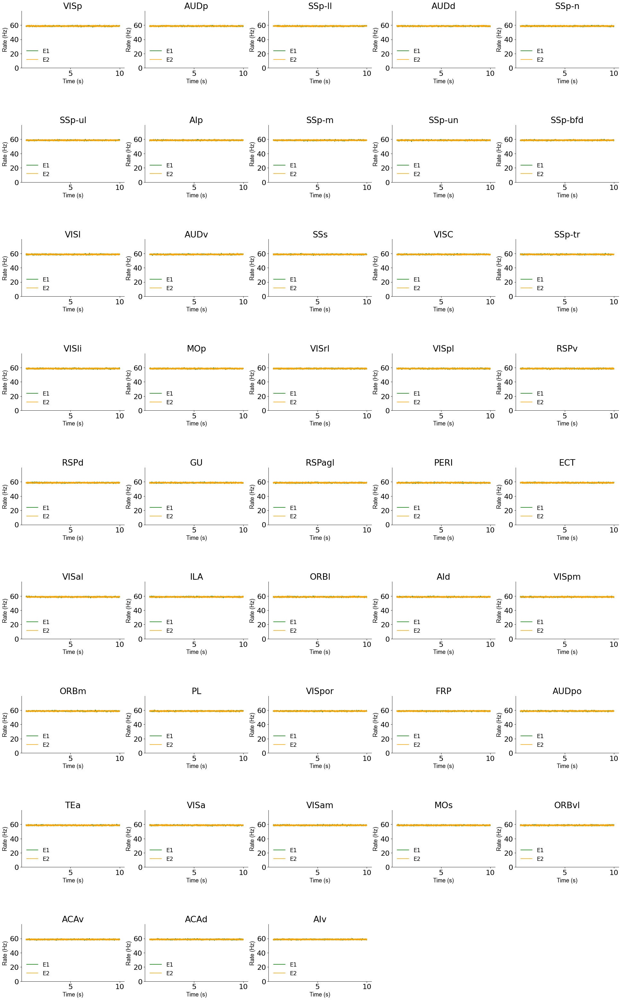

In [42]:
# with a higher gee value, aiming to make the local circuit an ISN.

# set simulation time to be 10s
parameters['trial_length'] = 10000 * brian2.ms # trial length (s)

parameters_noLR_ISN = copy.deepcopy(parameters)
parameters_noLR_ISN['g_E_self'] = 0.6 * brian2.nA   # 0.4 * brian2.nA
parameters_noLR_ISN['g_E_I'] =  0.5  * brian2.nA   # 0.192  * brian2.nA         # nA
parameters_noLR_ISN['mu_EE'] = 0 * brian2.nA
parameters_noLR_ISN['mu_IE'] = 0 * brian2.nA
runBaselineSim(parameters_noLR_ISN, 'model_V1_noLR_ISN.pkl',True)

parameters_noLR_noInh_ISN = copy.deepcopy(parameters)
parameters_noLR_noInh_ISN['g_E_self'] = 0.6 * brian2.nA   # 0.4 * brian2.nA
parameters_noLR_noInh_ISN['g_E_I'] =  0.5  * brian2.nA   # 0.192  * brian2.nA         # nA
parameters_noLR_noInh_ISN['mu_EE'] = 0 * brian2.nA
parameters_noLR_noInh_ISN['mu_IE'] = 0 * brian2.nA
parameters_noLR_noInh_ISN['g_E_I'] = 0 * brian2.nA
runBaselineSim(parameters_noLR_noInh_ISN, 'model_V1_noLR_noInh_ISN.pkl',True)


VISp
AUDp
SSp-ll
AUDd
SSp-n
SSp-ul
AIp
SSp-m
SSp-un
SSp-bfd
VISl
AUDv
SSs
VISC
SSp-tr
VISli
MOp
VISrl
VISpl
RSPv
RSPd
GU
RSPagl
PERI
ECT
VISal
ILA
ORBl
AId
VISpm
ORBm
PL
VISpor
FRP
AUDpo
TEa
VISa
VISam
MOs
ORBvl
ACAv
ACAd
AIv
simulation start: 
sim done.
1.04E-15


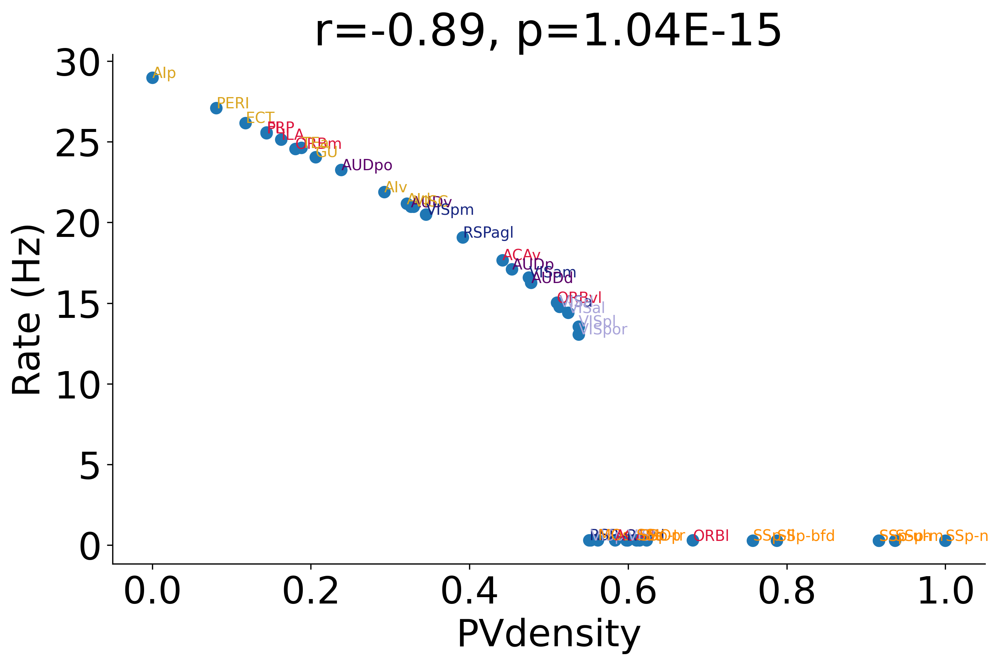

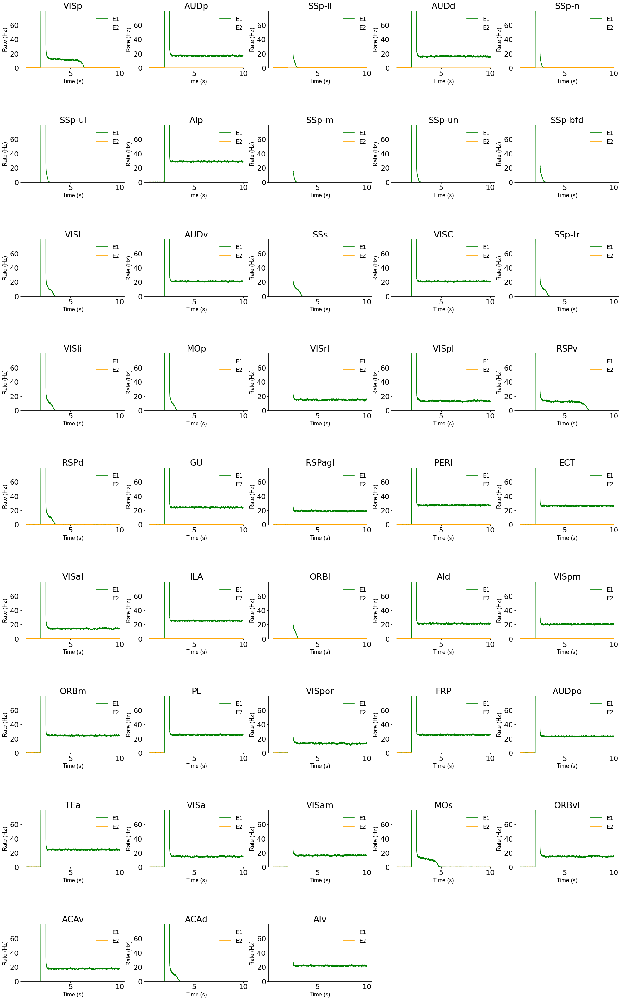

In [43]:
#  test if local areas are bistable under the ISN parameter regime.
makeQuickPlot = True

parameters_noLR_ISN_bistable = copy.deepcopy(parameters)
parameters_noLR_ISN_bistable['trial_length'] = 10 * brian2.second
parameters_noLR_ISN_bistable['g_E_self'] = 0.6 * brian2.nA   # 0.4 * brian2.nA
parameters_noLR_ISN_bistable['g_E_I'] =  0.5  * brian2.nA   # 0.192  * brian2.nA         # nA 

parameters_noLR_ISN_bistable['mu_EE'] = 0 * brian2.nA
parameters_noLR_ISN_bistable['mu_IE'] = 0 * brian2.nA

# inhibitory parameters
# parameters['J_G_EI_min'] = 1   # 0.6 # fixed to be 1 
# parameters['JEI_scaling_factor'] = 0.83  # 0.5  # 0.6 gives a good example of senerio 2. 


# # run simulation 
np.random.seed(42) # 2 for decresed firing rate and 8 core areas
model_noLR_ISN_bistable = model(parameters_noLR_ISN_bistable, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
# model_noLR_ISN_bistable.add_input(0, ['VISp'], parameters_noLR_ISN_bistable['stim_on'], parameters_noLR_ISN_bistable['stim_off'], 'E1')
model_noLR_ISN_bistable.add_input(parameters_noLR_ISN_bistable['stim_strength'],area_list, parameters_noLR_ISN_bistable['stim_on'], parameters_noLR_ISN_bistable['stim_off'], 'E1')
model_noLR_ISN_bistable.run_sim(vocal_prompt = False)

[persistentactlist,baselineactlist,_,_] = model_noLR_ISN_bistable.save_delay_activity('tempdata/',False)
persistentact_df =  model_noLR_ISN_bistable.generatePAdf(PAthreshold)
if makeQuickPlot:
    model_noLR_ISN_bistable.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
    model_noLR_ISN_bistable.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')
with open('results/model_V1_noLR_ISN_bistable.pkl', 'wb') as f:
    pickle.dump(model_noLR_ISN_bistable, f)


VISp
AUDp
SSp-ll
AUDd
SSp-n
SSp-ul
AIp
SSp-m
SSp-un
SSp-bfd
VISl
AUDv
SSs
VISC
SSp-tr
VISli
MOp
VISrl
VISpl
RSPv
RSPd
GU
RSPagl
PERI
ECT
VISal
ILA
ORBl
AId
VISpm
ORBm
PL
VISpor
FRP
AUDpo
TEa
VISa
VISam
MOs
ORBvl
ACAv
ACAd
AIv
simulation start: 
sim done.
1.92E-32


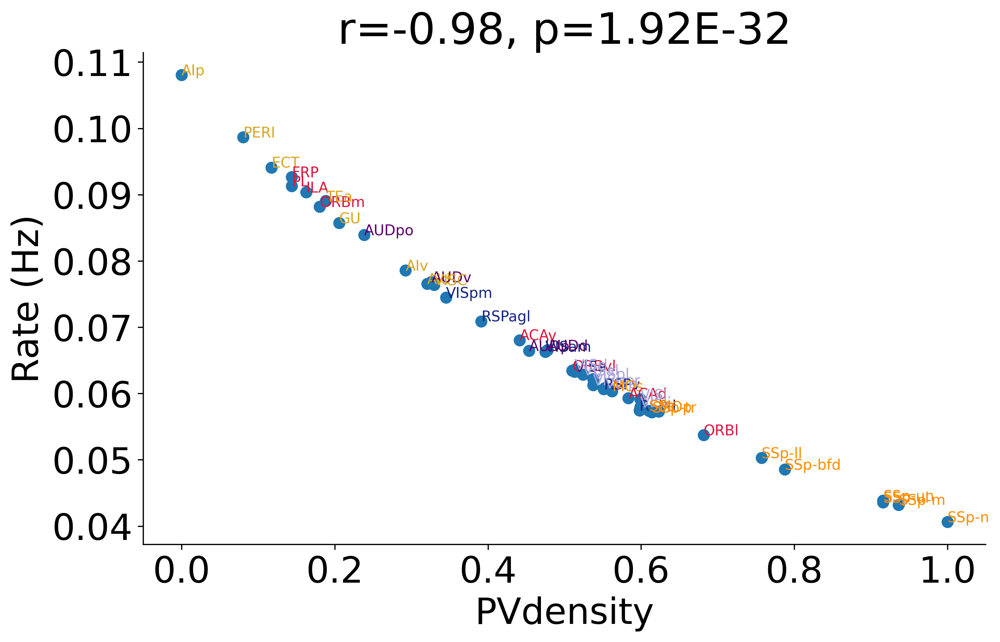

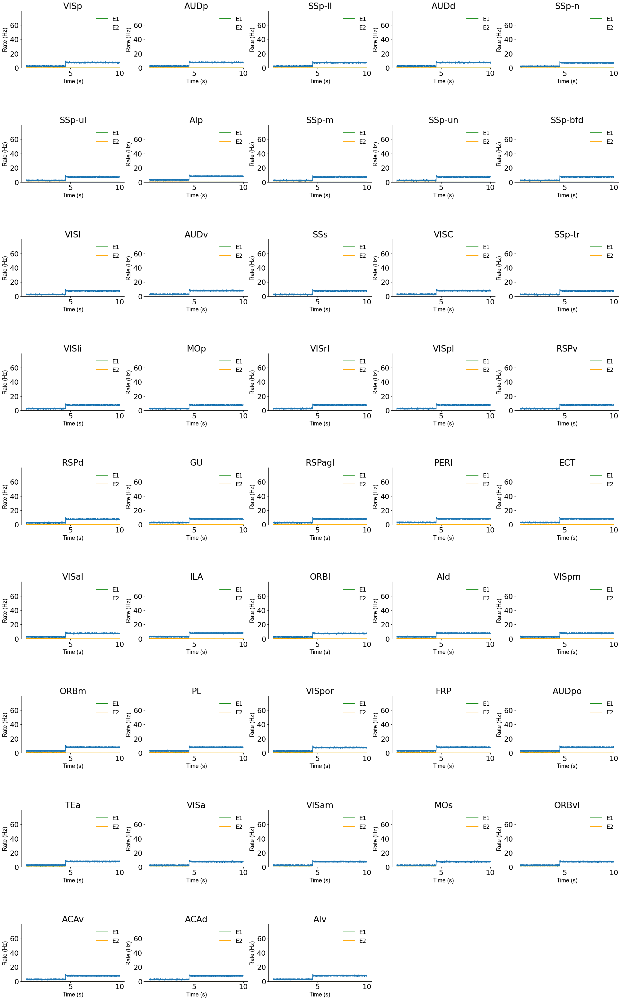

In [44]:
# test if the paradoxical response exist in the local ISN. 
#  test if local areas are bistable under the ISN parameter regime.

parameters_noLR_ISN_paradox = copy.deepcopy(parameters_noLR_ISN_bistable)

# inhibitory parameters
# parameters['J_G_EI_min'] = 1   # 0.6 # fixed to be 1 
# parameters['JEI_scaling_factor'] = 0.83  # 0.5  # 0.6 gives a good example of senerio 2. 


# # run simulation 
np.random.seed(42) # 2 for decresed firing rate and 8 core areas

model_noLR_ISN_paradox = model(parameters_noLR_ISN_paradox, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)

# model_noLR_ISN_paradox.add_input(parameters_noLR_ISN_paradox['stim_strength'],area_list, 
#                                  parameters_noLR_ISN_paradox['stim_on'], parameters_noLR_ISN_paradox['stim_off'], 'E1')
model_noLR_ISN_paradox.add_input(0.1 * parameters_noLR_ISN_paradox['stim_strength'],area_list, 
                                 parameters_noLR_ISN_paradox['stim_on'] + parameters_noLR_ISN_paradox['stim_off'], parameters_noLR_ISN_paradox['trial_length'], 'I')
model_noLR_ISN_paradox.run_sim(vocal_prompt = False)



[persistentactlist,baselineactlist,_,_] = model_noLR_ISN_paradox.save_delay_activity('tempdata/',False)
persistentact_df =  model_noLR_ISN_paradox.generatePAdf(PAthreshold)
persistentInhactlist = list(model_noLR_ISN_paradox.persistentInhactlist / brian2.Hz)
if makeQuickPlot:
    model_noLR_ISN_paradox.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
    model_noLR_ISN_paradox.plotFRallarea(plot_interneuron = True, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')
with open('results/model_V1_noLR_ISN_paradox.pkl', 'wb') as f:
    pickle.dump(model_noLR_ISN_paradox, f)




In [45]:
# test if the paradoxical response exist in the local ISN. 
# systematic change the input strength to inh neurons. focus on the fr of inh neurons and ex neurons. 
#  test if local areas are bistable under the ISN parameter regime.

parameters_noLR_ISN_paradox = copy.deepcopy(parameters_noLR_ISN_bistable)

inhInputStrength = np.arange(0, 0.3, 0.02)
persistentactMat = []
persistentInhactMat = []
for inhScale in inhInputStrength:
    # # run simulation 
    np.random.seed(42) # 2 for decresed firing rate and 8 core areas

    model_noLR_ISN_paradox = model(parameters_noLR_ISN_paradox, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)

    # model_noLR_ISN_paradox.add_input(parameters_noLR_ISN_paradox['stim_strength'],area_list, 
    #                                 parameters_noLR_ISN_paradox['stim_on'], parameters_noLR_ISN_paradox['stim_off'], 'E1')
    model_noLR_ISN_paradox.add_input(inhScale * parameters_noLR_ISN_paradox['stim_strength'],area_list, 
                                    parameters_noLR_ISN_paradox['stim_on'] + parameters_noLR_ISN_paradox['stim_off'], parameters_noLR_ISN_paradox['trial_length'], 'I')
    model_noLR_ISN_paradox.run_sim(vocal_prompt = False)

    [persistentactlist, baselineactlist, _, _] = model_noLR_ISN_paradox.save_delay_activity('tempdata/',False)
    persistentact_df =  model_noLR_ISN_paradox.generatePAdf(PAthreshold)
    persistentInhactlist = list(model_noLR_ISN_paradox.persistentInhactlist / brian2.Hz)
    persistentactMat.append(persistentactlist)
    persistentInhactMat.append(persistentInhactlist)
    # if makeQuickPlot:
    #     model_noLR_ISN_paradox.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
    #     model_noLR_ISN_paradox.plotFRallarea(plot_interneuron = True, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')
    # with open('results/model_V1_noLR_ISN_paradox.pkl', 'wb') as f:
    #     pickle.dump(model_noLR_ISN_paradox, f)

persistentactMat = np.array(persistentactMat)
persistentInhactMat = np.array(persistentInhactMat)


VISp
AUDp
SSp-ll
AUDd
SSp-n
SSp-ul
AIp
SSp-m
SSp-un
SSp-bfd
VISl
AUDv
SSs
VISC
SSp-tr
VISli
MOp
VISrl
VISpl
RSPv
RSPd
GU
RSPagl
PERI
ECT
VISal
ILA
ORBl
AId
VISpm
ORBm
PL
VISpor
FRP
AUDpo
TEa
VISa
VISam
MOs
ORBvl
ACAv
ACAd
AIv
simulation start: 
sim done.
VISp
AUDp
SSp-ll
AUDd
SSp-n
SSp-ul
AIp
SSp-m
SSp-un
SSp-bfd
VISl
AUDv
SSs
VISC
SSp-tr
VISli
MOp
VISrl
VISpl
RSPv
RSPd
GU
RSPagl
PERI
ECT
VISal
ILA
ORBl
AId
VISpm
ORBm
PL
VISpor
FRP
AUDpo
TEa
VISa
VISam
MOs
ORBvl
ACAv
ACAd
AIv
simulation start: 
sim done.
VISp
AUDp
SSp-ll
AUDd
SSp-n
SSp-ul
AIp
SSp-m
SSp-un
SSp-bfd
VISl
AUDv
SSs
VISC
SSp-tr
VISli
MOp
VISrl
VISpl
RSPv
RSPd
GU
RSPagl
PERI
ECT
VISal
ILA
ORBl
AId
VISpm
ORBm
PL
VISpor
FRP
AUDpo
TEa
VISa
VISam
MOs
ORBvl
ACAv
ACAd
AIv
simulation start: 
sim done.
VISp
AUDp
SSp-ll
AUDd
SSp-n
SSp-ul
AIp
SSp-m
SSp-un
SSp-bfd
VISl
AUDv
SSs
VISC
SSp-tr
VISli
MOp
VISrl
VISpl
RSPv
RSPd
GU
RSPagl
PERI
ECT
VISal
ILA
ORBl
AId
VISpm
ORBm
PL
VISpor
FRP
AUDpo
TEa
VISa
VISam
MOs
ORBvl
ACAv
ACAd
AIv
simulatio

In [46]:
def makeLinePlot(xx, yy, yRange, xlabel, ylabel, title, dotSize, figureSize, fontSize, saveFig, fileName):
    fig = plt.figure(figsize=figureSize, dpi=300, facecolor='w', edgecolor='k')
    plt.rcParams.update({'font.size': fontSize})
    plt.plot(xx, yy, 'o-', markersize=dotSize)
    ax = plt.gca()
    if yRange:
        plt.ylim(yRange) # leave enough space for annotation.
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    # save figure
    if saveFig:
        plt.savefig('figure/' + fileName, dpi=300, bbox_inches='tight',transparent=True)

31


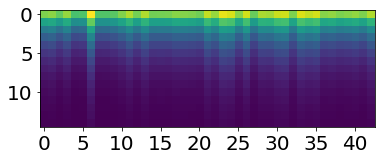

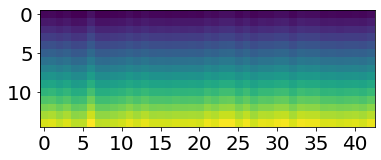

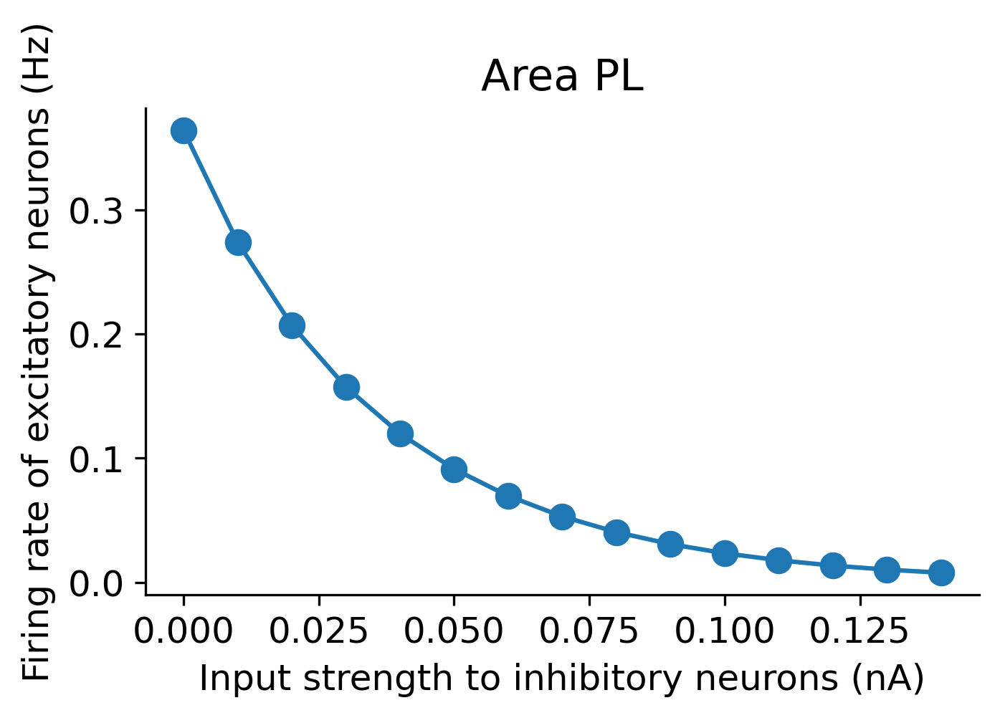

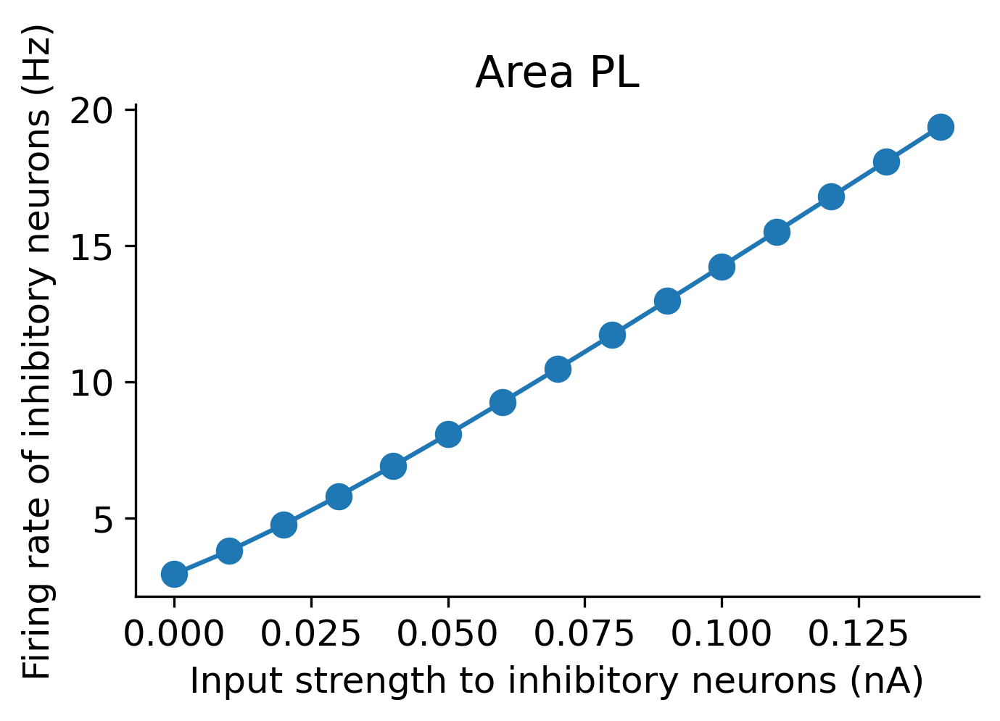

In [47]:
# plot the paradoxical response of area PL. 
plt.imshow(persistentactMat)
plt.figure()
plt.imshow(persistentInhactMat)
targetArea = area_list.index('PL')
print(targetArea)

makeLinePlot(inhInputStrength * parameters_noLR_ISN_paradox['stim_strength'] / brian2.nA,
              persistentactMat[:, targetArea], None, 'Input strength to inhibitory neurons (nA)',
                'Firing rate of excitatory neurons (Hz)',
                  "Area " + area_list[targetArea], 8, (5,3), 12, False, 
                  'ISN/paradox_noLR_ISN_' + area_list[targetArea] +'_ex.pdf')

makeLinePlot(inhInputStrength * parameters_noLR_ISN_paradox['stim_strength'] / brian2.nA,
              persistentInhactMat[:, targetArea], None, 'Input strength to inhibitory neurons (nA)',
                'Firing rate of inhibitory neurons (Hz)',
                  "Area " + area_list[targetArea], 8, (5,3), 12, False, 
                  'ISN/paradox_noLR_ISN_' + area_list[targetArea] +'_ex.pdf')

9


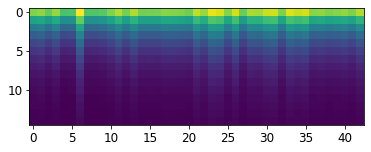

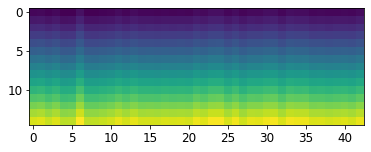

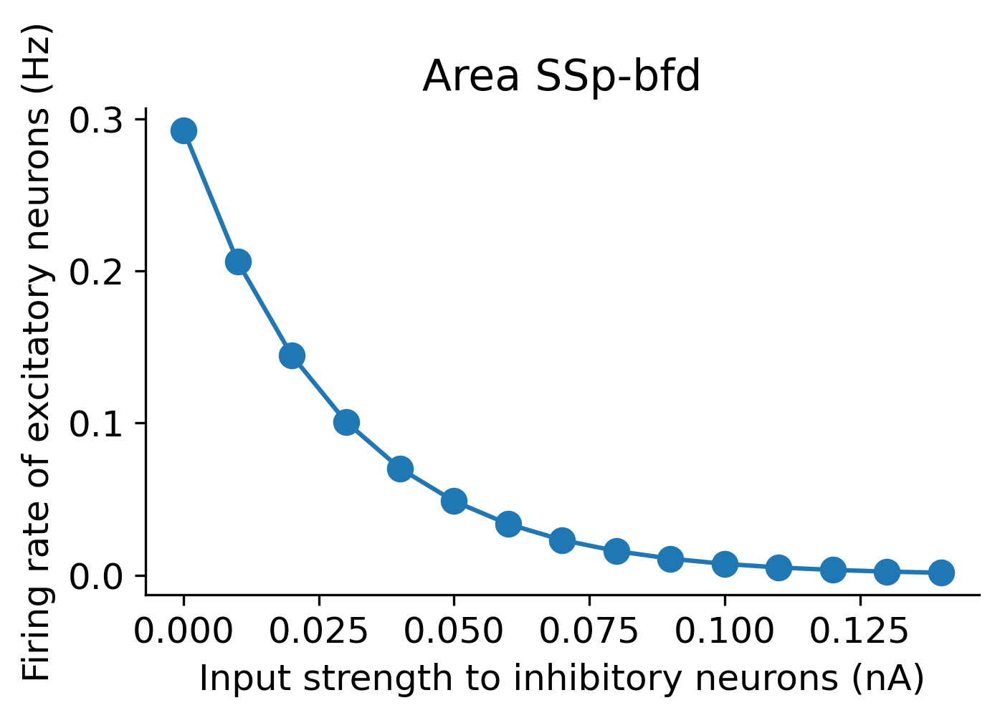

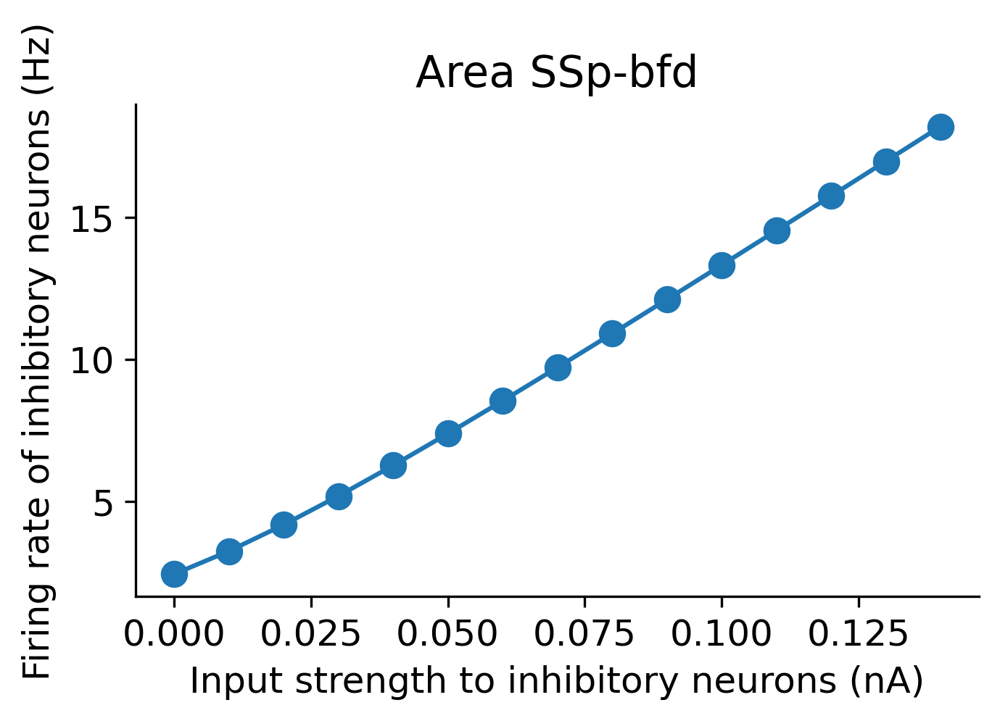

In [48]:
# plot the paradoxical response of area SSp-bfd. 
plt.imshow(persistentactMat)
plt.figure()
plt.imshow(persistentInhactMat)
targetArea = area_list.index('SSp-bfd')

print(targetArea)

makeLinePlot(inhInputStrength * parameters_noLR_ISN_paradox['stim_strength'] / brian2.nA,
              persistentactMat[:, targetArea], None, 'Input strength to inhibitory neurons (nA)',
                'Firing rate of excitatory neurons (Hz)',
                  "Area " + area_list[targetArea], 8, (5,3), 12, False, 
                  'ISN/paradox_noLR_ISN_' + area_list[targetArea] +'_ex.pdf')

makeLinePlot(inhInputStrength * parameters_noLR_ISN_paradox['stim_strength'] / brian2.nA,
              persistentInhactMat[:, targetArea], None, 'Input strength to inhibitory neurons (nA)',
                'Firing rate of inhibitory neurons (Hz)',
                  "Area " + area_list[targetArea], 8, (5,3), 12, False, 
                  'ISN/paradox_noLR_ISN_' + area_list[targetArea] +'_ex.pdf')

VISp
simulation start: 
sim done.
1.29E-04
VISp
simulation start: 
sim done.
4.51E-01
VISp
simulation start: 
sim done.
9.08E-02


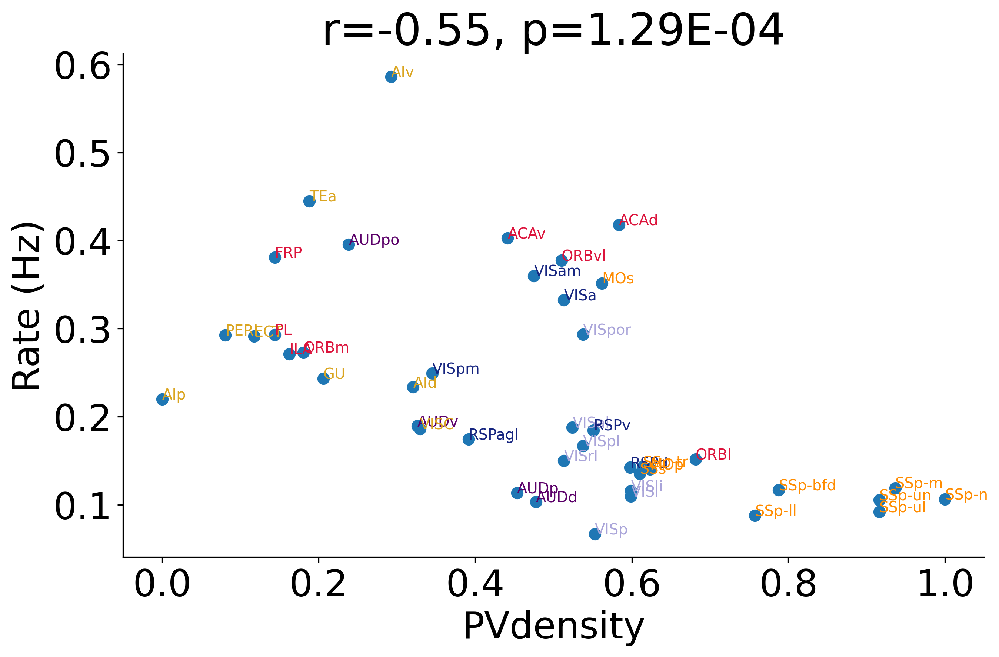

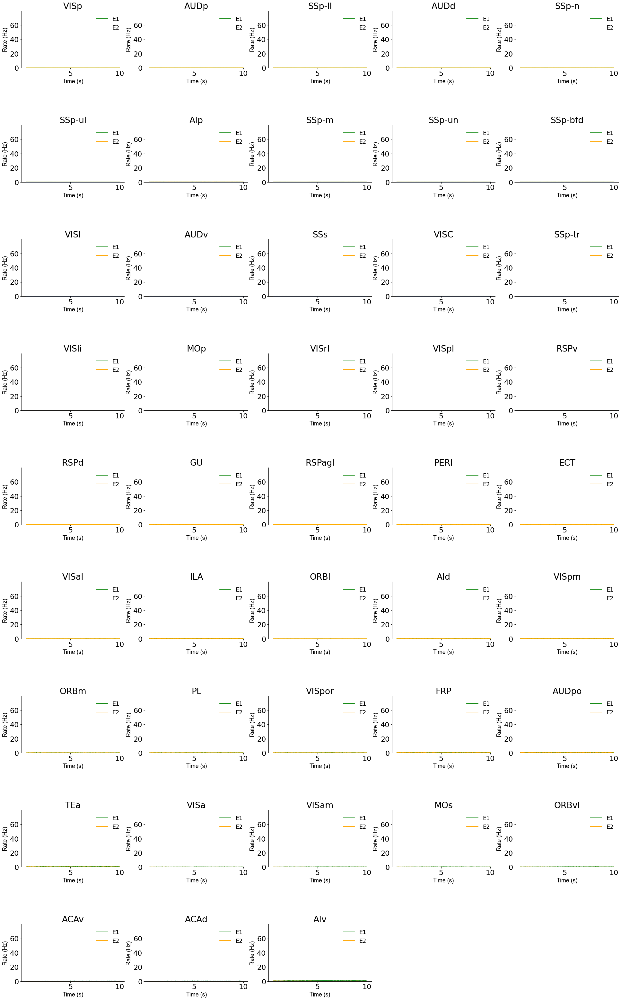

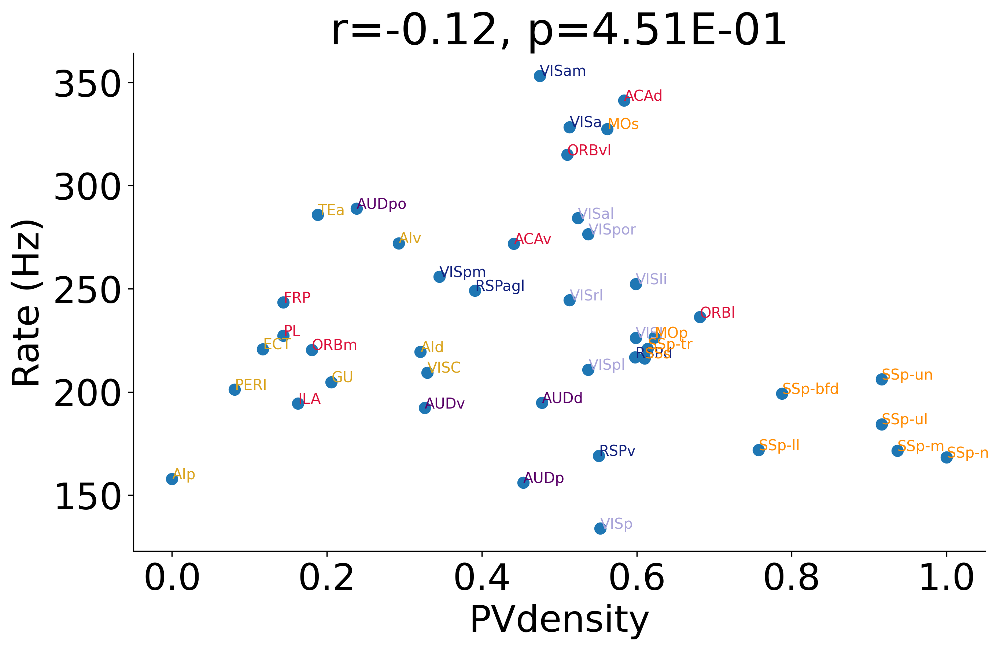

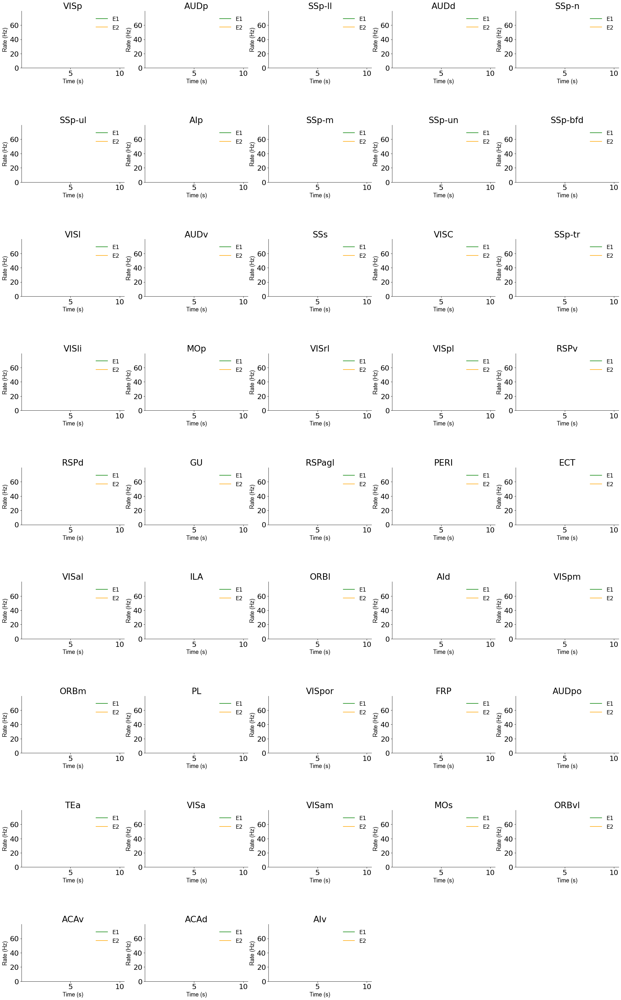

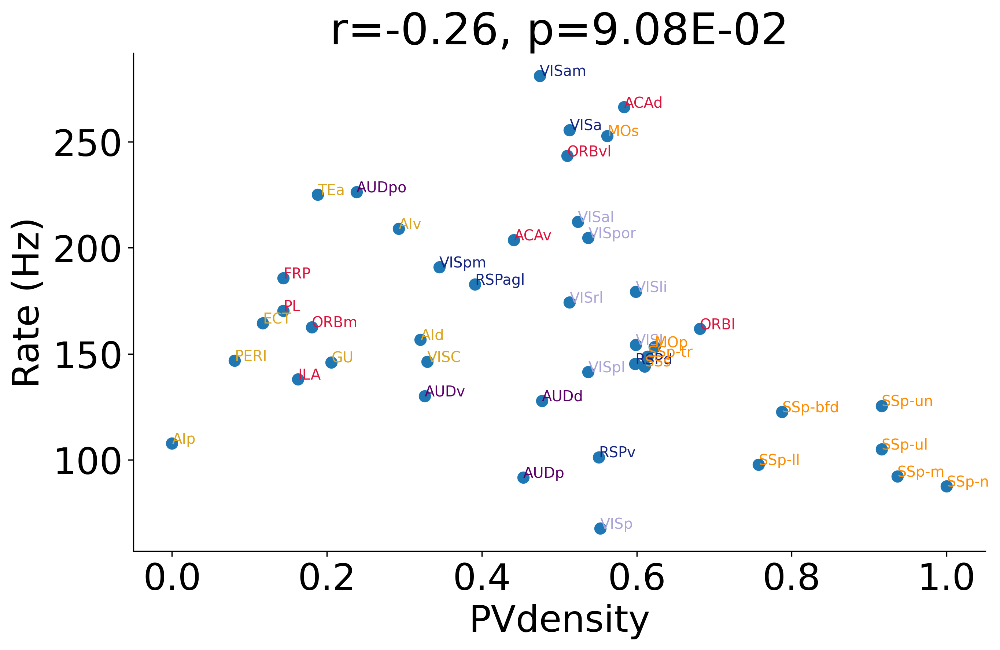

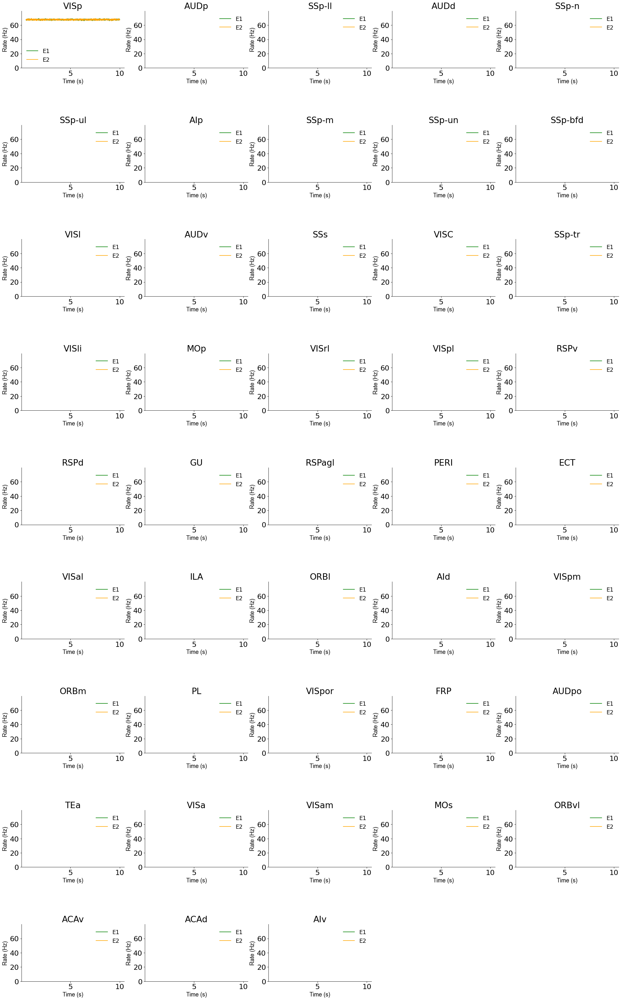

In [49]:
# test a large scale network parameter regime with local ISN.

# with a higher gee value, aiming to make the local circuit an ISN.

parameters_LR_ISN = copy.deepcopy(parameters)
parameters_LR_ISN['g_E_self'] = 0.6 * brian2.nA   # 0.4 * brian2.nA
parameters_LR_ISN['g_E_I'] =  0.5  * brian2.nA   # 0.192  * brian2.nA         # nA 
# parameters_LR_ISN['trial_length'] = 30* brian2.second
parameters_LR_ISN['mu_EE'] = 0.1 * 1.9  * brian2.nA     #0.06*1.8 cortical #0.025*1.8  # 0.015*1.8  #0.058*1.8 thal  # 0.065*1.8 PV only   # 0.06*1.8 PV only is really good! 
parameters_LR_ISN['ratio_mu_IE_mu_EE'] =  1.67 / 1.9    # 3/1.8
parameters_LR_ISN.update({'mu_IE': parameters_LR_ISN['mu_EE'] * parameters_LR_ISN['ratio_mu_IE_mu_EE']})
runBaselineSim(parameters_LR_ISN, 'model_V1_LR_ISN.pkl',True)



parameters_LR_ISN_nolocalInh = copy.deepcopy(parameters)
parameters_LR_ISN_nolocalInh['g_E_self'] = 0.6 * brian2.nA   # 0.4 * brian2.nA
parameters_LR_ISN_nolocalInh['g_E_I'] =  0  * brian2.nA   # 0.192  * brian2.nA         # nA 

parameters_LR_ISN_nolocalInh['mu_EE'] = 0.1 * 1.9  * brian2.nA     #0.06*1.8 cortical #0.025*1.8  # 0.015*1.8  #0.058*1.8 thal  # 0.065*1.8 PV only   # 0.06*1.8 PV only is really good! 
parameters_LR_ISN_nolocalInh['ratio_mu_IE_mu_EE'] =  1.67 / 1.9    # 3/1.8
parameters_LR_ISN_nolocalInh.update({'mu_IE': parameters_LR_ISN_nolocalInh['mu_EE'] * parameters_LR_ISN_nolocalInh['ratio_mu_IE_mu_EE']})
runBaselineSim(parameters_LR_ISN_nolocalInh, 'model_V1_LR_ISN_nolocalInh.pkl',True)


parameters_LR_ISN_noLRInh = copy.deepcopy(parameters)
parameters_LR_ISN_noLRInh['g_E_self'] = 0.6 * brian2.nA   # 0.4 * brian2.nA
parameters_LR_ISN_noLRInh['g_E_I'] =  0.5  * brian2.nA   # 0.192  * brian2.nA         # nA

parameters_LR_ISN_noLRInh['mu_EE'] = 0.1 * 1.9  * brian2.nA     #0.06*1.8 cortical #0.025*1.8  # 0.015*1.8  #0.058*1.8 thal  # 0.065*1.8 PV only   # 0.06*1.8 PV only is really good! 
parameters_LR_ISN_noLRInh['ratio_mu_IE_mu_EE'] =  1.67 / 1.9    # 3/1.8
parameters_LR_ISN_noLRInh.update({'mu_IE': parameters_LR_ISN_noLRInh['mu_EE'] * parameters_LR_ISN_noLRInh['ratio_mu_IE_mu_EE']})

parameters_LR_ISN_noLRInh['mu_IE'] = 0 * brian2.nA

runBaselineSim(parameters_LR_ISN_noLRInh, 'model_V1_LR_ISN_noLRInh.pkl', True)



VISp
simulation start: 
sim done.
2.25E-11
1.77E-01


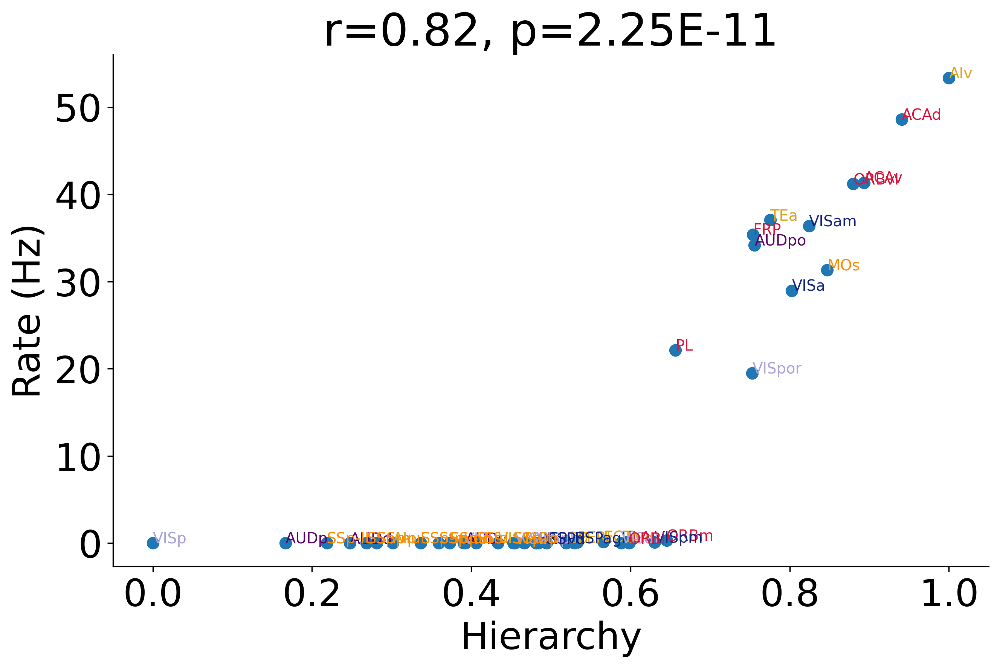

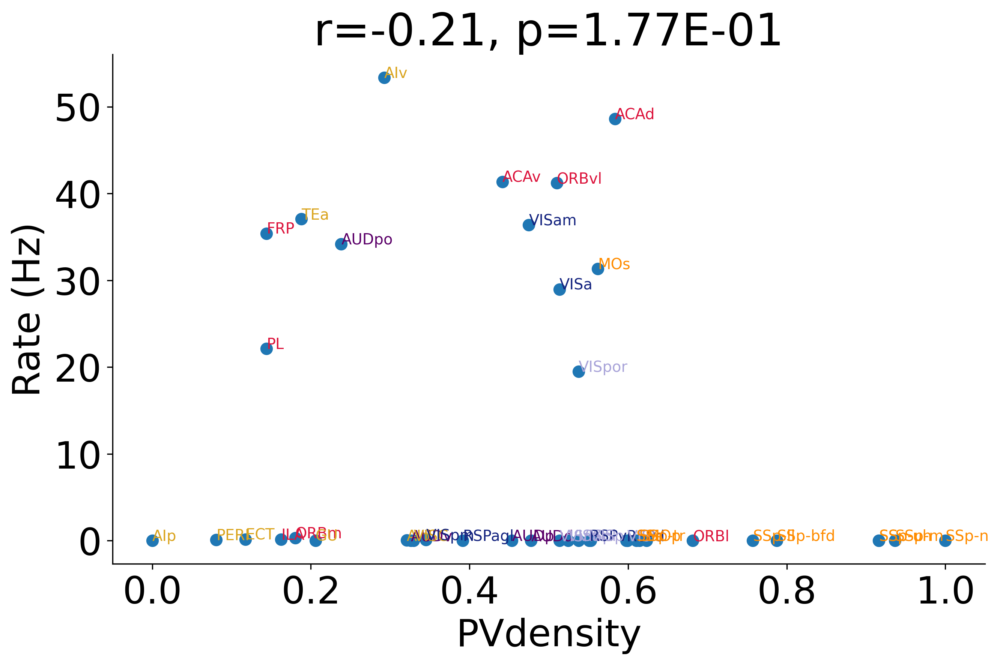

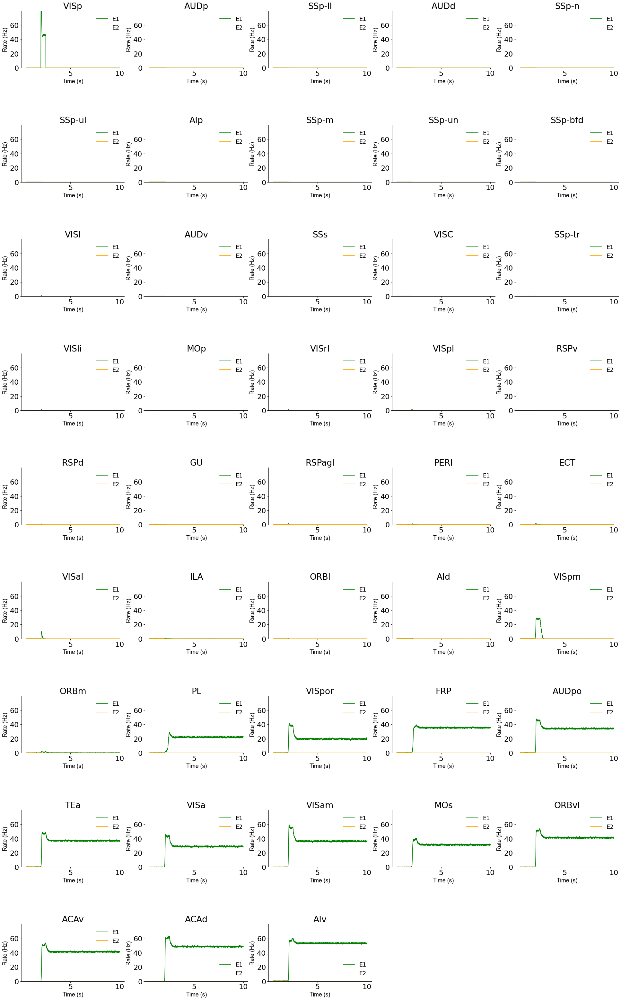

In [50]:
# test a standard large scale network parameter pipeline with local ISN.

parameters_ISN = copy.deepcopy(parameters)
parameters_ISN['g_E_self'] = 0.6 * brian2.nA   # 0.4 * brian2.nA
parameters_ISN['g_E_I'] =  0.5  * brian2.nA   # 0.192  * brian2.nA         # nA 

# 0.1 original working parameter
parameters_ISN['mu_EE'] = 0.1 * 1.9  * brian2.nA     #0.06*1.8 cortical #0.025*1.8  # 0.015*1.8  #0.058*1.8 thal  # 0.065*1.8 PV only   # 0.06*1.8 PV only is really good! 
parameters_ISN['ratio_mu_IE_mu_EE'] =  1.67 / 1.9    # 3/1.8
parameters_ISN.update({'mu_IE': parameters_ISN['mu_EE'] * parameters_ISN['ratio_mu_IE_mu_EE']})


# # run simulation 
np.random.seed(42) # 2 for decresed firing rate and 8 core areas
model_V1_ISN = model(parameters_ISN, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)
# model_noLR_ISN_bistable.add_input(0, ['VISp'], parameters_ISN['stim_on'], parameters_ISN['stim_off'], 'E1')
model_V1_ISN.add_input(parameters_ISN['stim_strength'],['VISp'], parameters_ISN['stim_on'], parameters_ISN['stim_off'], 'E1')
model_V1_ISN.run_sim(vocal_prompt = False)

[persistentactlist,baselineactlist,_,_] = model_V1_ISN.save_delay_activity('tempdata/',False)
persistentact_df =  model_V1_ISN.generatePAdf(PAthreshold)
if makeQuickPlot:
    model_V1_ISN.plotFRvsHier(False, True, 2, (10,6), 24, False, 'FRvsHier.pdf')
    model_V1_ISN.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
    model_V1_ISN.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')
with open('results/model_V1_ISN.pkl', 'wb') as f:
    pickle.dump(model_V1_ISN, f)

VISp
simulation start: 
sim done.
1.00E+00


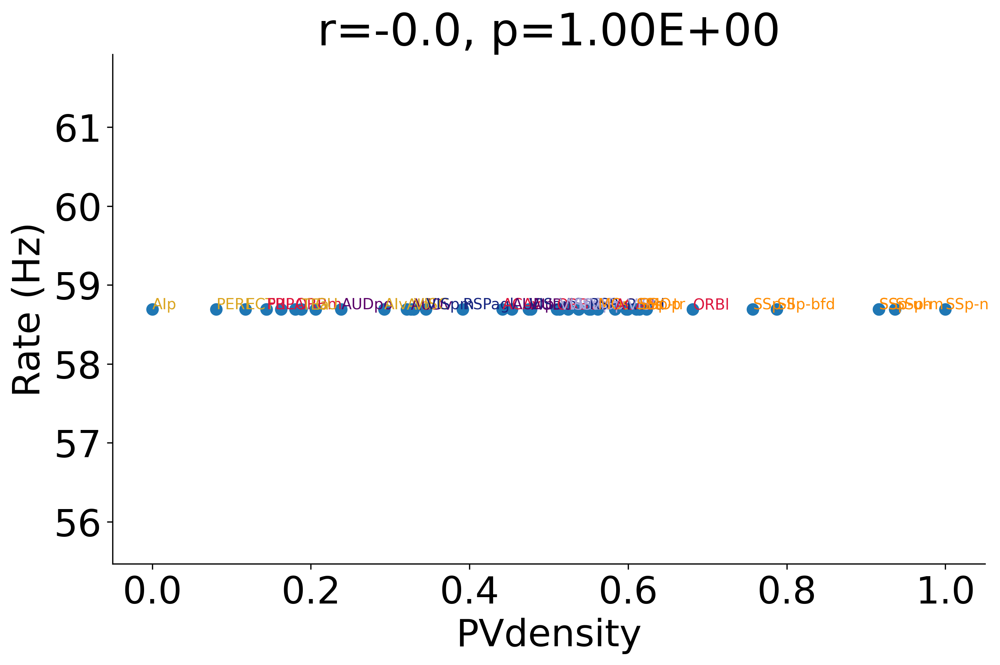

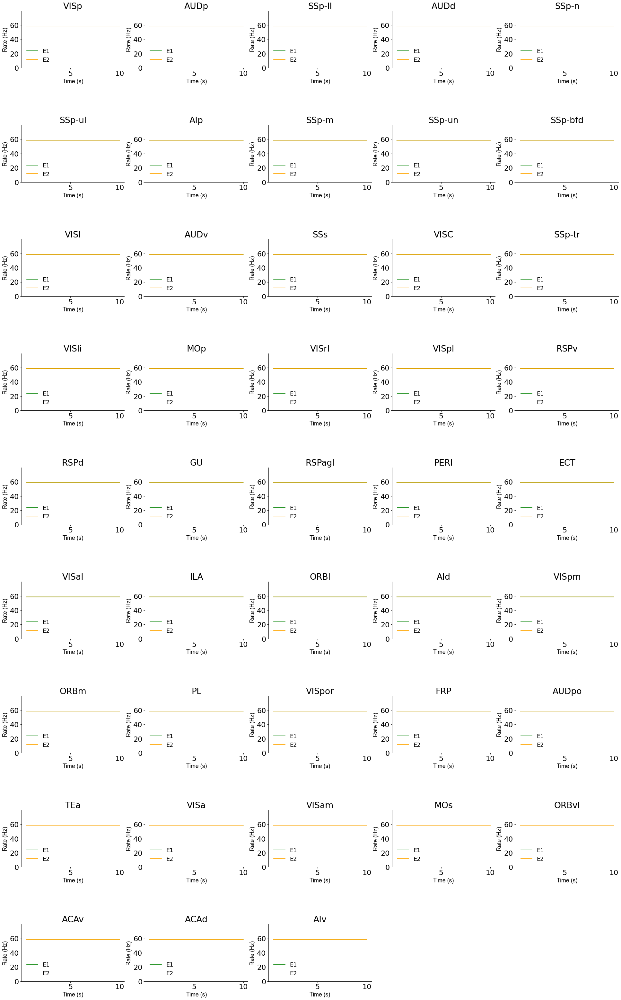

In [51]:
# test the no noise case to compare with the calculation results. 
# with a higher gee value, aiming to make the local circuit an ISN. 
# simulate the local circuit but with higher gee value, and test if the low firing rate baseline is stable.
# we set the baseline synaptic variable to the calculated value. 

# The saStar is 0.04302990159610465
# The sbStar is 0.04302990159610465
# The scStar is 0.040805795603784695

# parameters_noLR_noInh_zeronoise_ISN
makeQuickPlot = True
np.random.seed(42) # 2 for decresed firing rate and 8 core areas

# modify the initial firing rates to zeros.
# parameters_noLR_noInh_zeronoise_ISN['r0_E'] = 0* brian2.Hz
# parameters_noLR_noInh_zeronoise_ISN['r0_I'] = 0* brian2.Hz

# modify the initial firing rates to the calculated values.
parameters_noLR_noInh_zeronoise_ISN['r0_E'] = 0.805856339456012 * brian2.Hz
parameters_noLR_noInh_zeronoise_ISN['r0_I'] = 4.08057956037847 * brian2.Hz

m1 = model(parameters_noLR_noInh_zeronoise_ISN, False, conn_cxcx, pref_matrix, hierarchy_df, normPVgrad_df, normSSTgrad_df, area_list, thcxmodel, conn_thcx, conn_cxth, thal_list)

# modify the initial synaptic variables t
# o the calculated values.
m1.S_NMDA[0, :, :] = 0.04302990159610465 * np.concatenate((np.ones((m1.num_areas, 2)), 
                                   np.zeros((m1.num_areas, m1.num_pops - 2))),axis=1)
m1.S_GABA[0, :, :] = 0.040805795603784695 * np.concatenate((np.zeros((m1.num_areas, 2)), 
                                 np.ones((m1.num_areas, m1.num_pops - 2))),axis=1)

m1.add_input(0,['VISp'], parameters['stim_on'], parameters['stim_off'], 'E1')
m1.run_sim(vocal_prompt = False)

[persistentactlist,baselineactlist,_,_] = m1.save_delay_activity('tempdata/',False)
persistentact_df =  m1.generatePAdf(PAthreshold)
if makeQuickPlot:
    m1.plotFRvsPV(False, True, 2, (10,6), 24, False, 'FRvsPV.pdf')
    m1.plotFRallarea(plot_interneuron = False, ylimit = 80, savefig = savefigflag, figfilename = 'FRallcortex.pdf')
with open('results/model_V1_noLR_noInh_zeronoise_ISN.pkl', 'wb') as f:
    pickle.dump(m1, f)



In [52]:
# print(m1.parameters['r0_E'])
# print(m1.parameters['r0_I'])

# # print(m1.S_NMDA0[:10])
# # print(m1.S_GABA0[:10])

0.80585634 Hz
0.80585634 Hz
4.08057956 Hz
0.04302990159610465
0.04302990159610465
0.040805795603784695


(-0.01, 0.1)

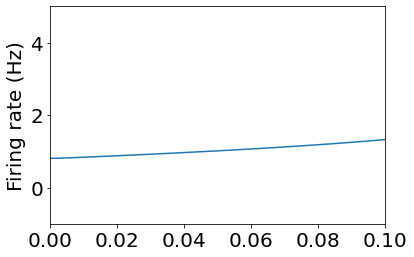

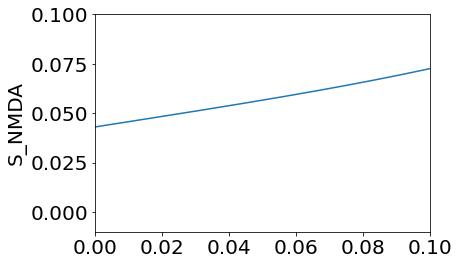

In [53]:
k = 0 # ROI

print(m1.R[0, k, 0])
print(m1.R[0, k, 1])
print(m1.R[0, k, 2])
print(m1.S_NMDA[0, k, 0])
print(m1.S_NMDA[0, k, 1])
print(m1.S_GABA[0, k, 2])
# print(m1.R0)
# print(m1.S_NMDA0)
# print(m1.S_GABA0)
# m1.R0vec = np.array([parameters['r0_E'], parameters['r0_E'], parameters['r0_I']])# TODO changes happen
# m1.R0 = np.matlib.repmat(self.R0vec, self.num_areas, 1) * brian2.Hz
# m1.S_NMDA0 = 0 * np.concatenate((np.ones((self.num_areas, 2)), np.zeros((self.num_areas, self.num_pops - 2))),
#                                     axis=1)
# m1.S_GABA0 = 0 * np.concatenate((np.zeros((self.num_areas, 2)), np.ones((self.num_areas, self.num_pops - 2))),
#                                     axis=1)
plt.figure()
plt.plot(np.arange(0 * brian2.second, 1 * brian2.second, m1.dt),
          m1.R[np.arange(int(0 * brian2.second / m1.dt), int(1 * brian2.second / m1.dt), 1), k, 0]/brian2.Hz,
            label='E1')
plt.ylabel('Firing rate (Hz)')
plt.xlim([0, 0.1])
plt.ylim([-1, 5])
plt.figure()
plt.plot(np.arange(0 * brian2.second, 1 * brian2.second, m1.dt),
          m1.S_NMDA[np.arange(int(0 * brian2.second / m1.dt), int(1 * brian2.second / m1.dt), 1), k, 1]/brian2.Hz,
            label='S_NMDA')
plt.ylabel('S_NMDA')
plt.xlim([0, 0.1])
plt.ylim([-0.01, 0.1])
# plt.plot(np.arange(start_time * brian2.second, end_time * brian2.second, self.dt),
#                      self.R[np.arange(int(start_time / self.dt), int(end_time / self.dt), 1), i - 1, 0],
#                      color='green')